## CIS 580, Machine Perception, Spring 2023
### Homework 5
#### Due: Thursday April 27th 2023, 11:59pm ET

Instructions: Create a folder in your Google Drive and place inside this .ipynb file. Open the jupyter notebook with Google Colab. Refrain from using a GPU during implementing and testing the whole thing. You should switch to a GPU runtime only when performing the final training (of the 2D image or the NeRF) to avoid GPU usage runouts. 

### Part 1: Fitting a 2D Image

In [38]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


We first download the image from the web. We normalize the image so the pixels are in between the range of [0,1].

In [39]:
url = "https://drive.google.com/file/d/1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT/view?usp=share_link"
gdown.download(url=url, output='starry_night.jpg', quiet=False, fuzzy=True)

# Load painting image
painting = imageio.imread("starry_night.jpg")
painting = torch.from_numpy(np.array(painting, dtype=np.float32)/255.).to(device)
height_painting, width_painting = painting.shape[:2]

Downloading...
From: https://drive.google.com/uc?id=1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT
To: /content/starry_night.jpg
100%|██████████| 5.65k/5.65k [00:00<00:00, 18.7MB/s]


1.1 Complete the function positional_encoding()

In [41]:
def positional_encoding(x, num_frequencies=6, incl_input=True):
    
    """
    Apply positional encoding to the input.
    
    Args:
    x (torch.Tensor): Input tensor to be positionally encoded. 
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the 
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor. 
    """
    
    results = []
    if incl_input:
        results.append(x)
    #############################  TODO 1(a) BEGIN  ############################
    # encode input tensor and append the encoded tensor to the list of results.
    
    for i in range(num_frequencies):
        for fn in [torch.sin, torch.cos]:
            results.append(fn((2.0 ** i) * np.pi * x))
    


    #############################  TODO 1(a) END  ##############################
    return torch.cat(results, dim=-1)

1.2 Complete the class model_2d() that will be used to fit the 2D image.


In [42]:
class model_2d(nn.Module):
    
    """
    Define a 2D model comprising of three fully connected layers,
    two relu activations and one sigmoid activation.
    """
    
    def __init__(self, filter_size=128, num_frequencies=6):
        super().__init__()
        #############################  TODO 1(b) BEGIN  ############################
        self.fc1 = nn.Linear(2 * (1 + num_frequencies * 2), filter_size)
        self.fc2 = nn.Linear(filter_size, filter_size)
        self.fc3 = nn.Linear(filter_size, 3)

        #############################  TODO 1(b) END  ##############################        

    def forward(self, x):
        #############################  TODO 1(b) BEGIN  ############################
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = torch.sigmoid(self.fc3(x))
     
        #############################  TODO 1(b) END  ##############################  
        return x  

You need to complete 1.1 and 1.2 first before completing the train_2d_model function. Don't forget to transfer the completed functions from 1.1 and 1.2 to the part1.py file and upload it to the autograder. 

Fill the gaps in the train_2d_model() function to train the model to fit the 2D image. 

In [43]:
def train_2d_model(test_img, num_frequencies, device, model=model_2d, positional_encoding=positional_encoding, show=True):

    # Optimizer parameters
    lr = 5e-4
    iterations = 10000
    height, width = test_img.shape[:2]

    # Number of iters after which stats are displayed
    display = 2000  
    
    # Define the model and initialize its weights.
    model2d = model(num_frequencies=num_frequencies)
    model2d.to(device)

    def weights_init(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.xavier_uniform_(m.weight)

    model2d.apply(weights_init)

    #############################  TODO 1(c) BEGIN  ############################
    # Define the optimizer
    optimizer = torch.optim.Adam(model2d.parameters(), lr=lr)
    #############################  TODO 1(c) END  ############################

    # Seed RNG, for repeatability
    seed = 5670
    torch.manual_seed(seed)
    np.random.seed(seed)

    # Lists to log metrics etc.
    psnrs = []
    iternums = []

    t = time.time()
    t0 = time.time()

    #############################  TODO 1(c) BEGIN  ############################
    # Create the 2D normalized coordinates, and apply positional encoding to them
   
    x, y = torch.meshgrid(torch.linspace(-1, 1, width), torch.linspace(-1, 1, height))
    coords = torch.stack([x, y], dim=-1).to(device)
    coords = coords.view(-1, 2)
    pos_enc_coords = positional_encoding(coords, num_frequencies=num_frequencies)




    #############################  TODO 1(c) END  ############################

    for i in range(iterations+1):
        optimizer.zero_grad()
        #############################  TODO 1(c) BEGIN  ############################
        # Run one iteration
        pred = model2d(pos_enc_coords).view(height, width, 3)


        # Compute mean-squared error between the predicted and target images. Backprop!

        loss = F.mse_loss(pred.view(-1, 3), test_img.view(-1, 3))
        loss.backward()
        optimizer.step()

        #############################  TODO 1(c) END  ############################

        # Display images/plots/stats
        if i % display == 0 and show:
            #############################  TODO 1(c) BEGIN  ############################
            # Calculate psnr
            psnr = -10 * torch.log10(loss)
            #############################  TODO 1(c) END  ############################

            print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f" % psnr.item(), \
                "Time: %.2f secs per iter" % ((time.time() - t) / display), "%.2f secs in total" % (time.time() - t0))
            t = time.time()

            psnrs.append(psnr.item())
            iternums.append(i)

            plt.figure(figsize=(13, 4))
            plt.subplot(131)
            plt.imshow(pred.detach().cpu().numpy())
            plt.title(f"Iteration {i}")
            plt.subplot(132)
            plt.imshow(test_img.cpu().numpy())
            plt.title("Target image")
            plt.subplot(133)
            plt.plot(iternums, psnrs)
            plt.title("PSNR")
            plt.show()

    print('Done!')
    return pred.detach().cpu()

Train the model to fit the given image without applying positional encoding to the input, and by applying positional encoding of two different frequencies to the input; L = 2 and L = 6.

Iteration 0  Loss: 0.0707  PSNR: 11.51 Time: 0.00 secs per iter 0.00 secs in total


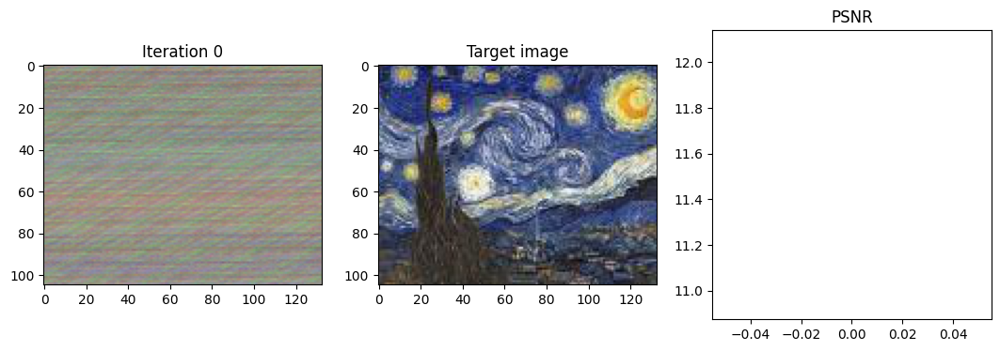

Iteration 2000  Loss: 0.0036  PSNR: 24.40 Time: 0.00 secs per iter 6.62 secs in total


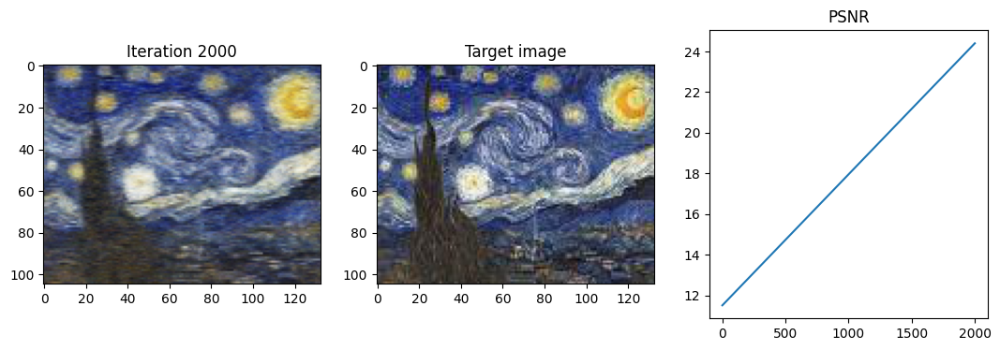

Iteration 4000  Loss: 0.0024  PSNR: 26.15 Time: 0.00 secs per iter 10.86 secs in total


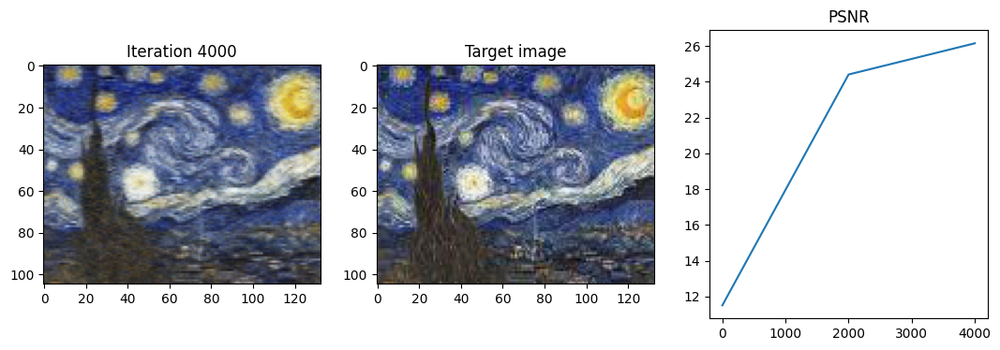

Iteration 6000  Loss: 0.0020  PSNR: 26.98 Time: 0.00 secs per iter 14.26 secs in total


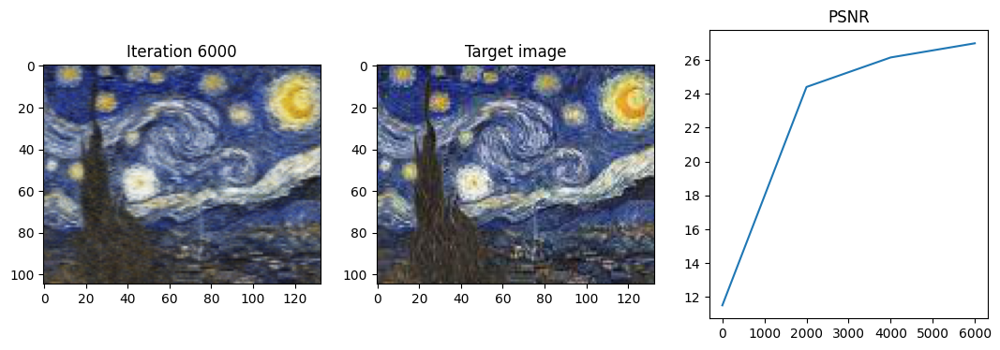

Iteration 8000  Loss: 0.0018  PSNR: 27.52 Time: 0.00 secs per iter 18.05 secs in total


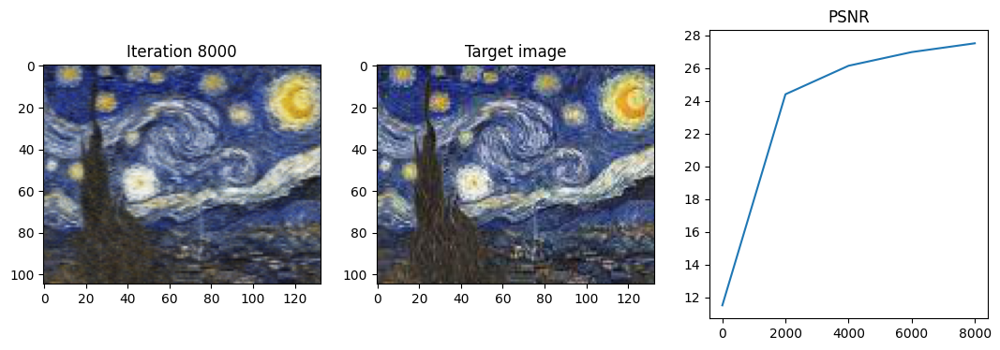

Iteration 10000  Loss: 0.0016  PSNR: 27.91 Time: 0.00 secs per iter 21.32 secs in total


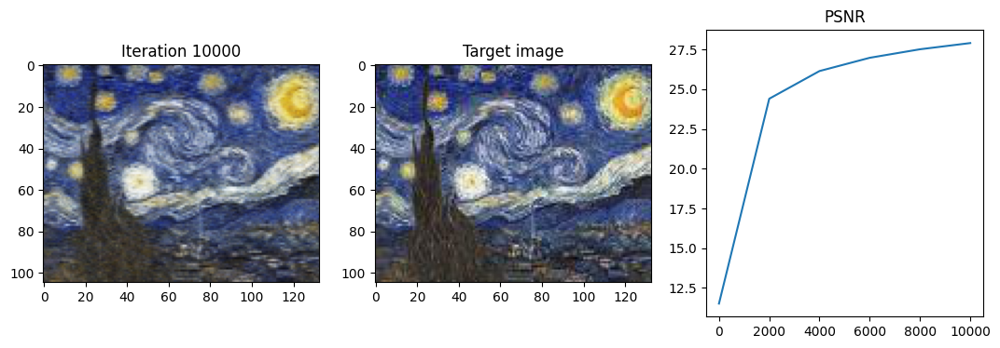

Done!


In [44]:
_ = train_2d_model(test_img=painting, num_frequencies=6, device=device)

### Part 2: Fitting a 3D Image

In [45]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [46]:
url = "https://drive.google.com/file/d/15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj/view?usp=share_link"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 114MB/s]


'lego_data.npz'

Here, we load the data that is comprised by the images, the R and T matrices of each camera position with respect to the world coordinates and the intrinsics parameters K of the camera.

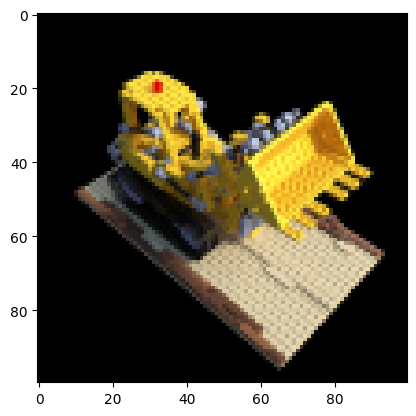

In [48]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

In [49]:
pose_1 = poses[0]
print(pose_1)
R = pose_1[:3, :3]
T = pose_1[:3, 3].reshape(3, 1)
print(R)
print(T)
print(intrinsics)

tensor([[-9.9990e-01, -4.1922e-03,  1.3346e-02, -1.7933e-02],
        [-1.3989e-02,  2.9966e-01, -9.5394e-01,  1.2818e+00],
        [-4.6566e-10, -9.5404e-01, -2.9969e-01,  4.0269e-01],
        [ 0.0000e+00, -0.0000e+00, -0.0000e+00,  1.0000e+00]], device='cuda:0')
tensor([[-9.9990e-01, -4.1922e-03,  1.3346e-02],
        [-1.3989e-02,  2.9966e-01, -9.5394e-01],
        [-4.6566e-10, -9.5404e-01, -2.9969e-01]], device='cuda:0')
tensor([[-0.0179],
        [ 1.2818],
        [ 0.4027]], device='cuda:0')
tensor([[138.8889,   0.0000,  50.0000],
        [  0.0000, 138.8889,  50.0000],
        [  0.0000,   0.0000,   1.0000]], device='cuda:0')


2.1 Complete the following function that calculates the rays that pass through all the pixels of an HxW image

In [50]:
def get_rays(height, width, intrinsics, Rcw, Tcw): # Rwc, Twc
    
    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    Rcw: Rotation matrix of shape (3,3) from camera to world coordinates.
    Tcw: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return 
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder
    
    #############################  TODO 2.1 BEGIN  ##########################  
    y, x = torch.meshgrid(torch.arange(height, device=device), torch.arange(width, device=device))
    # print(y)
    # print(x)
    x = x.float()
    y = y.float()
    #normalization
    pixel_coords = torch.stack([x, y, torch.ones_like(x)], dim=-1).reshape(height*width, 3).T
    # pixel_coords = torch.stack([x[..., None], y[..., None], torch.ones(height, width, 1)], dim=-1)
    print(pixel_coords)
    #cam_coords = torch.matmul(pixel_coords, torch.inverse(intrinsics))
    cam_coords = torch.matmul(torch.inverse(intrinsics), pixel_coords)
    # print(cam_coords)

    #ray_directions = torch.matmul(cam_coords, Rcw)
    ray_directions = torch.matmul(Rcw,cam_coords).T.reshape(height, width,3)
    print(ray_directions)
    #ray_directions = F.normalize(ray_directions, dim=-1)
    ray_origins = torch.reshape(Tcw, (1, 1, 3)).expand(height, width, 3)

    #############################  TODO 2.1 END  ############################
    return ray_origins, ray_directions

In [11]:
#ray_o, ray_d = get_rays(100, 100, intrinsics, R, T) #debugging
#print(ray_o.shape)
#print(ray_d.shape)


Complete the next function to visualize how is the dataset created. You will be able to see from which point of view each image has been captured for the 3D object. What we want to achieve here, is to being able to interpolate between these given views and synthesize new realistic views of the 3D object.

NameError: ignored

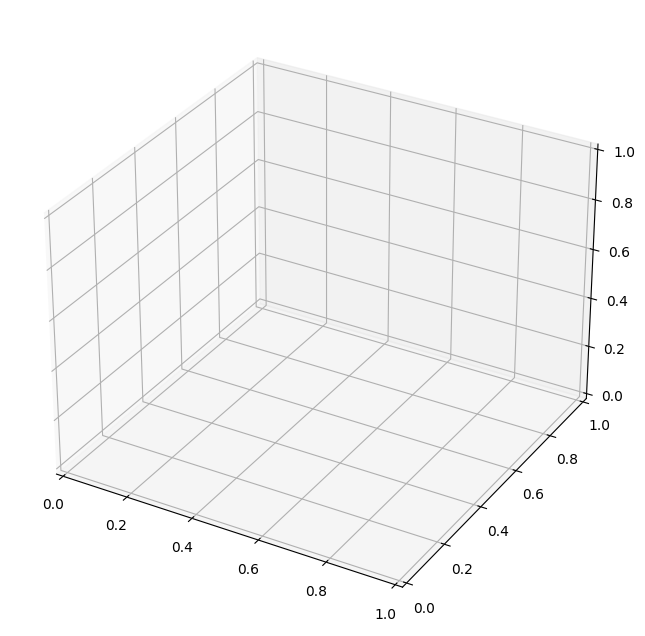

In [30]:
def plot_all_poses(poses):
    
    #############################  TODO 2.1 BEGIN  ############################


    #############################  TODO 2.1 END  ############################

    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()
    
plot_all_poses(data['poses'])

2.2 Complete the following function to implement the sampling of points along a given ray.

In [51]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.
  
    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """

    #############################  TODO 2.2 BEGIN  ############################
    height, width, _ = ray_origins.shape
    
    t_sa = torch.rand(height, width, samples, device=ray_origins.device)
    t_sb = torch.arange(samples, device=ray_origins.device)
    t_samples = (t_sa+ t_sb ) / (samples + 1e-6)
    t_samples = t_samples.expand(height, width, samples)

    t_values = near * (1.0 - t_samples) + far * t_samples

    ray_points = ray_origins[..., None, :] + t_values[..., None] * ray_directions[..., None, :]
    depth_points = t_values
    
    #############################  TODO 2.2 END  ############################
    return ray_points, depth_points

2.3 Define the network architecture of NeRF along with a function that divided data into chunks to avoid memory leaks during training.

In [52]:
class nerf_model(nn.Module):
    
    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper. 
    """

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

        #############################  TODO 2.3 BEGIN  ############################

        self.layer1 = nn.Linear(3 + 2*3*num_x_frequencies, filter_size) #+ 3 * (num_d_frequencies*2 + 1)
        self.layer2 = nn.Linear(filter_size, filter_size)
        self.layer3 = nn.Linear(filter_size, filter_size)
        self.layer4 = nn.Linear(filter_size, filter_size)
        self.layer5 = nn.Linear(filter_size, filter_size)

        self.layer6 = nn.Linear(filter_size + 3 + 2*3*num_x_frequencies, filter_size)
        self.layer7 = nn.Linear(filter_size, filter_size)
        self.layer8 = nn.Linear(filter_size, filter_size)

        self.layer9 = nn.Linear(filter_size, 1)
        self.layer10 = nn.Linear(filter_size, filter_size)
        self.layer11 = nn.Linear(filter_size + 3 + 2*3*num_d_frequencies, 128)
        self.layer12 = nn.Linear(128, 3)


        #############################  TODO 2.3 END  ############################


    def forward(self, x, d): #
        #############################  TODO 2.3 BEGIN  ############################

        x1 = F.relu(self.layer1(x))
        x2 = F.relu(self.layer2(x1))
        x3 = F.relu(self.layer3(x2))
        x4 = F.relu(self.layer4(x3))
        x5 = F.relu(self.layer5(x4))

        x5com = torch.cat([x5, x], dim=-1)

        x6 = F.relu(self.layer6(x5com))

        x7 = F.relu(self.layer7(x6))
        x8 = F.relu(self.layer8(x7))

        sigma = self.layer9(x8)

        x10 = self.layer10(x8) # no relu here, it's a normal layer

        x10com = torch.cat([x10, d], dim=-1)

        x11 = F.relu(self.layer11(x10com))
        
        rgb = torch.sigmoid(self.layer12(x11))




        #############################  TODO 2.3 END  ############################
        return rgb, sigma

In [91]:
#batch_size, height, width, samples = 1, 64, 64, 10
#x = torch.randn(batch_size, height * width * samples, 3)
#d = torch.randn(batch_size, height * width * samples, 3)

#model = nerf_model()
#rgb, sigma = model(x, d)

# Reshaping the output tensors


rgb shape: torch.Size([40960, 3])
sigma shape: torch.Size([40960, 1])


In [54]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):
    
    def get_chunks(inputs, chunksize = 2**15):
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]
    
    """
    This function returns chunks of the ray points and directions to avoid memory errors with the
    neural network. It also applies positional encoding to the input points and directions before 
    dividing them into chunks, as well as normalizing and populating the directions.
    """
    #############################  TODO 2.3 BEGIN  ############################

    ray_dir_den = torch.norm(ray_directions, dim=-1, keepdim=True)
    ray_directions_nrm = ray_directions / ray_dir_den

    ray_directions_pplt = ray_directions_nrm.unsqueeze(-2)
    ray_directions_pplt = ray_directions_pplt.repeat(1, 1, ray_points.shape[2], 1)

    ray_points_flt = ray_points.view(-1, 3)
    ray_directions_flt = ray_directions_pplt.view(-1, 3)

    
    peflt_ray_points = positional_encoding(ray_points_flt, num_frequencies=num_x_frequencies)
    peflt_ray_directions = positional_encoding(ray_directions_flt, num_frequencies=num_d_frequencies)

    #combined_data = torch.cat([pe_ray_points, pe_ray_directions], dim=-1)

    ray_points_batches = get_chunks(peflt_ray_points)
    ray_directions_batches = get_chunks(peflt_ray_directions)
    
    #############################  TODO 2.3 END  ############################

    return ray_points_batches, ray_directions_batches

2.4 Compute the compositing weights of samples on camera ray and then complete the volumetric rendering procedure to reconstruct a whole RGB image from the sampled points and the outputs of the neural network. 

In [55]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
  
    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """
    
    #############################  TODO 2.4 BEGIN  ############################

    device = rgb.device
    
    delta_depth = torch.ones_like(depth_points).to(device) * 1e9
    delta_depth[..., :-1] = torch.diff(depth_points, dim=-1)

    sigma_deltas = -F.relu(s) * delta_depth.reshape_as(s)
    T = torch.cumprod(torch.exp(sigma_deltas), dim=-1)
    T = torch.roll(T, shifts=1, dims=-1)

    C = (T * (1 - torch.exp(sigma_deltas)))[..., None] * rgb
    rec_image = C.sum(dim=-2)







    #############################  TODO 2.4 END  ############################

    return rec_image

2.5 Combine everything together. Given the pose position of a camera, compute the camera rays and sample the 3D points along these rays. Divide those points into batches and feed them to the neural network. Concatenate them and use them for the volumetric rendering to reconstructed the final image.

In [56]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):
    
    #############################  TODO 2.5 BEGIN  ############################

    #compute all the rays from the image
    ray_origins, ray_directions = get_rays(height, width, intrinsics, pose[:3, :3], pose[:3, -1].reshape(-1,1))

    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)


    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)

    rgbs = []
    sigmas = []

    #forward pass the batches and concatenate the outputs at the end

    del ray_origins, ray_directions, ray_points

    for x,d in zip(ray_points_batches, ray_directions_batches):
      rgb, sigma = model.forward(x,d)
      rgbs.append(rgb)
      sigmas.append(sigma)

    combined_rgb     = torch.cat(rgbs, dim=0).reshape(height, width, samples, -1)
    combined_sigma   = torch.cat(sigmas, dim=0).reshape(height, width, samples)





    # Apply volumetric rendering to obtain the reconstructed image
    rec_image = volumetric_rendering(combined_rgb, combined_sigma, depth_points)
    
    #############################  TODO 2.5 END  ############################

    return rec_image

If you manage to pass the autograder for all the previous functions, then it is time to train a NeRF! We provide the hyperparameters for you, we initialize the NeRF model and its weights, and we define a couple lists that will be needed to store results. 

In [57]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8685,  0.4267, -0.5682],
         [-0.8631,  0.4315, -0.5682],
         [-0.8578,  0.4363, -0.5682],
         ...,
         [-0.3495,  0.8939, -0.5682],
         [-0.3441,  0.8988, -0.5682],
         [-0.3387,  0.9036, -0.5682]],

        [[-0.8647,  0.4224, -0.5726],
         [-0.8593,  0.4273, -0.5726],
         [-0.8540,  0.4321, -0.5726],
         ...,
         [-0.3456,  0.8897, -0.5726],
         [-0.3403,  0.8945, -0.5726],
         [-0.3349,  0.8994, -0.5726]],

        [[-0.8609,  0.4182, -0.5771],
         [-0.8555,  0.4230, -0.5771],
         [-0.8502,  0.4278, -0.5771],
         ...,
         [-0.3418,  0.8855, -0.5771],
         [-0.3365,  0.8903, -0.5771],
         [-0.3311,  0.8951, -0.5771]],

        ...,

        [[-0.4997,  0.0170, -0.9971],
         [-0.4943,  0.0218, -0.9971],
         [-0.4890,  0.

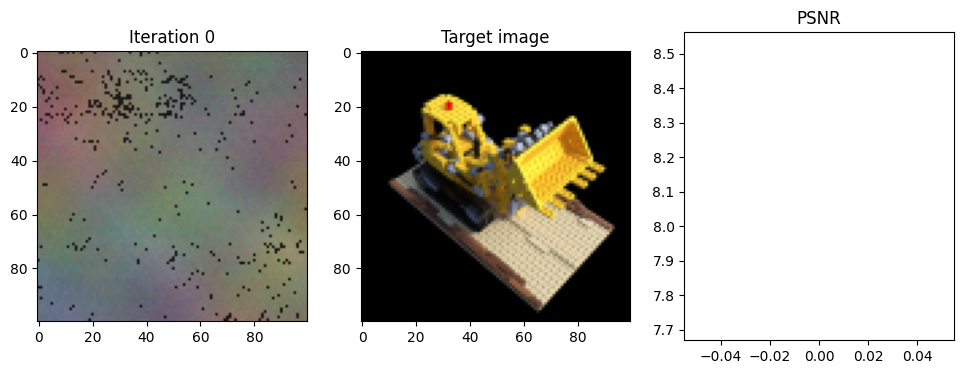

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9326,  0.6240,  0.0122],
         [-0.9269,  0.6284,  0.0122],
         [-0.9211,  0.6328,  0.0122],
         ...,
         [-0.3785,  1.0492,  0.0122],
         [-0.3728,  1.0535,  0.0122],
         [-0.3671,  1.0579,  0.0122]],

        [[-0.9311,  0.6221,  0.0054],
         [-0.9254,  0.6265,  0.0054],
         [-0.9197,  0.6309,  0.0054],
         ...,
         [-0.3770,  1.0473,  0.0054],
         [-0.3713,  1.0517,  0.0054],
         [-0.3656,  1.0560,  0.0054]],

        [[-0.9297,  0.6203, -0.0014],
         [-0.9240,  0.6246, -0.0014],
         [-0.9183,  0.6290, -0.0014],
         ...,
         [-0.3756,  1.0454, -0.0014],
         [-0.3699,  1.0498, -0.0014],
         [-0.3642,  1.0542, -0.0014]],

        ...,

        [[-0.7932,  0.4423, -0.6476],
         [-0.7875,  0.4467, -0.6476],
         [-0.7817,  0.

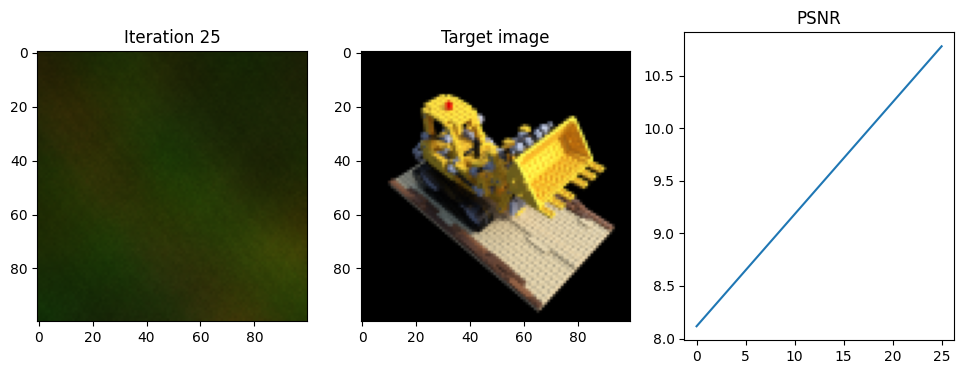

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5890,  0.8088, -0.5081],
         [-0.5820,  0.8107, -0.5081],
         [-0.5751,  0.8125, -0.5081],
         ...,
         [ 0.0857,  0.9892, -0.5081],
         [ 0.0927,  0.9911, -0.5081],
         [ 0.0996,  0.9930, -0.5081]],

        [[-0.5876,  0.8036, -0.5129],
         [-0.5806,  0.8055, -0.5129],
         [-0.5737,  0.8073, -0.5129],
         ...,
         [ 0.0871,  0.9841, -0.5129],
         [ 0.0941,  0.9859, -0.5129],
         [ 0.1010,  0.9878, -0.5129]],

        [[-0.5862,  0.7984, -0.5177],
         [-0.5792,  0.8003, -0.5177],
         [-0.5723,  0.8021, -0.5177],
         ...,
         [ 0.0885,  0.9789, -0.5177],
         [ 0.0954,  0.9807, -0.5177],
         [ 0.1024,  0.9826, -0.5177]],

        ...,

        [[-0.4541,  0.3046, -0.9722],
         [-0.4472,  0.3065, -0.9722],
         [-0.4402,  0.

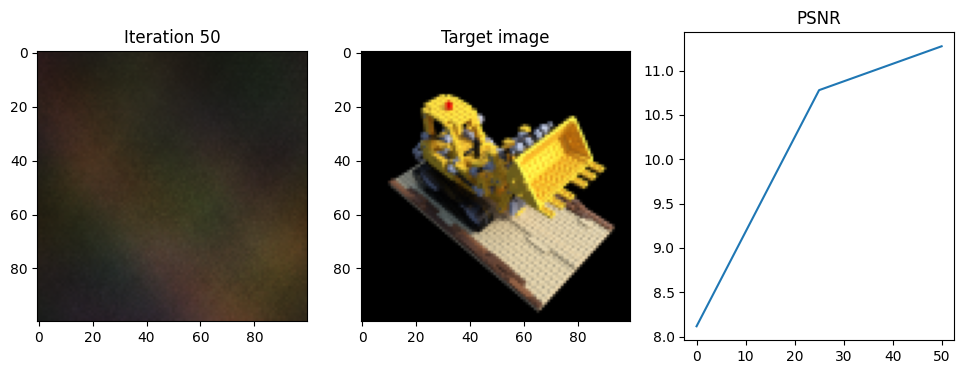

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5587,  0.7128, -0.6626],
         [ 0.5622,  0.7064, -0.6626],
         [ 0.5656,  0.7001, -0.6626],
         ...,
         [ 0.8918,  0.0989, -0.6626],
         [ 0.8953,  0.0926, -0.6626],
         [ 0.8987,  0.0863, -0.6626]],

        [[ 0.5533,  0.7098, -0.6663],
         [ 0.5568,  0.7035, -0.6663],
         [ 0.5602,  0.6972, -0.6663],
         ...,
         [ 0.8864,  0.0960, -0.6663],
         [ 0.8899,  0.0897, -0.6663],
         [ 0.8933,  0.0833, -0.6663]],

        [[ 0.5480,  0.7069, -0.6701],
         [ 0.5514,  0.7006, -0.6701],
         [ 0.5548,  0.6943, -0.6701],
         ...,
         [ 0.8810,  0.0931, -0.6701],
         [ 0.8845,  0.0867, -0.6701],
         [ 0.8879,  0.0804, -0.6701]],

        ...,

        [[ 0.0361,  0.4292, -1.0289],
         [ 0.0395,  0.4228, -1.0289],
         [ 0.0430,  0.

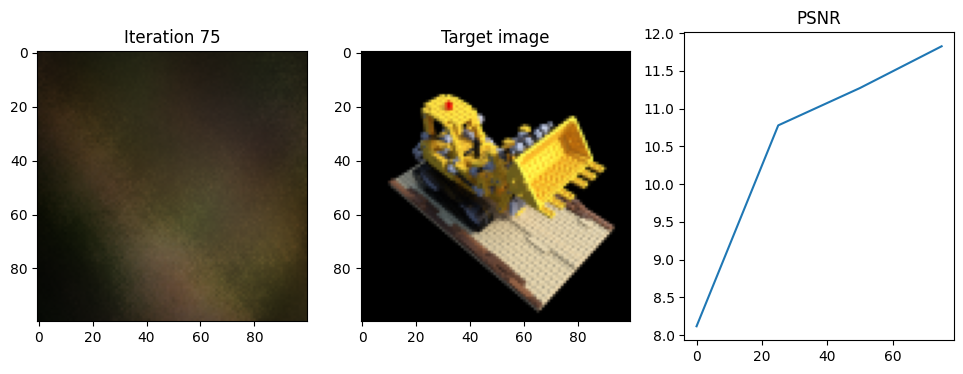

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.2103,  0.8705, -0.6762],
         [ 0.2160,  0.8661, -0.6762],
         [ 0.2218,  0.8618, -0.6762],
         ...,
         [ 0.7660,  0.4474, -0.6762],
         [ 0.7717,  0.4431, -0.6762],
         [ 0.7774,  0.4387, -0.6762]],

        [[ 0.2066,  0.8656, -0.6798],
         [ 0.2123,  0.8612, -0.6798],
         [ 0.2180,  0.8568, -0.6798],
         ...,
         [ 0.7622,  0.4425, -0.6798],
         [ 0.7680,  0.4381, -0.6798],
         [ 0.7737,  0.4338, -0.6798]],

        [[ 0.2028,  0.8606, -0.6835],
         [ 0.2085,  0.8563, -0.6835],
         [ 0.2143,  0.8519, -0.6835],
         ...,
         [ 0.7585,  0.4376, -0.6835],
         [ 0.7642,  0.4332, -0.6835],
         [ 0.7699,  0.4288, -0.6835]],

        ...,

        [[-0.1535,  0.3927, -1.0327],
         [-0.1478,  0.3883, -1.0327],
         [-0.1420,  0.

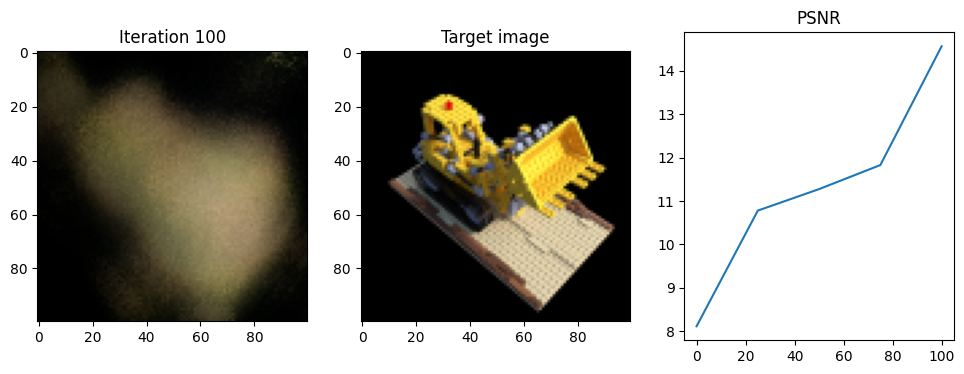

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.0762,  0.2359, -0.2130],
         [-1.0724,  0.2421, -0.2130],
         [-1.0687,  0.2482, -0.2130],
         ...,
         [-0.7119,  0.8318, -0.2130],
         [-0.7082,  0.8379, -0.2130],
         [-0.7044,  0.8441, -0.2130]],

        [[-1.0730,  0.2340, -0.2192],
         [-1.0692,  0.2401, -0.2192],
         [-1.0655,  0.2462, -0.2192],
         ...,
         [-0.7087,  0.8298, -0.2192],
         [-0.7050,  0.8360, -0.2192],
         [-0.7012,  0.8421, -0.2192]],

        [[-1.0698,  0.2320, -0.2253],
         [-1.0660,  0.2382, -0.2253],
         [-1.0623,  0.2443, -0.2253],
         ...,
         [-0.7055,  0.8279, -0.2253],
         [-0.7018,  0.8340, -0.2253],
         [-0.6980,  0.8402, -0.2253]],

        ...,

        [[-0.7661,  0.0463, -0.8094],
         [-0.7623,  0.0525, -0.8094],
         [-0.7586,  0.

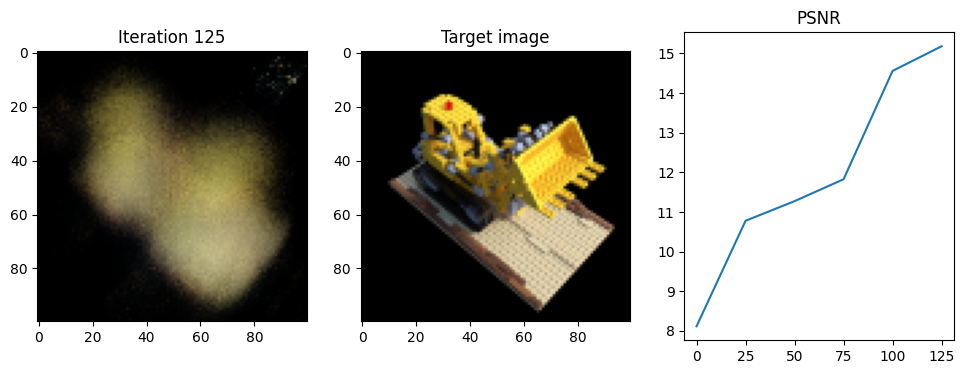

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.7241, -0.8570,  0.0214],
         [ 0.7174, -0.8596,  0.0214],
         [ 0.7107, -0.8623,  0.0214],
         ...,
         [ 0.0742, -1.1127,  0.0214],
         [ 0.0675, -1.1154,  0.0214],
         [ 0.0608, -1.1180,  0.0214]],

        [[ 0.7233, -0.8548,  0.0146],
         [ 0.7166, -0.8575,  0.0146],
         [ 0.7099, -0.8601,  0.0146],
         ...,
         [ 0.0734, -1.1106,  0.0146],
         [ 0.0667, -1.1132,  0.0146],
         [ 0.0600, -1.1159,  0.0146]],

        [[ 0.7224, -0.8527,  0.0077],
         [ 0.7157, -0.8553,  0.0077],
         [ 0.7090, -0.8580,  0.0077],
         ...,
         [ 0.0725, -1.1084,  0.0077],
         [ 0.0658, -1.1111,  0.0077],
         [ 0.0591, -1.1137,  0.0077]],

        ...,

        [[ 0.6423, -0.6492, -0.6404],
         [ 0.6356, -0.6518, -0.6404],
         [ 0.6289, -0.

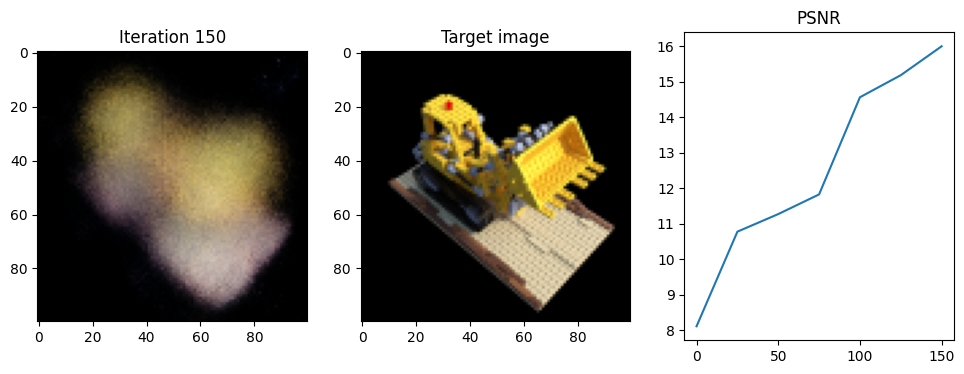

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.1183, -0.0412,  0.0825],
         [-1.1163, -0.0343,  0.0825],
         [-1.1142, -0.0274,  0.0825],
         ...,
         [-0.9182,  0.6279,  0.0825],
         [-0.9161,  0.6348,  0.0825],
         [-0.9140,  0.6417,  0.0825]],

        [[-1.1165, -0.0417,  0.0755],
         [-1.1145, -0.0348,  0.0755],
         [-1.1124, -0.0279,  0.0755],
         ...,
         [-0.9163,  0.6274,  0.0755],
         [-0.9143,  0.6343,  0.0755],
         [-0.9122,  0.6412,  0.0755]],

        [[-1.1147, -0.0423,  0.0686],
         [-1.1126, -0.0354,  0.0686],
         [-1.1106, -0.0285,  0.0686],
         ...,
         [-0.9145,  0.6268,  0.0686],
         [-0.9125,  0.6337,  0.0686],
         [-0.9104,  0.6406,  0.0686]],

        ...,

        [[-0.9412, -0.0942, -0.5910],
         [-0.9392, -0.0873, -0.5910],
         [-0.9371, -0.

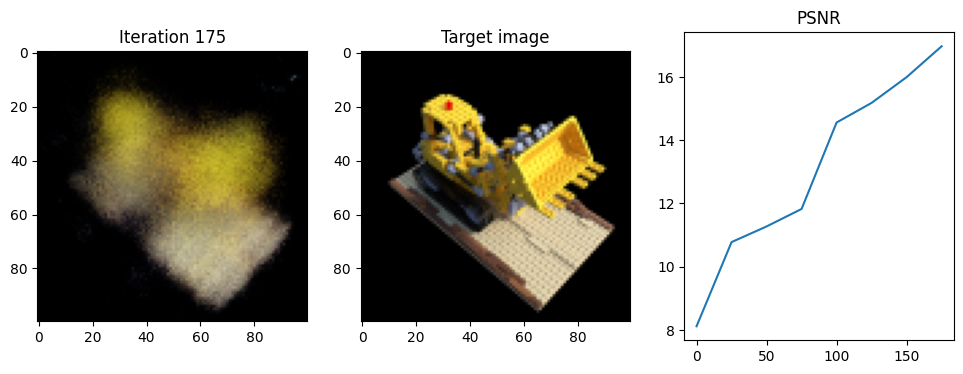

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3839, -0.3529, -0.9936],
         [ 0.3767, -0.3533, -0.9936],
         [ 0.3695, -0.3538, -0.9936],
         ...,
         [-0.3130, -0.3985, -0.9936],
         [-0.3202, -0.3990, -0.9936],
         [-0.3274, -0.3995, -0.9936]],

        [[ 0.3834, -0.3457, -0.9938],
         [ 0.3762, -0.3462, -0.9938],
         [ 0.3690, -0.3466, -0.9938],
         ...,
         [-0.3135, -0.3913, -0.9938],
         [-0.3207, -0.3918, -0.9938],
         [-0.3279, -0.3923, -0.9938]],

        [[ 0.3829, -0.3385, -0.9939],
         [ 0.3758, -0.3390, -0.9939],
         [ 0.3686, -0.3395, -0.9939],
         ...,
         [-0.3140, -0.3842, -0.9939],
         [-0.3212, -0.3846, -0.9939],
         [-0.3283, -0.3851, -0.9939]],

        ...,

        [[ 0.3382,  0.3439, -1.0057],
         [ 0.3311,  0.3435, -1.0057],
         [ 0.3239,  0.

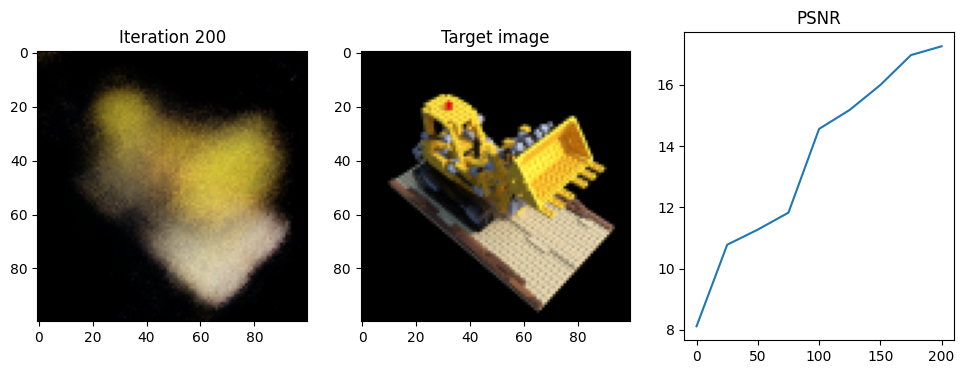

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5223, -0.9883, -0.0985],
         [-0.5272, -0.9831, -0.0985],
         [-0.5322, -0.9778, -0.0985],
         ...,
         [-1.0018, -0.4805, -0.0985],
         [-1.0067, -0.4753, -0.0985],
         [-1.0117, -0.4700, -0.0985]],

        [[-0.5201, -0.9862, -0.1050],
         [-0.5250, -0.9810, -0.1050],
         [-0.5299, -0.9757, -0.1050],
         ...,
         [-0.9995, -0.4784, -0.1050],
         [-1.0045, -0.4732, -0.1050],
         [-1.0094, -0.4679, -0.1050]],

        [[-0.5178, -0.9841, -0.1116],
         [-0.5228, -0.9789, -0.1116],
         [-0.5277, -0.9736, -0.1116],
         ...,
         [-0.9973, -0.4763, -0.1116],
         [-1.0023, -0.4711, -0.1116],
         [-1.0072, -0.4658, -0.1116]],

        ...,

        [[-0.3067, -0.7848, -0.7309],
         [-0.3117, -0.7795, -0.7309],
         [-0.3166, -0.

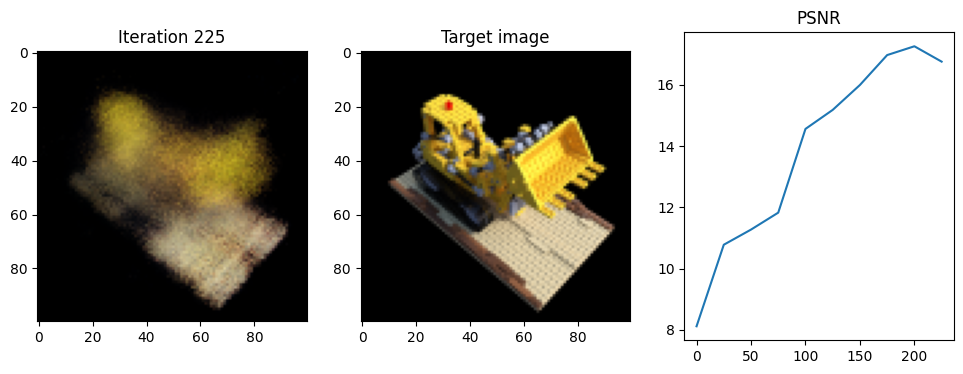

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.3682,  0.6250, -0.8561],
         [-0.3610,  0.6251, -0.8561],
         [-0.3538,  0.6252, -0.8561],
         ...,
         [ 0.3302,  0.6341, -0.8561],
         [ 0.3374,  0.6342, -0.8561],
         [ 0.3446,  0.6343, -0.8561]],

        [[-0.3681,  0.6181, -0.8582],
         [-0.3609,  0.6182, -0.8582],
         [-0.3537,  0.6183, -0.8582],
         ...,
         [ 0.3303,  0.6272, -0.8582],
         [ 0.3375,  0.6273, -0.8582],
         [ 0.3447,  0.6274, -0.8582]],

        [[-0.3680,  0.6112, -0.8602],
         [-0.3608,  0.6113, -0.8602],
         [-0.3536,  0.6114, -0.8602],
         ...,
         [ 0.3304,  0.6203, -0.8602],
         [ 0.3376,  0.6204, -0.8602],
         [ 0.3448,  0.6205, -0.8602]],

        ...,

        [[-0.3595, -0.0444, -1.0550],
         [-0.3523, -0.0443, -1.0550],
         [-0.3451, -0.

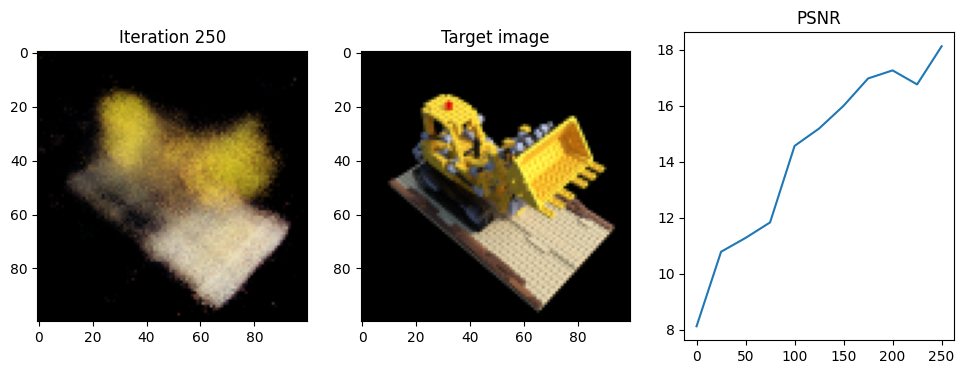

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0080,  0.2391, -0.4313],
         [ 1.0071,  0.2319, -0.4313],
         [ 1.0062,  0.2248, -0.4313],
         ...,
         [ 0.9229, -0.4541, -0.4313],
         [ 0.9221, -0.4613, -0.4313],
         [ 0.9212, -0.4684, -0.4313]],

        [[ 1.0030,  0.2397, -0.4365],
         [ 1.0022,  0.2325, -0.4365],
         [ 1.0013,  0.2254, -0.4365],
         ...,
         [ 0.9180, -0.4535, -0.4365],
         [ 0.9171, -0.4607, -0.4365],
         [ 0.9163, -0.4678, -0.4365]],

        [[ 0.9981,  0.2403, -0.4417],
         [ 0.9972,  0.2331, -0.4417],
         [ 0.9963,  0.2260, -0.4417],
         ...,
         [ 0.9131, -0.4529, -0.4417],
         [ 0.9122, -0.4601, -0.4417],
         [ 0.9113, -0.4672, -0.4417]],

        ...,

        [[ 0.5287,  0.2979, -0.9359],
         [ 0.5278,  0.2907, -0.9359],
         [ 0.5269,  0.

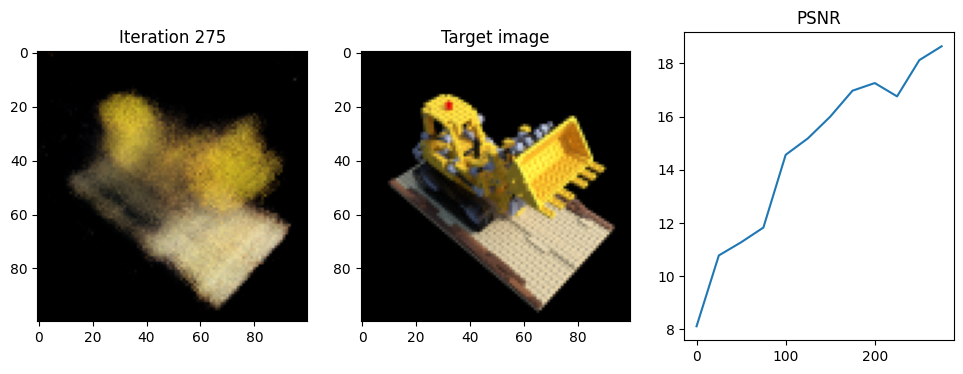

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.7241, -0.8570,  0.0214],
         [ 0.7174, -0.8596,  0.0214],
         [ 0.7107, -0.8623,  0.0214],
         ...,
         [ 0.0742, -1.1127,  0.0214],
         [ 0.0675, -1.1154,  0.0214],
         [ 0.0608, -1.1180,  0.0214]],

        [[ 0.7233, -0.8548,  0.0146],
         [ 0.7166, -0.8575,  0.0146],
         [ 0.7099, -0.8601,  0.0146],
         ...,
         [ 0.0734, -1.1106,  0.0146],
         [ 0.0667, -1.1132,  0.0146],
         [ 0.0600, -1.1159,  0.0146]],

        [[ 0.7224, -0.8527,  0.0077],
         [ 0.7157, -0.8553,  0.0077],
         [ 0.7090, -0.8580,  0.0077],
         ...,
         [ 0.0725, -1.1084,  0.0077],
         [ 0.0658, -1.1111,  0.0077],
         [ 0.0591, -1.1137,  0.0077]],

        ...,

        [[ 0.6423, -0.6492, -0.6404],
         [ 0.6356, -0.6518, -0.6404],
         [ 0.6289, -0.

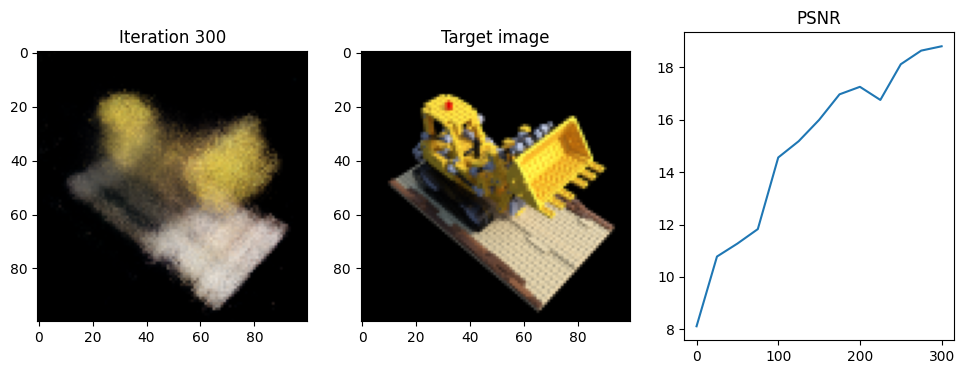

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.9529, -0.5521, -0.2154],
         [ 0.9475, -0.5568, -0.2154],
         [ 0.9420, -0.5615, -0.2154],
         ...,
         [ 0.4245, -1.0087, -0.2154],
         [ 0.4190, -1.0134, -0.2154],
         [ 0.4136, -1.0181, -0.2154]],

        [[ 0.9504, -0.5492, -0.2216],
         [ 0.9450, -0.5539, -0.2216],
         [ 0.9395, -0.5586, -0.2216],
         ...,
         [ 0.4220, -1.0059, -0.2216],
         [ 0.4166, -1.0106, -0.2216],
         [ 0.4111, -1.0153, -0.2216]],

        [[ 0.9480, -0.5464, -0.2277],
         [ 0.9425, -0.5511, -0.2277],
         [ 0.9371, -0.5558, -0.2277],
         ...,
         [ 0.4196, -1.0030, -0.2277],
         [ 0.4141, -1.0077, -0.2277],
         [ 0.4087, -1.0124, -0.2277]],

        ...,

        [[ 0.7143, -0.2760, -0.8110],
         [ 0.7089, -0.2807, -0.8110],
         [ 0.7034, -0.

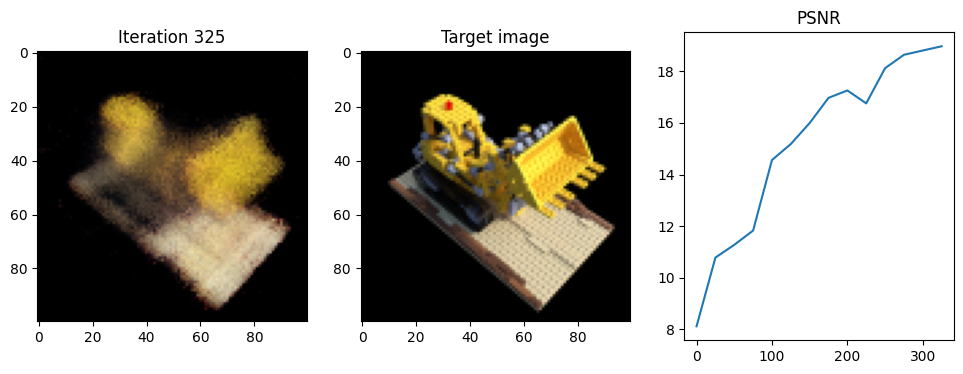

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.1221,  0.0078, -0.0072],
         [-1.1197,  0.0146, -0.0072],
         [-1.1174,  0.0214, -0.0072],
         ...,
         [-0.8934,  0.6677, -0.0072],
         [-0.8911,  0.6745, -0.0072],
         [-0.8887,  0.6813, -0.0072]],

        [[-1.1197,  0.0070, -0.0139],
         [-1.1174,  0.0138, -0.0139],
         [-1.1150,  0.0206, -0.0139],
         ...,
         [-0.8911,  0.6669, -0.0139],
         [-0.8887,  0.6737, -0.0139],
         [-0.8864,  0.6805, -0.0139]],

        [[-1.1174,  0.0062, -0.0207],
         [-1.1150,  0.0130, -0.0207],
         [-1.1127,  0.0198, -0.0207],
         ...,
         [-0.8887,  0.6661, -0.0207],
         [-0.8864,  0.6729, -0.0207],
         [-0.8840,  0.6797, -0.0207]],

        ...,

        [[-0.8944, -0.0711, -0.6627],
         [-0.8920, -0.0643, -0.6627],
         [-0.8897, -0.

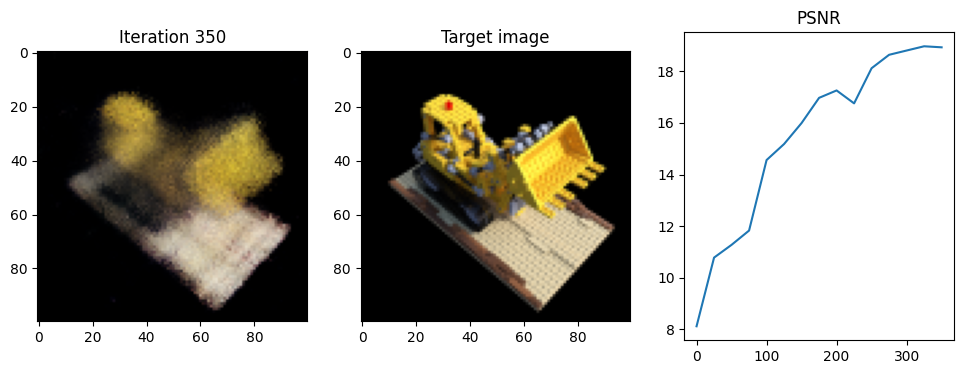

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.7669,  0.4138, -0.7070],
         [-0.7612,  0.4181, -0.7070],
         [-0.7555,  0.4225, -0.7070],
         ...,
         [-0.2110,  0.8365, -0.7070],
         [-0.2053,  0.8409, -0.7070],
         [-0.1995,  0.8452, -0.7070]],

        [[-0.7631,  0.4087, -0.7104],
         [-0.7574,  0.4131, -0.7104],
         [-0.7516,  0.4174, -0.7104],
         ...,
         [-0.2072,  0.8315, -0.7104],
         [-0.2014,  0.8358, -0.7104],
         [-0.1957,  0.8402, -0.7104]],

        [[-0.7593,  0.4037, -0.7139],
         [-0.7535,  0.4080, -0.7139],
         [-0.7478,  0.4124, -0.7139],
         ...,
         [-0.2033,  0.8264, -0.7139],
         [-0.1976,  0.8308, -0.7139],
         [-0.1919,  0.8352, -0.7139]],

        ...,

        [[-0.3954, -0.0748, -1.0403],
         [-0.3897, -0.0704, -1.0403],
         [-0.3839, -0.

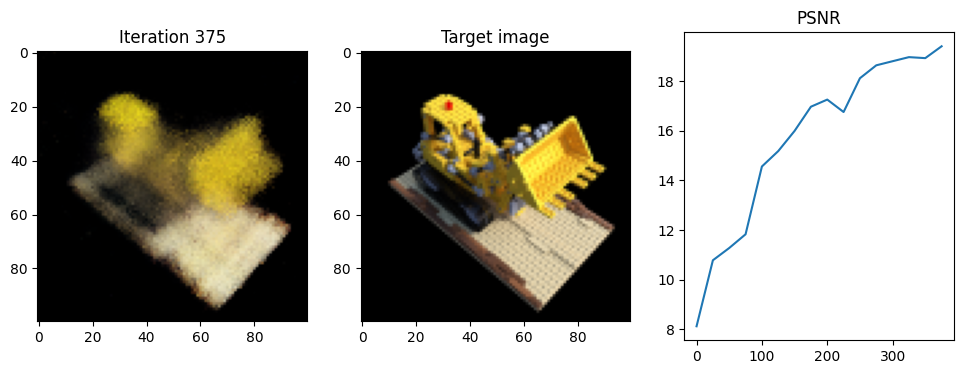

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0661,  0.3087, -0.1653],
         [ 1.0658,  0.3015, -0.1653],
         [ 1.0654,  0.2943, -0.1653],
         ...,
         [ 1.0323, -0.3889, -0.1653],
         [ 1.0319, -0.3961, -0.1653],
         [ 1.0316, -0.4033, -0.1653]],

        [[ 1.0627,  0.3089, -0.1716],
         [ 1.0623,  0.3017, -0.1716],
         [ 1.0620,  0.2945, -0.1716],
         ...,
         [ 1.0288, -0.3887, -0.1716],
         [ 1.0285, -0.3959, -0.1716],
         [ 1.0281, -0.4031, -0.1716]],

        [[ 1.0592,  0.3090, -0.1779],
         [ 1.0588,  0.3018, -0.1779],
         [ 1.0585,  0.2946, -0.1779],
         ...,
         [ 1.0253, -0.3886, -0.1779],
         [ 1.0250, -0.3957, -0.1779],
         [ 1.0246, -0.4029, -0.1779]],

        ...,

        [[ 0.7306,  0.3250, -0.7776],
         [ 0.7303,  0.3178, -0.7776],
         [ 0.7299,  0.

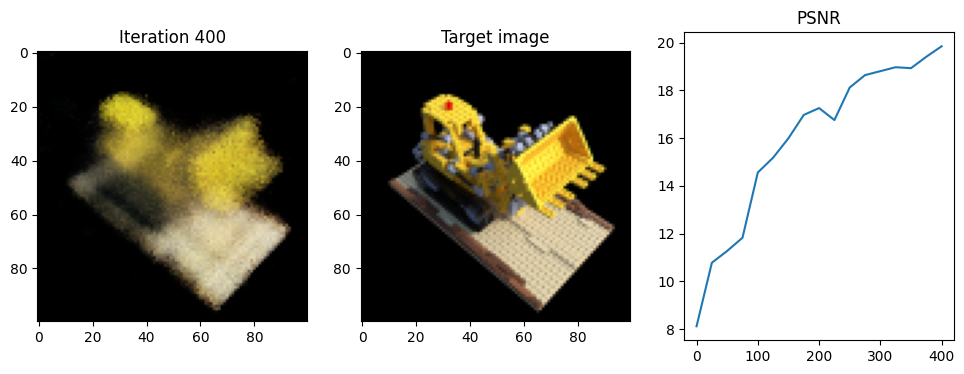

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9291,  0.2498, -0.5776],
         [-0.9248,  0.2556, -0.5776],
         [-0.9204,  0.2613, -0.5776],
         ...,
         [-0.5085,  0.8074, -0.5776],
         [-0.5042,  0.8132, -0.5776],
         [-0.4999,  0.8189, -0.5776]],

        [[-0.9245,  0.2464, -0.5819],
         [-0.9202,  0.2521, -0.5819],
         [-0.9158,  0.2579, -0.5819],
         ...,
         [-0.5040,  0.8040, -0.5819],
         [-0.4996,  0.8097, -0.5819],
         [-0.4953,  0.8155, -0.5819]],

        [[-0.9199,  0.2429, -0.5863],
         [-0.9156,  0.2487, -0.5863],
         [-0.9113,  0.2544, -0.5863],
         ...,
         [-0.4994,  0.8005, -0.5863],
         [-0.4951,  0.8063, -0.5863],
         [-0.4907,  0.8120, -0.5863]],

        ...,

        [[-0.4855, -0.0848, -1.0006],
         [-0.4811, -0.0790, -1.0006],
         [-0.4768, -0.

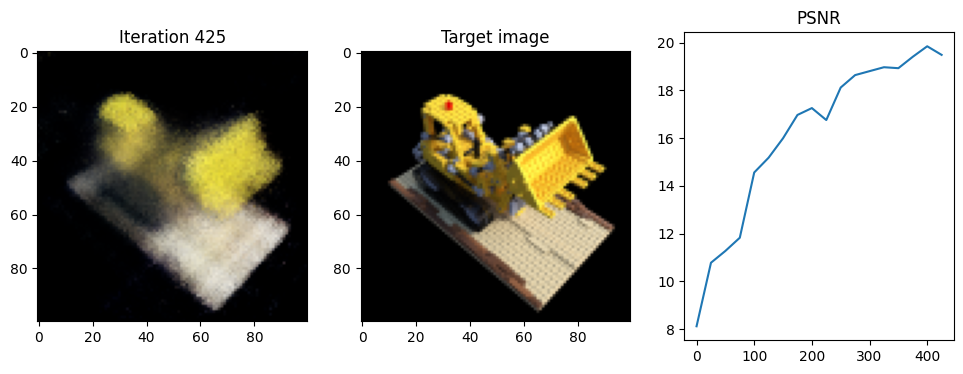

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5443, -0.7094, -0.6780],
         [ 0.5373, -0.7111, -0.6780],
         [ 0.5303, -0.7128, -0.6780],
         ...,
         [-0.1340, -0.8755, -0.6780],
         [-0.1410, -0.8772, -0.6780],
         [-0.1480, -0.8789, -0.6780]],

        [[ 0.5429, -0.7034, -0.6816],
         [ 0.5359, -0.7051, -0.6816],
         [ 0.5289, -0.7068, -0.6816],
         ...,
         [-0.1355, -0.8695, -0.6816],
         [-0.1425, -0.8712, -0.6816],
         [-0.1495, -0.8729, -0.6816]],

        [[ 0.5414, -0.6974, -0.6853],
         [ 0.5344, -0.6991, -0.6853],
         [ 0.5274, -0.7008, -0.6853],
         ...,
         [-0.1370, -0.8635, -0.6853],
         [-0.1440, -0.8652, -0.6853],
         [-0.1510, -0.8669, -0.6853]],

        ...,

        [[ 0.4013, -0.1253, -1.0331],
         [ 0.3943, -0.1270, -1.0331],
         [ 0.3873, -0.

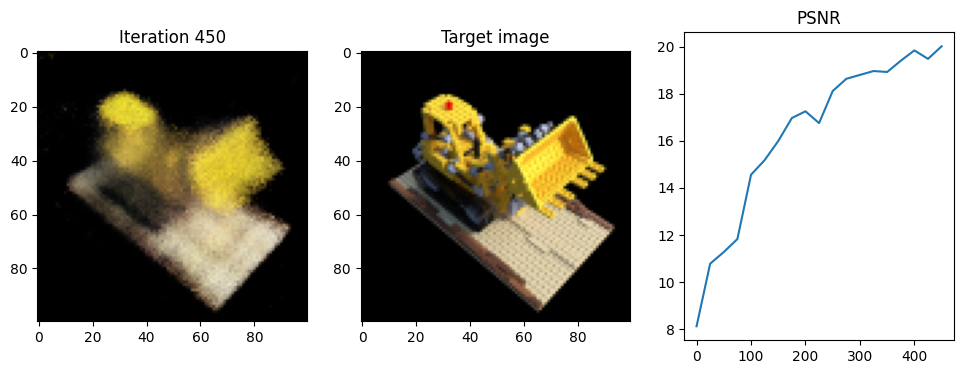

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5511, -0.4157, -0.8847],
         [-0.5518, -0.4085, -0.8847],
         [-0.5525, -0.4014, -0.8847],
         ...,
         [-0.6192,  0.2794, -0.8847],
         [-0.6199,  0.2865, -0.8847],
         [-0.6206,  0.2937, -0.8847]],

        [[-0.5442, -0.4150, -0.8864],
         [-0.5449, -0.4079, -0.8864],
         [-0.5456, -0.4007, -0.8864],
         ...,
         [-0.6123,  0.2800, -0.8864],
         [-0.6130,  0.2872, -0.8864],
         [-0.6137,  0.2944, -0.8864]],

        [[-0.5372, -0.4144, -0.8881],
         [-0.5379, -0.4072, -0.8881],
         [-0.5386, -0.4000, -0.8881],
         ...,
         [-0.6053,  0.2807, -0.8881],
         [-0.6060,  0.2879, -0.8881],
         [-0.6067,  0.2951, -0.8881]],

        ...,

        [[ 0.1237, -0.3496, -1.0519],
         [ 0.1230, -0.3424, -1.0519],
         [ 0.1223, -0.

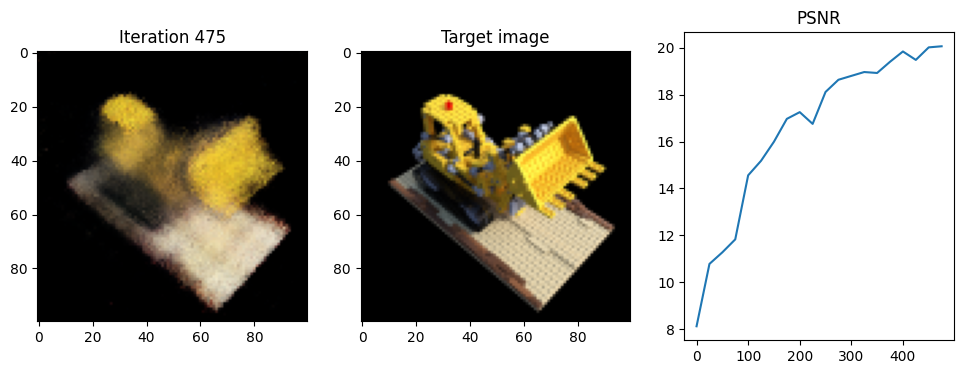

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.9529, -0.5521, -0.2154],
         [ 0.9475, -0.5568, -0.2154],
         [ 0.9420, -0.5615, -0.2154],
         ...,
         [ 0.4245, -1.0087, -0.2154],
         [ 0.4190, -1.0134, -0.2154],
         [ 0.4136, -1.0181, -0.2154]],

        [[ 0.9504, -0.5492, -0.2216],
         [ 0.9450, -0.5539, -0.2216],
         [ 0.9395, -0.5586, -0.2216],
         ...,
         [ 0.4220, -1.0059, -0.2216],
         [ 0.4166, -1.0106, -0.2216],
         [ 0.4111, -1.0153, -0.2216]],

        [[ 0.9480, -0.5464, -0.2277],
         [ 0.9425, -0.5511, -0.2277],
         [ 0.9371, -0.5558, -0.2277],
         ...,
         [ 0.4196, -1.0030, -0.2277],
         [ 0.4141, -1.0077, -0.2277],
         [ 0.4087, -1.0124, -0.2277]],

        ...,

        [[ 0.7143, -0.2760, -0.8110],
         [ 0.7089, -0.2807, -0.8110],
         [ 0.7034, -0.

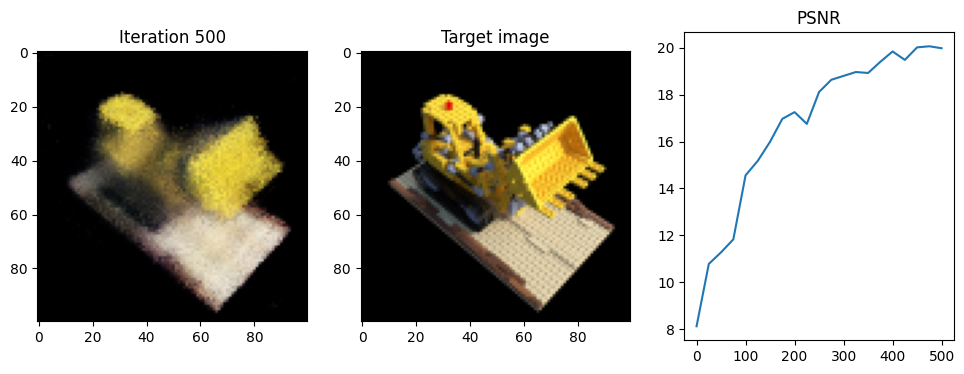

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5443, -0.7094, -0.6780],
         [ 0.5373, -0.7111, -0.6780],
         [ 0.5303, -0.7128, -0.6780],
         ...,
         [-0.1340, -0.8755, -0.6780],
         [-0.1410, -0.8772, -0.6780],
         [-0.1480, -0.8789, -0.6780]],

        [[ 0.5429, -0.7034, -0.6816],
         [ 0.5359, -0.7051, -0.6816],
         [ 0.5289, -0.7068, -0.6816],
         ...,
         [-0.1355, -0.8695, -0.6816],
         [-0.1425, -0.8712, -0.6816],
         [-0.1495, -0.8729, -0.6816]],

        [[ 0.5414, -0.6974, -0.6853],
         [ 0.5344, -0.6991, -0.6853],
         [ 0.5274, -0.7008, -0.6853],
         ...,
         [-0.1370, -0.8635, -0.6853],
         [-0.1440, -0.8652, -0.6853],
         [-0.1510, -0.8669, -0.6853]],

        ...,

        [[ 0.4013, -0.1253, -1.0331],
         [ 0.3943, -0.1270, -1.0331],
         [ 0.3873, -0.

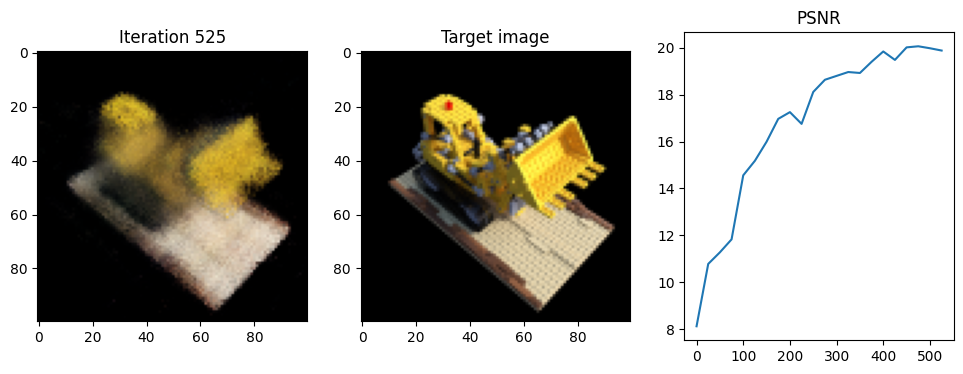

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0080,  0.2391, -0.4313],
         [ 1.0071,  0.2319, -0.4313],
         [ 1.0062,  0.2248, -0.4313],
         ...,
         [ 0.9229, -0.4541, -0.4313],
         [ 0.9221, -0.4613, -0.4313],
         [ 0.9212, -0.4684, -0.4313]],

        [[ 1.0030,  0.2397, -0.4365],
         [ 1.0022,  0.2325, -0.4365],
         [ 1.0013,  0.2254, -0.4365],
         ...,
         [ 0.9180, -0.4535, -0.4365],
         [ 0.9171, -0.4607, -0.4365],
         [ 0.9163, -0.4678, -0.4365]],

        [[ 0.9981,  0.2403, -0.4417],
         [ 0.9972,  0.2331, -0.4417],
         [ 0.9963,  0.2260, -0.4417],
         ...,
         [ 0.9131, -0.4529, -0.4417],
         [ 0.9122, -0.4601, -0.4417],
         [ 0.9113, -0.4672, -0.4417]],

        ...,

        [[ 0.5287,  0.2979, -0.9359],
         [ 0.5278,  0.2907, -0.9359],
         [ 0.5269,  0.

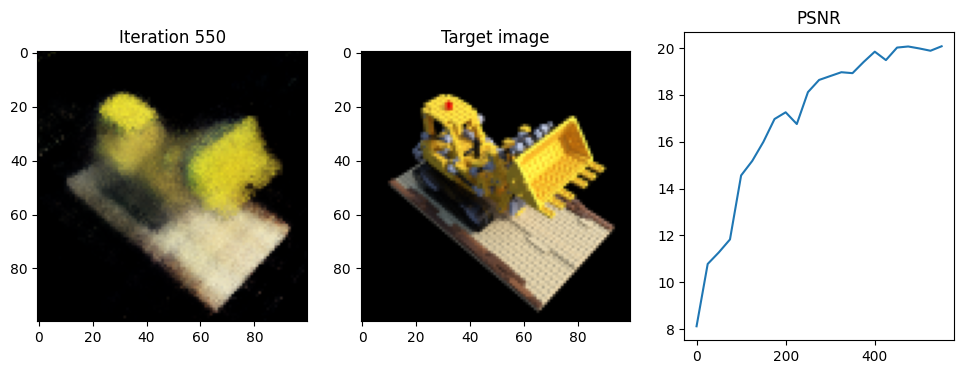

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.2625,  1.0814,  0.1449],
         [-0.2553,  1.0807,  0.1449],
         [-0.2481,  1.0800,  0.1449],
         ...,
         [ 0.4330,  1.0177,  0.1449],
         [ 0.4402,  1.0170,  0.1449],
         [ 0.4474,  1.0163,  0.1449]],

        [[-0.2626,  1.0799,  0.1378],
         [-0.2554,  1.0792,  0.1378],
         [-0.2483,  1.0786,  0.1378],
         ...,
         [ 0.4329,  1.0162,  0.1378],
         [ 0.4401,  1.0155,  0.1378],
         [ 0.4472,  1.0149,  0.1378]],

        [[-0.2627,  1.0784,  0.1308],
         [-0.2556,  1.0777,  0.1308],
         [-0.2484,  1.0771,  0.1308],
         ...,
         [ 0.4327,  1.0147,  0.1308],
         [ 0.4399,  1.0140,  0.1308],
         [ 0.4471,  1.0134,  0.1308]],

        ...,

        [[-0.2757,  0.9372, -0.5384],
         [-0.2685,  0.9365, -0.5384],
         [-0.2613,  0.

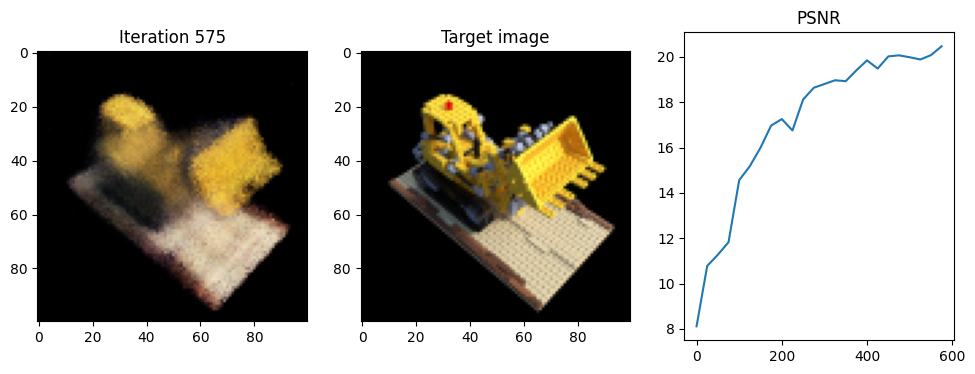

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.6347, -0.5658, -0.7323],
         [-0.6368, -0.5589, -0.7323],
         [-0.6389, -0.5520, -0.7323],
         ...,
         [-0.8350,  0.1033, -0.7323],
         [-0.8371,  0.1102, -0.7323],
         [-0.8391,  0.1171, -0.7323]],

        [[-0.6286, -0.5639, -0.7355],
         [-0.6306, -0.5570, -0.7355],
         [-0.6327, -0.5501, -0.7355],
         ...,
         [-0.8288,  0.1052, -0.7355],
         [-0.8309,  0.1121, -0.7355],
         [-0.8330,  0.1190, -0.7355]],

        [[-0.6224, -0.5621, -0.7387],
         [-0.6245, -0.5552, -0.7387],
         [-0.6265, -0.5483, -0.7387],
         ...,
         [-0.8227,  0.1070, -0.7387],
         [-0.8247,  0.1139, -0.7387],
         [-0.8268,  0.1208, -0.7387]],

        ...,

        [[-0.0368, -0.3868, -1.0455],
         [-0.0388, -0.3799, -1.0455],
         [-0.0409, -0.

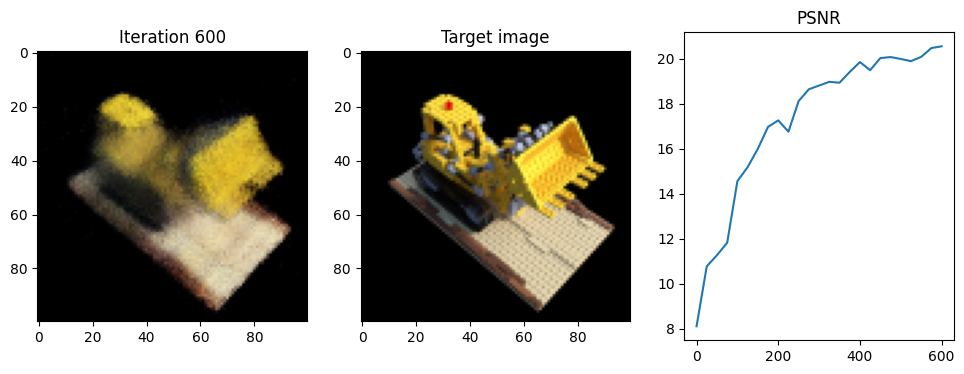

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.2625,  1.0814,  0.1449],
         [-0.2553,  1.0807,  0.1449],
         [-0.2481,  1.0800,  0.1449],
         ...,
         [ 0.4330,  1.0177,  0.1449],
         [ 0.4402,  1.0170,  0.1449],
         [ 0.4474,  1.0163,  0.1449]],

        [[-0.2626,  1.0799,  0.1378],
         [-0.2554,  1.0792,  0.1378],
         [-0.2483,  1.0786,  0.1378],
         ...,
         [ 0.4329,  1.0162,  0.1378],
         [ 0.4401,  1.0155,  0.1378],
         [ 0.4472,  1.0149,  0.1378]],

        [[-0.2627,  1.0784,  0.1308],
         [-0.2556,  1.0777,  0.1308],
         [-0.2484,  1.0771,  0.1308],
         ...,
         [ 0.4327,  1.0147,  0.1308],
         [ 0.4399,  1.0140,  0.1308],
         [ 0.4471,  1.0134,  0.1308]],

        ...,

        [[-0.2757,  0.9372, -0.5384],
         [-0.2685,  0.9365, -0.5384],
         [-0.2613,  0.

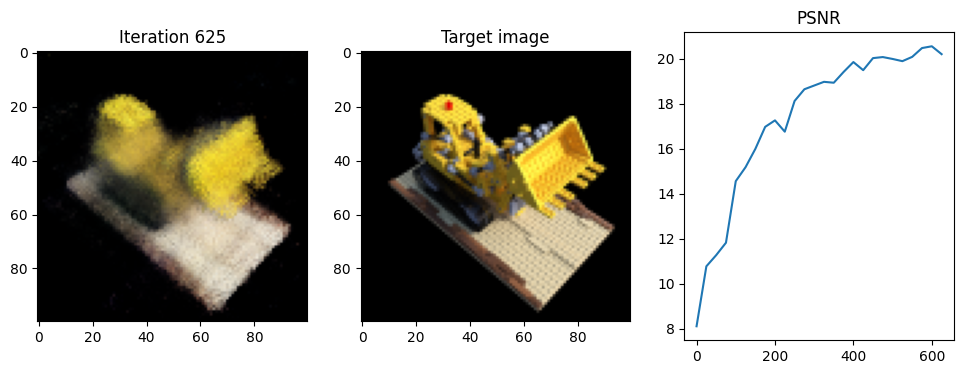

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5649, -0.9692,  0.0278],
         [-0.5696, -0.9637,  0.0278],
         [-0.5744, -0.9583,  0.0278],
         ...,
         [-1.0235, -0.4425,  0.0278],
         [-1.0282, -0.4370,  0.0278],
         [-1.0330, -0.4316,  0.0278]],

        [[-0.5632, -0.9677,  0.0210],
         [-0.5679, -0.9623,  0.0210],
         [-0.5727, -0.9568,  0.0210],
         ...,
         [-1.0218, -0.4410,  0.0210],
         [-1.0265, -0.4355,  0.0210],
         [-1.0313, -0.4301,  0.0210]],

        [[-0.5615, -0.9662,  0.0142],
         [-0.5662, -0.9608,  0.0142],
         [-0.5710, -0.9553,  0.0142],
         ...,
         [-1.0201, -0.4395,  0.0142],
         [-1.0248, -0.4341,  0.0142],
         [-1.0296, -0.4286,  0.0142]],

        ...,

        [[-0.3995, -0.8252, -0.6352],
         [-0.4043, -0.8198, -0.6352],
         [-0.4090, -0.

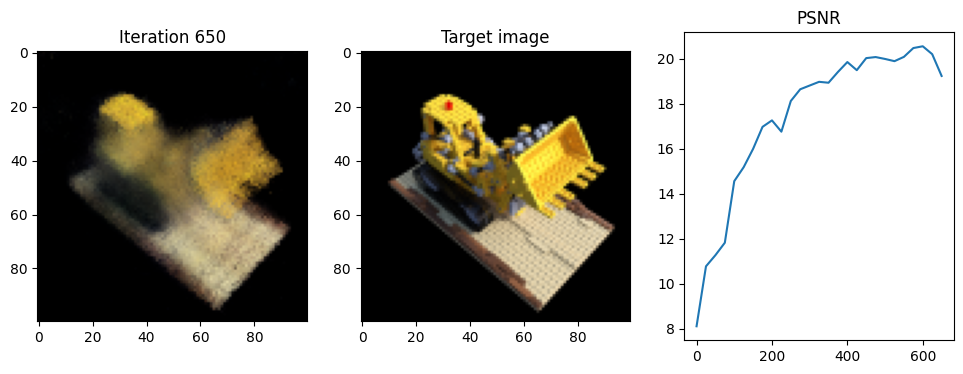

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0661,  0.3087, -0.1653],
         [ 1.0658,  0.3015, -0.1653],
         [ 1.0654,  0.2943, -0.1653],
         ...,
         [ 1.0323, -0.3889, -0.1653],
         [ 1.0319, -0.3961, -0.1653],
         [ 1.0316, -0.4033, -0.1653]],

        [[ 1.0627,  0.3089, -0.1716],
         [ 1.0623,  0.3017, -0.1716],
         [ 1.0620,  0.2945, -0.1716],
         ...,
         [ 1.0288, -0.3887, -0.1716],
         [ 1.0285, -0.3959, -0.1716],
         [ 1.0281, -0.4031, -0.1716]],

        [[ 1.0592,  0.3090, -0.1779],
         [ 1.0588,  0.3018, -0.1779],
         [ 1.0585,  0.2946, -0.1779],
         ...,
         [ 1.0253, -0.3886, -0.1779],
         [ 1.0250, -0.3957, -0.1779],
         [ 1.0246, -0.4029, -0.1779]],

        ...,

        [[ 0.7306,  0.3250, -0.7776],
         [ 0.7303,  0.3178, -0.7776],
         [ 0.7299,  0.

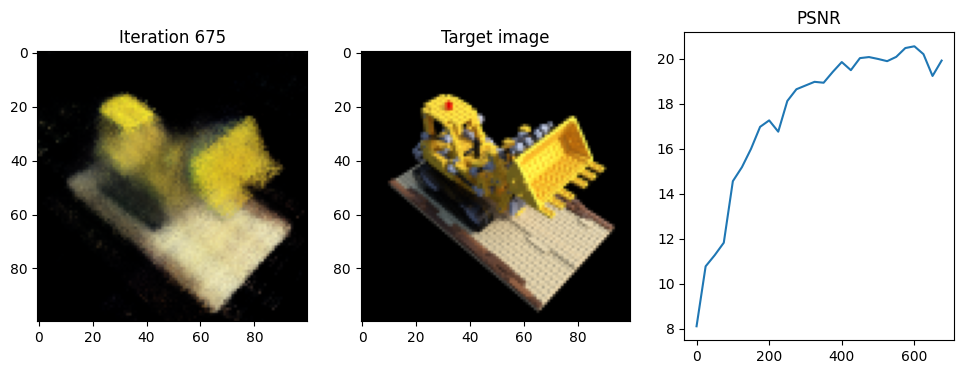

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.0107,  0.0395, -0.4860],
         [-1.0079,  0.0461, -0.4860],
         [-1.0050,  0.0527, -0.4860],
         ...,
         [-0.7368,  0.6819, -0.4860],
         [-0.7340,  0.6885, -0.4860],
         [-0.7312,  0.6952, -0.4860]],

        [[-1.0058,  0.0374, -0.4909],
         [-1.0030,  0.0440, -0.4909],
         [-1.0002,  0.0506, -0.4909],
         ...,
         [-0.7320,  0.6799, -0.4909],
         [-0.7292,  0.6865, -0.4909],
         [-0.7263,  0.6931, -0.4909]],

        [[-1.0010,  0.0353, -0.4958],
         [-0.9982,  0.0419, -0.4958],
         [-0.9953,  0.0486, -0.4958],
         ...,
         [-0.7272,  0.6778, -0.4958],
         [-0.7243,  0.6844, -0.4958],
         [-0.7215,  0.6910, -0.4958]],

        ...,

        [[-0.5408, -0.1609, -0.9622],
         [-0.5379, -0.1542, -0.9622],
         [-0.5351, -0.

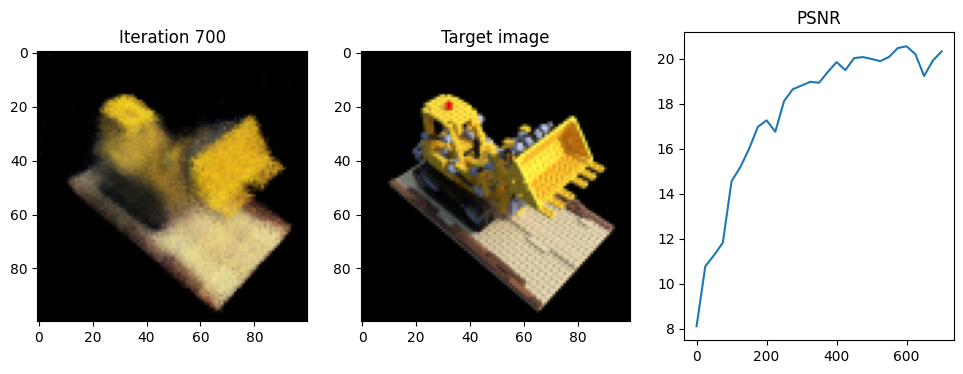

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5438,  0.7250, -0.6617],
         [ 0.5473,  0.7188, -0.6617],
         [ 0.5509,  0.7125, -0.6617],
         ...,
         [ 0.8901,  0.1186, -0.6617],
         [ 0.8936,  0.1123, -0.6617],
         [ 0.8972,  0.1060, -0.6617]],

        [[ 0.5384,  0.7220, -0.6655],
         [ 0.5420,  0.7158, -0.6655],
         [ 0.5456,  0.7095, -0.6655],
         ...,
         [ 0.8848,  0.1155, -0.6655],
         [ 0.8883,  0.1093, -0.6655],
         [ 0.8919,  0.1030, -0.6655]],

        [[ 0.5331,  0.7190, -0.6692],
         [ 0.5367,  0.7127, -0.6692],
         [ 0.5403,  0.7065, -0.6692],
         ...,
         [ 0.8794,  0.1125, -0.6692],
         [ 0.8830,  0.1062, -0.6692],
         [ 0.8866,  0.1000, -0.6692]],

        ...,

        [[ 0.0277,  0.4304, -1.0286],
         [ 0.0313,  0.4241, -1.0286],
         [ 0.0349,  0.

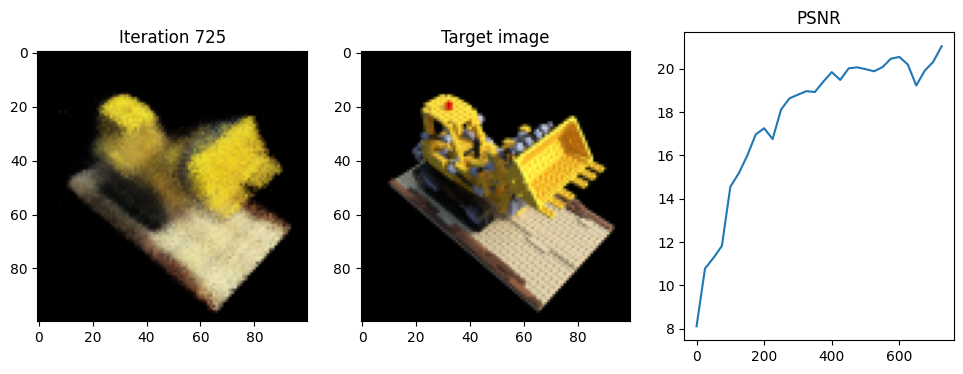

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8673,  0.6896,  0.1777],
         [-0.8612,  0.6934,  0.1777],
         [-0.8551,  0.6973,  0.1777],
         ...,
         [-0.2786,  1.0653,  0.1777],
         [-0.2725,  1.0692,  0.1777],
         [-0.2664,  1.0731,  0.1777]],

        [[-0.8666,  0.6885,  0.1706],
         [-0.8605,  0.6924,  0.1706],
         [-0.8544,  0.6962,  0.1706],
         ...,
         [-0.2779,  1.0643,  0.1706],
         [-0.2718,  1.0681,  0.1706],
         [-0.2657,  1.0720,  0.1706]],

        [[-0.8659,  0.6874,  0.1636],
         [-0.8598,  0.6913,  0.1636],
         [-0.8537,  0.6952,  0.1636],
         ...,
         [-0.2772,  1.0632,  0.1636],
         [-0.2711,  1.0671,  0.1636],
         [-0.2651,  1.0709,  0.1636]],

        ...,

        [[-0.8009,  0.5856, -0.5097],
         [-0.7948,  0.5895, -0.5097],
         [-0.7888,  0.

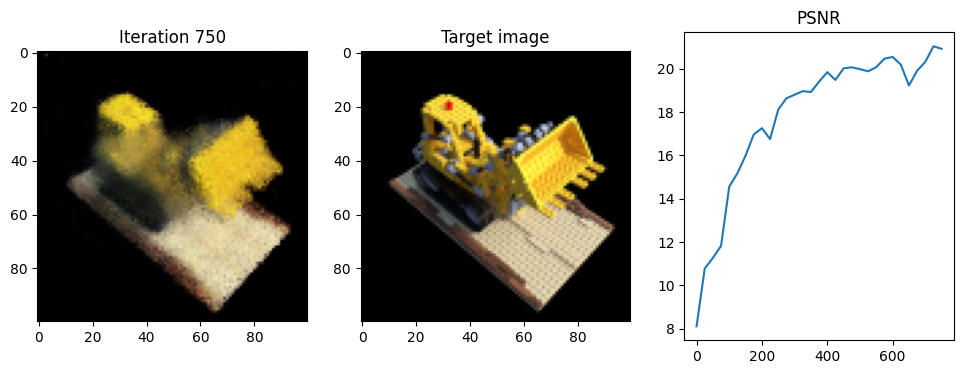

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5511, -0.4157, -0.8847],
         [-0.5518, -0.4085, -0.8847],
         [-0.5525, -0.4014, -0.8847],
         ...,
         [-0.6192,  0.2794, -0.8847],
         [-0.6199,  0.2865, -0.8847],
         [-0.6206,  0.2937, -0.8847]],

        [[-0.5442, -0.4150, -0.8864],
         [-0.5449, -0.4079, -0.8864],
         [-0.5456, -0.4007, -0.8864],
         ...,
         [-0.6123,  0.2800, -0.8864],
         [-0.6130,  0.2872, -0.8864],
         [-0.6137,  0.2944, -0.8864]],

        [[-0.5372, -0.4144, -0.8881],
         [-0.5379, -0.4072, -0.8881],
         [-0.5386, -0.4000, -0.8881],
         ...,
         [-0.6053,  0.2807, -0.8881],
         [-0.6060,  0.2879, -0.8881],
         [-0.6067,  0.2951, -0.8881]],

        ...,

        [[ 0.1237, -0.3496, -1.0519],
         [ 0.1230, -0.3424, -1.0519],
         [ 0.1223, -0.

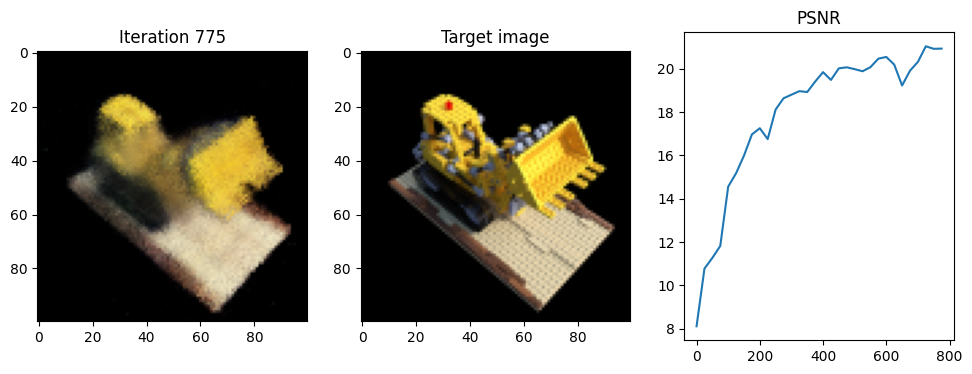

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8673,  0.6896,  0.1777],
         [-0.8612,  0.6934,  0.1777],
         [-0.8551,  0.6973,  0.1777],
         ...,
         [-0.2786,  1.0653,  0.1777],
         [-0.2725,  1.0692,  0.1777],
         [-0.2664,  1.0731,  0.1777]],

        [[-0.8666,  0.6885,  0.1706],
         [-0.8605,  0.6924,  0.1706],
         [-0.8544,  0.6962,  0.1706],
         ...,
         [-0.2779,  1.0643,  0.1706],
         [-0.2718,  1.0681,  0.1706],
         [-0.2657,  1.0720,  0.1706]],

        [[-0.8659,  0.6874,  0.1636],
         [-0.8598,  0.6913,  0.1636],
         [-0.8537,  0.6952,  0.1636],
         ...,
         [-0.2772,  1.0632,  0.1636],
         [-0.2711,  1.0671,  0.1636],
         [-0.2651,  1.0709,  0.1636]],

        ...,

        [[-0.8009,  0.5856, -0.5097],
         [-0.7948,  0.5895, -0.5097],
         [-0.7888,  0.

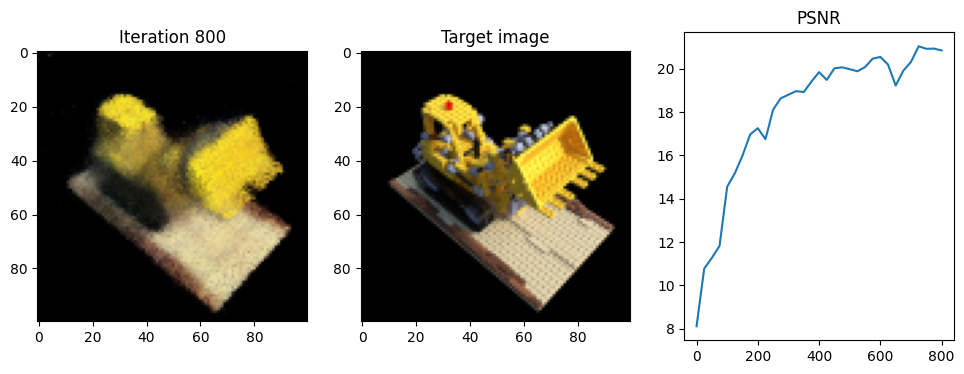

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.0868, -0.7024, -0.8708],
         [ 0.0802, -0.6995, -0.8708],
         [ 0.0735, -0.6966, -0.8708],
         ...,
         [-0.5536, -0.4235, -0.8708],
         [-0.5602, -0.4206, -0.8708],
         [-0.5668, -0.4177, -0.8708]],

        [[ 0.0895, -0.6960, -0.8727],
         [ 0.0829, -0.6931, -0.8727],
         [ 0.0763, -0.6903, -0.8727],
         ...,
         [-0.5508, -0.4171, -0.8727],
         [-0.5574, -0.4143, -0.8727],
         [-0.5640, -0.4114, -0.8727]],

        [[ 0.0923, -0.6896, -0.8746],
         [ 0.0857, -0.6868, -0.8746],
         [ 0.0791, -0.6839, -0.8746],
         ...,
         [-0.5480, -0.4108, -0.8746],
         [-0.5546, -0.4079, -0.8746],
         [-0.5612, -0.4050, -0.8746]],

        ...,

        [[ 0.3559, -0.0844, -1.0537],
         [ 0.3493, -0.0815, -1.0537],
         [ 0.3427, -0.

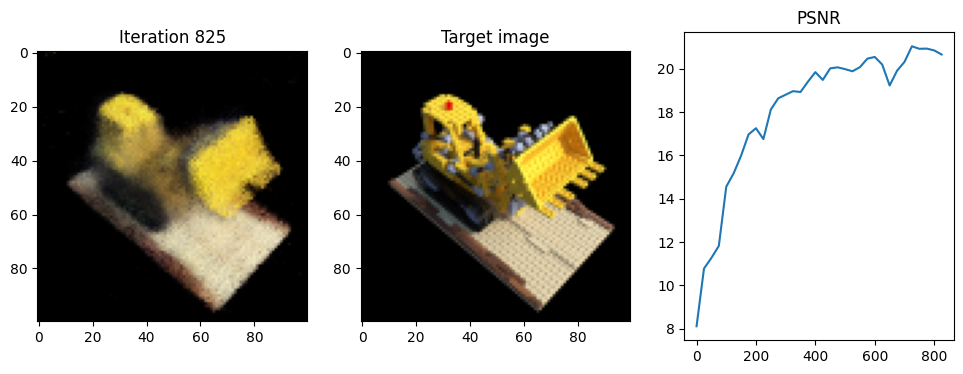

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5890,  0.8088, -0.5081],
         [-0.5820,  0.8107, -0.5081],
         [-0.5751,  0.8125, -0.5081],
         ...,
         [ 0.0857,  0.9892, -0.5081],
         [ 0.0927,  0.9911, -0.5081],
         [ 0.0996,  0.9930, -0.5081]],

        [[-0.5876,  0.8036, -0.5129],
         [-0.5806,  0.8055, -0.5129],
         [-0.5737,  0.8073, -0.5129],
         ...,
         [ 0.0871,  0.9841, -0.5129],
         [ 0.0941,  0.9859, -0.5129],
         [ 0.1010,  0.9878, -0.5129]],

        [[-0.5862,  0.7984, -0.5177],
         [-0.5792,  0.8003, -0.5177],
         [-0.5723,  0.8021, -0.5177],
         ...,
         [ 0.0885,  0.9789, -0.5177],
         [ 0.0954,  0.9807, -0.5177],
         [ 0.1024,  0.9826, -0.5177]],

        ...,

        [[-0.4541,  0.3046, -0.9722],
         [-0.4472,  0.3065, -0.9722],
         [-0.4402,  0.

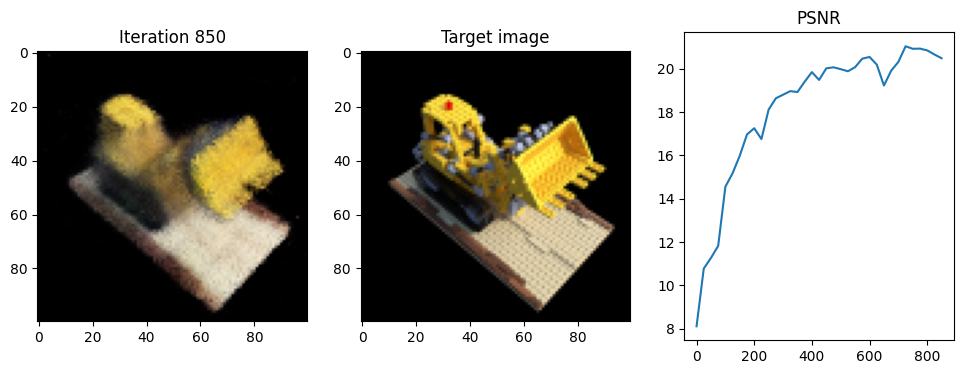

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3672, -0.9379, -0.4947],
         [ 0.3600, -0.9379, -0.4947],
         [ 0.3528, -0.9380, -0.4947],
         ...,
         [-0.3312, -0.9432, -0.4947],
         [-0.3384, -0.9433, -0.4947],
         [-0.3456, -0.9434, -0.4947]],

        [[ 0.3672, -0.9326, -0.4996],
         [ 0.3600, -0.9326, -0.4996],
         [ 0.3528, -0.9327, -0.4996],
         ...,
         [-0.3312, -0.9379, -0.4996],
         [-0.3384, -0.9380, -0.4996],
         [-0.3456, -0.9380, -0.4996]],

        [[ 0.3671, -0.9273, -0.5044],
         [ 0.3599, -0.9273, -0.5044],
         [ 0.3527, -0.9274, -0.5044],
         ...,
         [-0.3313, -0.9326, -0.5044],
         [-0.3385, -0.9327, -0.5044],
         [-0.3457, -0.9327, -0.5044]],

        ...,

        [[ 0.3633, -0.4227, -0.9662],
         [ 0.3561, -0.4227, -0.9662],
         [ 0.3489, -0.

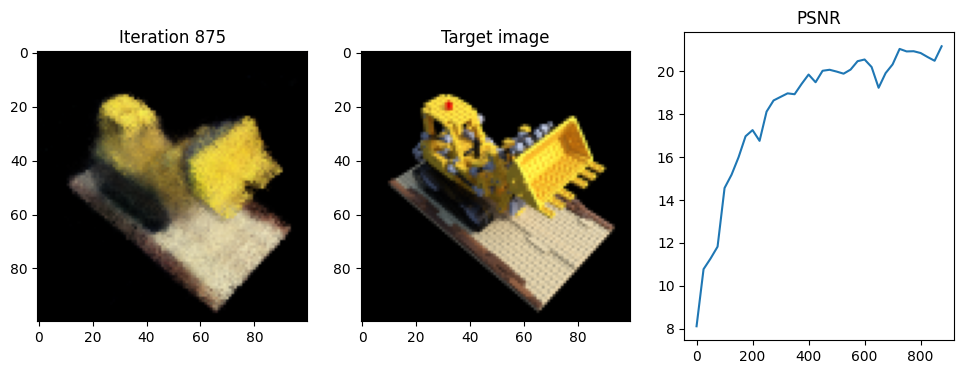

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0267, -0.4404,  0.1056],
         [ 1.0219, -0.4457,  0.1056],
         [ 1.0171, -0.4511,  0.1056],
         ...,
         [ 0.5593, -0.9593,  0.1056],
         [ 0.5544, -0.9646,  0.1056],
         [ 0.5496, -0.9700,  0.1056]],

        [[ 1.0254, -0.4392,  0.0986],
         [ 1.0206, -0.4446,  0.0986],
         [ 1.0158, -0.4499,  0.0986],
         ...,
         [ 0.5580, -0.9581,  0.0986],
         [ 0.5531, -0.9634,  0.0986],
         [ 0.5483, -0.9688,  0.0986]],

        [[ 1.0241, -0.4380,  0.0916],
         [ 1.0193, -0.4434,  0.0916],
         [ 1.0145, -0.4487,  0.0916],
         ...,
         [ 0.5567, -0.9569,  0.0916],
         [ 0.5518, -0.9623,  0.0916],
         [ 0.5470, -0.9676,  0.0916]],

        ...,

        [[ 0.9003, -0.3265, -0.5718],
         [ 0.8955, -0.3319, -0.5718],
         [ 0.8907, -0.

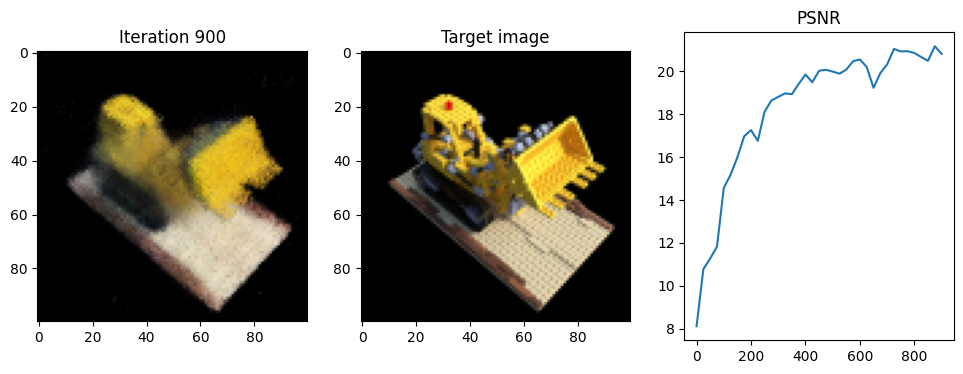

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5535, -0.5047, -0.8355],
         [ 0.5467, -0.5070, -0.8355],
         [ 0.5399, -0.5094, -0.8355],
         ...,
         [-0.1072, -0.7311, -0.8355],
         [-0.1140, -0.7334, -0.8355],
         [-0.1208, -0.7357, -0.8355]],

        [[ 0.5513, -0.4982, -0.8378],
         [ 0.5445, -0.5006, -0.8378],
         [ 0.5376, -0.5029, -0.8378],
         ...,
         [-0.1094, -0.7246, -0.8378],
         [-0.1162, -0.7270, -0.8378],
         [-0.1231, -0.7293, -0.8378]],

        [[ 0.5490, -0.4918, -0.8401],
         [ 0.5422, -0.4941, -0.8401],
         [ 0.5354, -0.4964, -0.8401],
         ...,
         [-0.1116, -0.7182, -0.8401],
         [-0.1185, -0.7205, -0.8401],
         [-0.1253, -0.7228, -0.8401]],

        ...,

        [[ 0.3386,  0.1223, -1.0557],
         [ 0.3318,  0.1200, -1.0557],
         [ 0.3250,  0.

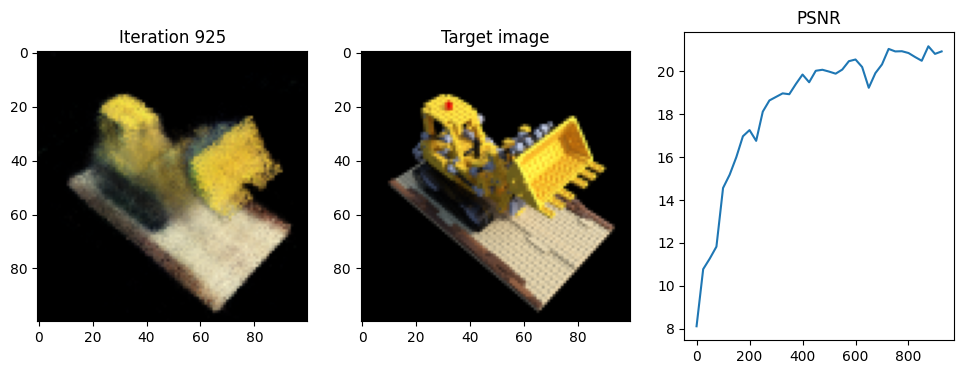

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.3602, -0.5947, -0.8808],
         [-0.3636, -0.5883, -0.8808],
         [-0.3669, -0.5819, -0.8808],
         ...,
         [-0.6839,  0.0242, -0.8808],
         [-0.6873,  0.0306, -0.8808],
         [-0.6906,  0.0369, -0.8808]],

        [[-0.3541, -0.5915, -0.8825],
         [-0.3574, -0.5851, -0.8825],
         [-0.3607, -0.5787, -0.8825],
         ...,
         [-0.6777,  0.0274, -0.8825],
         [-0.6811,  0.0338, -0.8825],
         [-0.6844,  0.0402, -0.8825]],

        [[-0.3479, -0.5882, -0.8843],
         [-0.3512, -0.5818, -0.8843],
         [-0.3546, -0.5755, -0.8843],
         ...,
         [-0.6716,  0.0306, -0.8843],
         [-0.6749,  0.0370, -0.8843],
         [-0.6782,  0.0434, -0.8843]],

        ...,

        [[ 0.2396, -0.2809, -1.0525],
         [ 0.2363, -0.2746, -1.0525],
         [ 0.2329, -0.

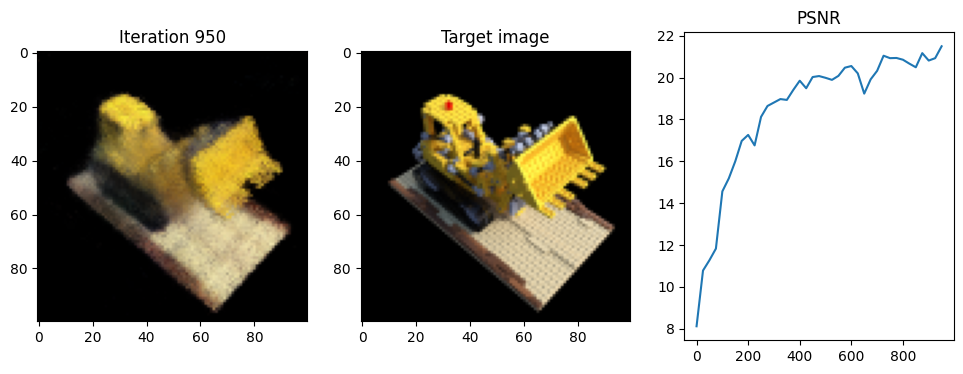

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.8225,  0.3084, -0.6982],
         [ 0.8221,  0.3012, -0.6982],
         [ 0.8216,  0.2940, -0.6982],
         ...,
         [ 0.7782, -0.3886, -0.6982],
         [ 0.7777, -0.3958, -0.6982],
         [ 0.7773, -0.4030, -0.6982]],

        [[ 0.8162,  0.3088, -0.7017],
         [ 0.8158,  0.3016, -0.7017],
         [ 0.8153,  0.2944, -0.7017],
         ...,
         [ 0.7719, -0.3882, -0.7017],
         [ 0.7715, -0.3954, -0.7017],
         [ 0.7710, -0.4026, -0.7017]],

        [[ 0.8100,  0.3092, -0.7052],
         [ 0.8095,  0.3020, -0.7052],
         [ 0.8091,  0.2948, -0.7052],
         ...,
         [ 0.7656, -0.3878, -0.7052],
         [ 0.7652, -0.3950, -0.7052],
         [ 0.7647, -0.4022, -0.7052]],

        ...,

        [[ 0.2137,  0.3471, -1.0382],
         [ 0.2132,  0.3399, -1.0382],
         [ 0.2128,  0.

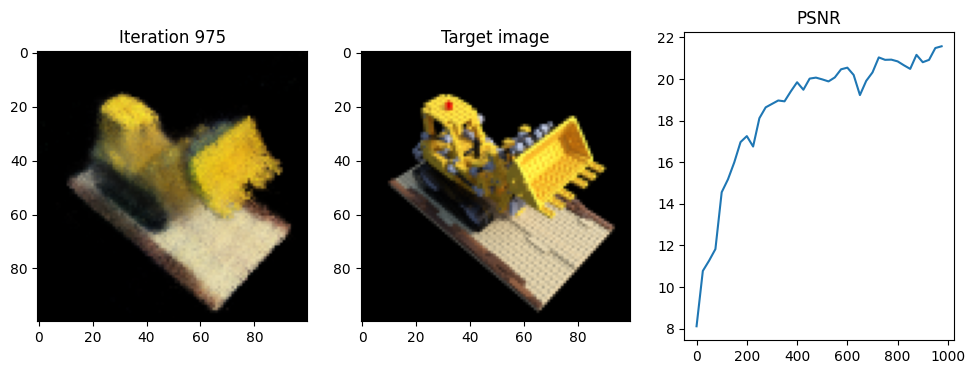

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.0233,  0.3955, -0.2360],
         [-1.0186,  0.4010, -0.2360],
         [-1.0140,  0.4065, -0.2360],
         ...,
         [-0.5716,  0.9282, -0.2360],
         [-0.5670,  0.9337, -0.2360],
         [-0.5623,  0.9392, -0.2360]],

        [[-1.0203,  0.3930, -0.2421],
         [-1.0156,  0.3985, -0.2421],
         [-1.0110,  0.4040, -0.2421],
         ...,
         [-0.5687,  0.9257, -0.2421],
         [-0.5640,  0.9312, -0.2421],
         [-0.5594,  0.9367, -0.2421]],

        [[-1.0173,  0.3905, -0.2481],
         [-1.0127,  0.3960, -0.2481],
         [-1.0080,  0.4015, -0.2481],
         ...,
         [-0.5657,  0.9232, -0.2481],
         [-0.5611,  0.9287, -0.2481],
         [-0.5564,  0.9342, -0.2481]],

        ...,

        [[-0.7360,  0.1520, -0.8242],
         [-0.7314,  0.1575, -0.8242],
         [-0.7267,  0.

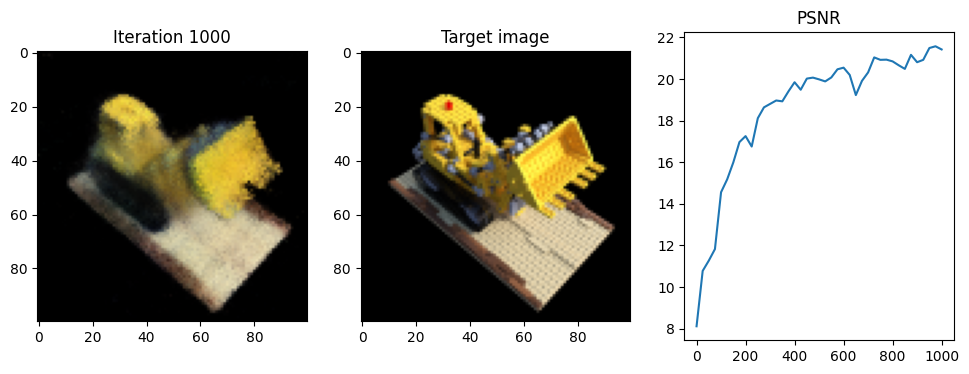

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1569, -0.9449, -0.5846],
         [ 0.1499, -0.9433, -0.5846],
         [ 0.1429, -0.9417, -0.5846],
         ...,
         [-0.5245, -0.7920, -0.5846],
         [-0.5315, -0.7904, -0.5846],
         [-0.5386, -0.7888, -0.5846]],

        [[ 0.1582, -0.9393, -0.5889],
         [ 0.1512, -0.9377, -0.5889],
         [ 0.1441, -0.9361, -0.5889],
         ...,
         [-0.5233, -0.7864, -0.5889],
         [-0.5303, -0.7848, -0.5889],
         [-0.5373, -0.7832, -0.5889]],

        [[ 0.1595, -0.9337, -0.5932],
         [ 0.1524, -0.9321, -0.5932],
         [ 0.1454, -0.9305, -0.5932],
         ...,
         [-0.5220, -0.7807, -0.5932],
         [-0.5290, -0.7792, -0.5932],
         [-0.5360, -0.7776, -0.5932]],

        ...,

        [[ 0.2793, -0.3995, -1.0033],
         [ 0.2723, -0.3979, -1.0033],
         [ 0.2653, -0.

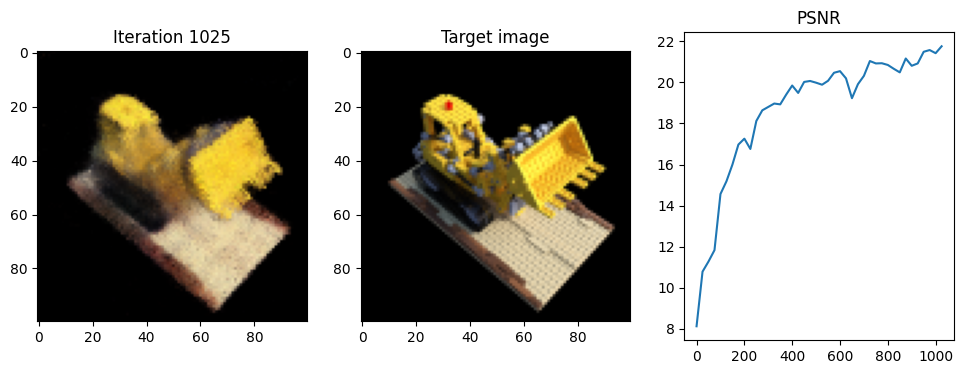

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-7.1489e-01,  8.5465e-01,  1.3304e-01],
         [-7.0817e-01,  8.5724e-01,  1.3304e-01],
         [-7.0145e-01,  8.5983e-01,  1.3304e-01],
         ...,
         [-6.3146e-02,  1.1056e+00,  1.3304e-01],
         [-5.6427e-02,  1.1082e+00,  1.3304e-01],
         [-4.9708e-02,  1.1108e+00,  1.3304e-01]],

        [[-7.1433e-01,  8.5319e-01,  1.2602e-01],
         [-7.0761e-01,  8.5577e-01,  1.2602e-01],
         [-7.0089e-01,  8.5836e-01,  1.2602e-01],
         ...,
         [-6.2582e-02,  1.1042e+00,  1.2602e-01],
         [-5.5863e-02,  1.1068e+00,  1.2602e-01],
         [-4.9144e-02,  1.1093e+00,  1.2602e-01]],

        [[-7.1376e-01,  8.5172e-01,  1.1899e-01],
         [-7.0704e-01,  8.5431e-01,  1.1899e-01],
         [-7.0032e-01,  8.5689e-01,  1.1899e-01],
         ...,
         [-6.2017e-02,  1.1027e+00,  1.1899e-01]

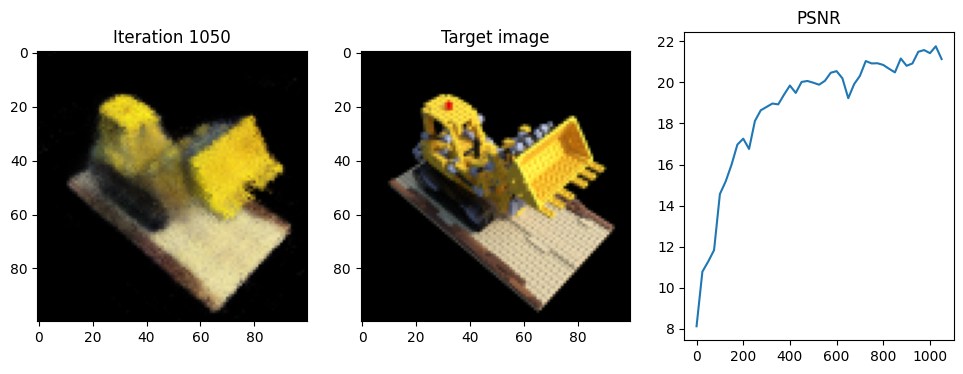

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.7669,  0.4138, -0.7070],
         [-0.7612,  0.4181, -0.7070],
         [-0.7555,  0.4225, -0.7070],
         ...,
         [-0.2110,  0.8365, -0.7070],
         [-0.2053,  0.8409, -0.7070],
         [-0.1995,  0.8452, -0.7070]],

        [[-0.7631,  0.4087, -0.7104],
         [-0.7574,  0.4131, -0.7104],
         [-0.7516,  0.4174, -0.7104],
         ...,
         [-0.2072,  0.8315, -0.7104],
         [-0.2014,  0.8358, -0.7104],
         [-0.1957,  0.8402, -0.7104]],

        [[-0.7593,  0.4037, -0.7139],
         [-0.7535,  0.4080, -0.7139],
         [-0.7478,  0.4124, -0.7139],
         ...,
         [-0.2033,  0.8264, -0.7139],
         [-0.1976,  0.8308, -0.7139],
         [-0.1919,  0.8352, -0.7139]],

        ...,

        [[-0.3954, -0.0748, -1.0403],
         [-0.3897, -0.0704, -1.0403],
         [-0.3839, -0.

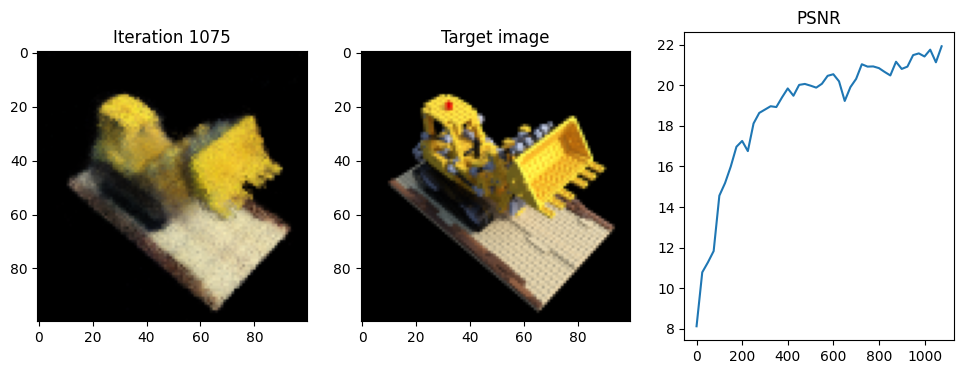

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0801e+00, -1.7659e-01, -2.4786e-01],
         [ 1.0767e+00, -1.8292e-01, -2.4786e-01],
         [ 1.0732e+00, -1.8924e-01, -2.4786e-01],
         ...,
         [ 7.4695e-01, -7.9041e-01, -2.4786e-01],
         [ 7.4351e-01, -7.9674e-01, -2.4786e-01],
         [ 7.4008e-01, -8.0307e-01, -2.4786e-01]],

        [[ 1.0766e+00, -1.7470e-01, -2.5387e-01],
         [ 1.0732e+00, -1.8103e-01, -2.5387e-01],
         [ 1.0697e+00, -1.8736e-01, -2.5387e-01],
         ...,
         [ 7.4347e-01, -7.8853e-01, -2.5387e-01],
         [ 7.4004e-01, -7.9486e-01, -2.5387e-01],
         [ 7.3661e-01, -8.0118e-01, -2.5387e-01]],

        [[ 1.0731e+00, -1.7282e-01, -2.5989e-01],
         [ 1.0697e+00, -1.7915e-01, -2.5989e-01],
         [ 1.0663e+00, -1.8547e-01, -2.5989e-01],
         ...,
         [ 7.4000e-01, -7.8664e-01, -2.5989e-01]

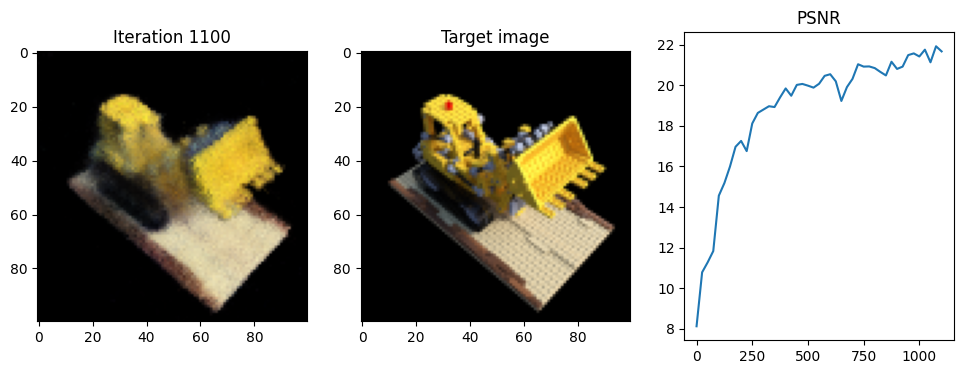

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.7933,  0.7935, -0.0128],
         [ 0.7965,  0.7871, -0.0128],
         [ 0.7997,  0.7806, -0.0128],
         ...,
         [ 1.1027,  0.1674, -0.0128],
         [ 1.1059,  0.1609, -0.0128],
         [ 1.1091,  0.1545, -0.0128]],

        [[ 0.7911,  0.7924, -0.0195],
         [ 0.7943,  0.7859, -0.0195],
         [ 0.7974,  0.7795, -0.0195],
         ...,
         [ 1.1004,  0.1663, -0.0195],
         [ 1.1036,  0.1598, -0.0195],
         [ 1.1068,  0.1533, -0.0195]],

        [[ 0.7888,  0.7913, -0.0262],
         [ 0.7920,  0.7848, -0.0262],
         [ 0.7952,  0.7784, -0.0262],
         ...,
         [ 1.0982,  0.1651, -0.0262],
         [ 1.1014,  0.1587, -0.0262],
         [ 1.1046,  0.1522, -0.0262]],

        ...,

        [[ 0.5742,  0.6852, -0.6670],
         [ 0.5774,  0.6788, -0.6670],
         [ 0.5806,  0.

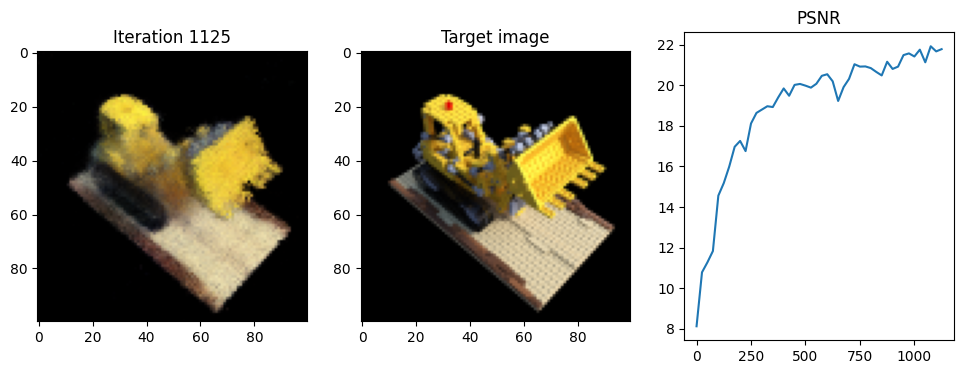

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1569, -0.9449, -0.5846],
         [ 0.1499, -0.9433, -0.5846],
         [ 0.1429, -0.9417, -0.5846],
         ...,
         [-0.5245, -0.7920, -0.5846],
         [-0.5315, -0.7904, -0.5846],
         [-0.5386, -0.7888, -0.5846]],

        [[ 0.1582, -0.9393, -0.5889],
         [ 0.1512, -0.9377, -0.5889],
         [ 0.1441, -0.9361, -0.5889],
         ...,
         [-0.5233, -0.7864, -0.5889],
         [-0.5303, -0.7848, -0.5889],
         [-0.5373, -0.7832, -0.5889]],

        [[ 0.1595, -0.9337, -0.5932],
         [ 0.1524, -0.9321, -0.5932],
         [ 0.1454, -0.9305, -0.5932],
         ...,
         [-0.5220, -0.7807, -0.5932],
         [-0.5290, -0.7792, -0.5932],
         [-0.5360, -0.7776, -0.5932]],

        ...,

        [[ 0.2793, -0.3995, -1.0033],
         [ 0.2723, -0.3979, -1.0033],
         [ 0.2653, -0.

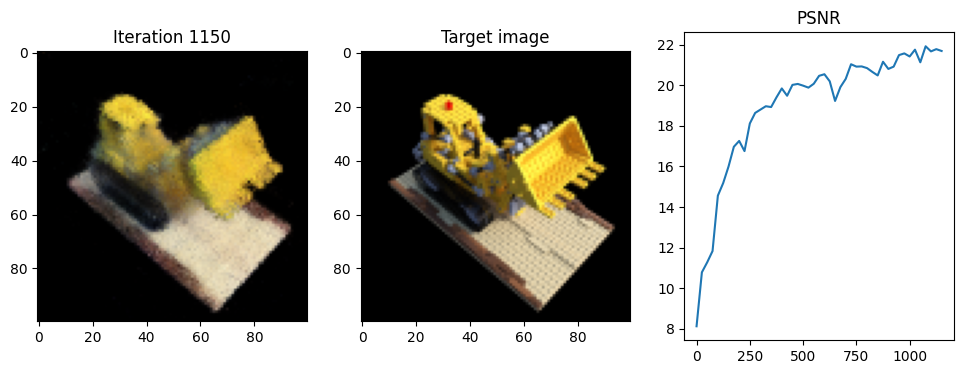

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1524,  1.1032, -0.1377],
         [ 0.1588,  1.0999, -0.1377],
         [ 0.1652,  1.0967, -0.1377],
         ...,
         [ 0.7762,  0.7891, -0.1377],
         [ 0.7826,  0.7859, -0.1377],
         [ 0.7890,  0.7826, -0.1377]],

        [[ 0.1509,  1.1002, -0.1441],
         [ 0.1573,  1.0970, -0.1441],
         [ 0.1638,  1.0938, -0.1441],
         ...,
         [ 0.7747,  0.7862, -0.1441],
         [ 0.7811,  0.7829, -0.1441],
         [ 0.7876,  0.7797, -0.1441]],

        [[ 0.1494,  1.0973, -0.1505],
         [ 0.1558,  1.0941, -0.1505],
         [ 0.1623,  1.0908, -0.1505],
         ...,
         [ 0.7732,  0.7832, -0.1505],
         [ 0.7796,  0.7800, -0.1505],
         [ 0.7861,  0.7768, -0.1505]],

        ...,

        [[ 0.0086,  0.8176, -0.7586],
         [ 0.0150,  0.8144, -0.7586],
         [ 0.0215,  0.

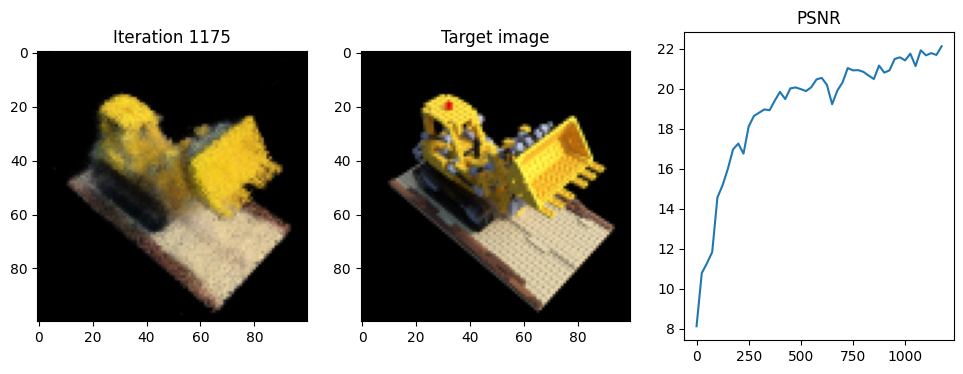

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3748, -1.0568,  0.0438],
         [ 0.3676, -1.0569,  0.0438],
         [ 0.3604, -1.0570,  0.0438],
         ...,
         [-0.3235, -1.0666,  0.0438],
         [-0.3307, -1.0667,  0.0438],
         [-0.3379, -1.0668,  0.0438]],

        [[ 0.3748, -1.0546,  0.0369],
         [ 0.3676, -1.0547,  0.0369],
         [ 0.3604, -1.0548,  0.0369],
         ...,
         [-0.3235, -1.0644,  0.0369],
         [-0.3307, -1.0645,  0.0369],
         [-0.3379, -1.0646,  0.0369]],

        [[ 0.3748, -1.0525,  0.0300],
         [ 0.3676, -1.0526,  0.0300],
         [ 0.3604, -1.0527,  0.0300],
         ...,
         [-0.3236, -1.0622,  0.0300],
         [-0.3308, -1.0623,  0.0300],
         [-0.3380, -1.0624,  0.0300]],

        ...,

        [[ 0.3719, -0.8475, -0.6225],
         [ 0.3647, -0.8476, -0.6225],
         [ 0.3575, -0.

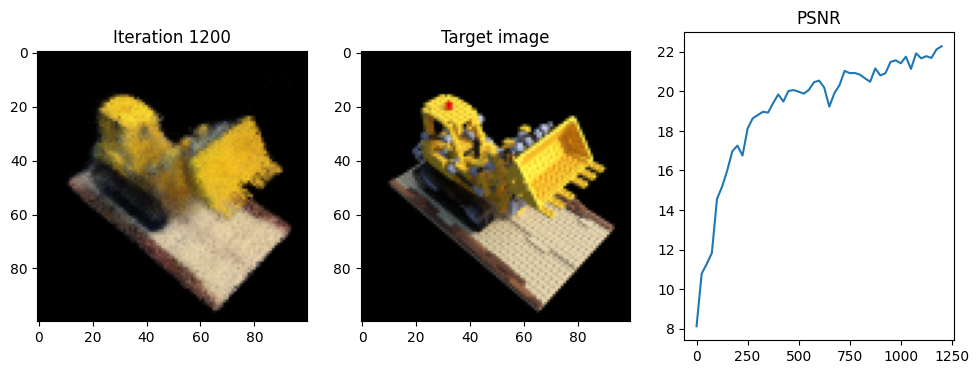

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0801e+00, -1.7659e-01, -2.4786e-01],
         [ 1.0767e+00, -1.8292e-01, -2.4786e-01],
         [ 1.0732e+00, -1.8924e-01, -2.4786e-01],
         ...,
         [ 7.4695e-01, -7.9041e-01, -2.4786e-01],
         [ 7.4351e-01, -7.9674e-01, -2.4786e-01],
         [ 7.4008e-01, -8.0307e-01, -2.4786e-01]],

        [[ 1.0766e+00, -1.7470e-01, -2.5387e-01],
         [ 1.0732e+00, -1.8103e-01, -2.5387e-01],
         [ 1.0697e+00, -1.8736e-01, -2.5387e-01],
         ...,
         [ 7.4347e-01, -7.8853e-01, -2.5387e-01],
         [ 7.4004e-01, -7.9486e-01, -2.5387e-01],
         [ 7.3661e-01, -8.0118e-01, -2.5387e-01]],

        [[ 1.0731e+00, -1.7282e-01, -2.5989e-01],
         [ 1.0697e+00, -1.7915e-01, -2.5989e-01],
         [ 1.0663e+00, -1.8547e-01, -2.5989e-01],
         ...,
         [ 7.4000e-01, -7.8664e-01, -2.5989e-01]

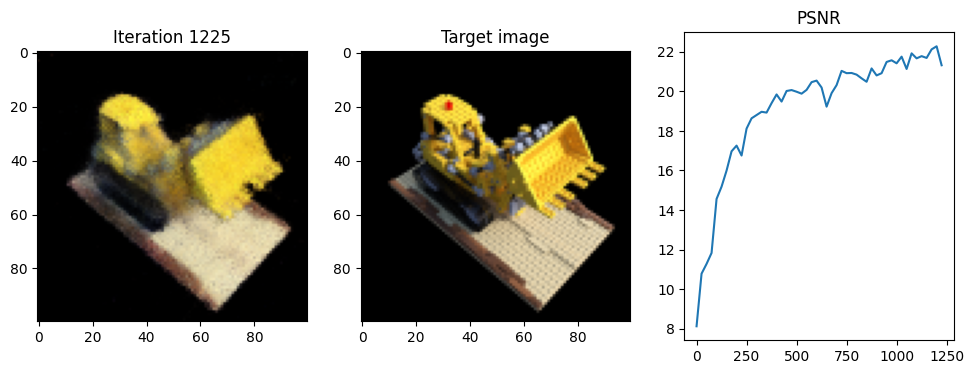

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0078,  0.4466, -0.2097],
         [ 1.0085,  0.4395, -0.2097],
         [ 1.0091,  0.4323, -0.2097],
         ...,
         [ 1.0668, -0.2493, -0.2097],
         [ 1.0674, -0.2564, -0.2097],
         [ 1.0680, -0.2636, -0.2097]],

        [[ 1.0041,  0.4463, -0.2158],
         [ 1.0047,  0.4392, -0.2158],
         [ 1.0053,  0.4320, -0.2158],
         ...,
         [ 1.0631, -0.2496, -0.2158],
         [ 1.0637, -0.2568, -0.2158],
         [ 1.0643, -0.2639, -0.2158]],

        [[ 1.0004,  0.4460, -0.2220],
         [ 1.0010,  0.4388, -0.2220],
         [ 1.0016,  0.4317, -0.2220],
         ...,
         [ 1.0594, -0.2499, -0.2220],
         [ 1.0600, -0.2571, -0.2220],
         [ 1.0606, -0.2642, -0.2220]],

        ...,

        [[ 0.6476,  0.4161, -0.8072],
         [ 0.6482,  0.4090, -0.8072],
         [ 0.6488,  0.

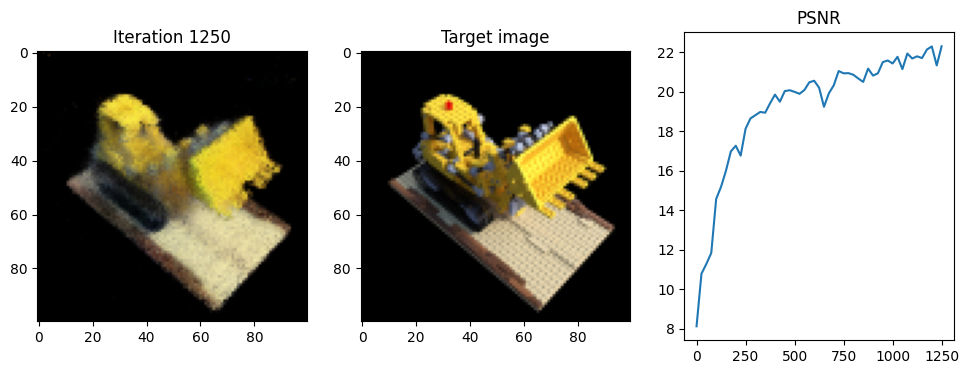

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.8225,  0.3084, -0.6982],
         [ 0.8221,  0.3012, -0.6982],
         [ 0.8216,  0.2940, -0.6982],
         ...,
         [ 0.7782, -0.3886, -0.6982],
         [ 0.7777, -0.3958, -0.6982],
         [ 0.7773, -0.4030, -0.6982]],

        [[ 0.8162,  0.3088, -0.7017],
         [ 0.8158,  0.3016, -0.7017],
         [ 0.8153,  0.2944, -0.7017],
         ...,
         [ 0.7719, -0.3882, -0.7017],
         [ 0.7715, -0.3954, -0.7017],
         [ 0.7710, -0.4026, -0.7017]],

        [[ 0.8100,  0.3092, -0.7052],
         [ 0.8095,  0.3020, -0.7052],
         [ 0.8091,  0.2948, -0.7052],
         ...,
         [ 0.7656, -0.3878, -0.7052],
         [ 0.7652, -0.3950, -0.7052],
         [ 0.7647, -0.4022, -0.7052]],

        ...,

        [[ 0.2137,  0.3471, -1.0382],
         [ 0.2132,  0.3399, -1.0382],
         [ 0.2128,  0.

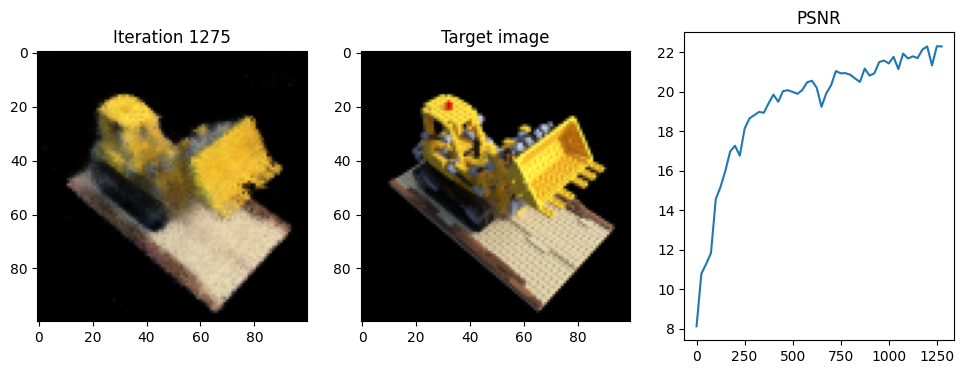

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.6349,  0.9245,  0.0377],
         [-0.6279,  0.9265,  0.0377],
         [-0.6210,  0.9284,  0.0377],
         ...,
         [ 0.0373,  1.1141,  0.0377],
         [ 0.0442,  1.1161,  0.0377],
         [ 0.0512,  1.1180,  0.0377]],

        [[-0.6343,  0.9224,  0.0308],
         [-0.6273,  0.9244,  0.0308],
         [-0.6204,  0.9263,  0.0308],
         ...,
         [ 0.0379,  1.1120,  0.0308],
         [ 0.0448,  1.1140,  0.0308],
         [ 0.0517,  1.1159,  0.0308]],

        [[-0.6337,  0.9203,  0.0239],
         [-0.6267,  0.9222,  0.0239],
         [-0.6198,  0.9242,  0.0239],
         ...,
         [ 0.0385,  1.1099,  0.0239],
         [ 0.0454,  1.1119,  0.0239],
         [ 0.0523,  1.1138,  0.0239]],

        ...,

        [[-0.5770,  0.7194, -0.6274],
         [-0.5701,  0.7213, -0.6274],
         [-0.5631,  0.

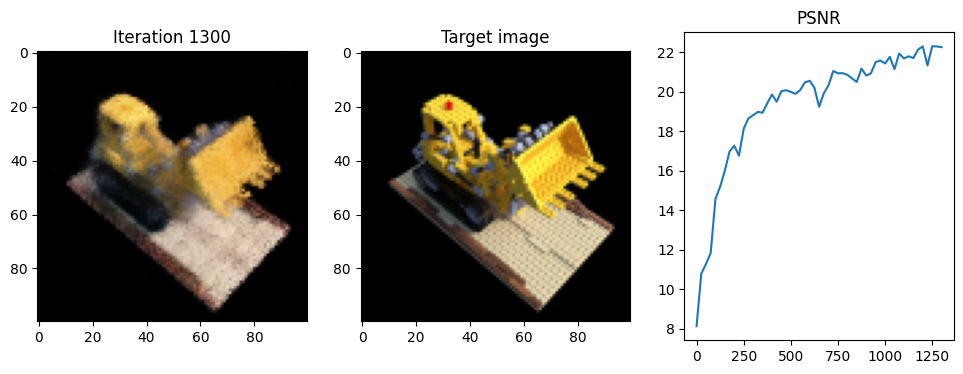

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9254,  0.5921, -0.2285],
         [-0.9197,  0.5966, -0.2285],
         [-0.9141,  0.6010, -0.2285],
         ...,
         [-0.3770,  1.0246, -0.2285],
         [-0.3713,  1.0290, -0.2285],
         [-0.3657,  1.0335, -0.2285]],

        [[-0.9230,  0.5891, -0.2346],
         [-0.9174,  0.5936, -0.2346],
         [-0.9117,  0.5980, -0.2346],
         ...,
         [-0.3746,  1.0216, -0.2346],
         [-0.3690,  1.0260, -0.2346],
         [-0.3633,  1.0305, -0.2346]],

        [[-0.9206,  0.5861, -0.2407],
         [-0.9150,  0.5906, -0.2407],
         [-0.9093,  0.5950, -0.2407],
         ...,
         [-0.3722,  1.0186, -0.2407],
         [-0.3666,  1.0230, -0.2407],
         [-0.3609,  1.0275, -0.2407]],

        ...,

        [[-0.6948,  0.2998, -0.8194],
         [-0.6892,  0.3042, -0.8194],
         [-0.6835,  0.

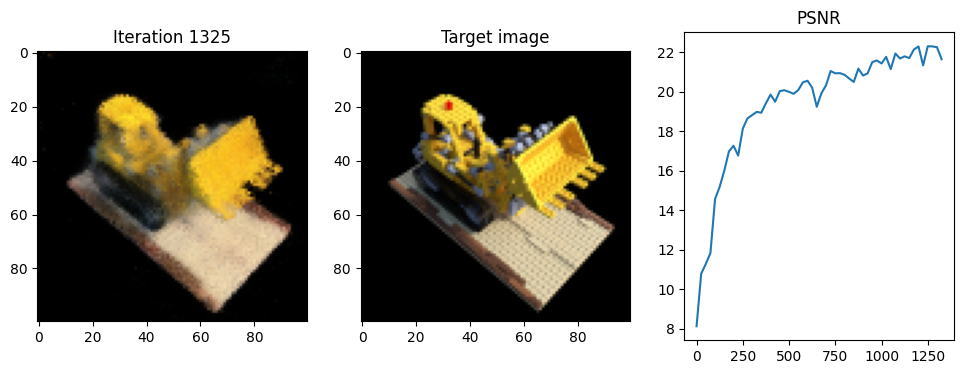

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8817,  0.4899, -0.4916],
         [-0.8762,  0.4945, -0.4916],
         [-0.8707,  0.4992, -0.4916],
         ...,
         [-0.3470,  0.9391, -0.4916],
         [-0.3415,  0.9438, -0.4916],
         [-0.3360,  0.9484, -0.4916]],

        [[-0.8783,  0.4859, -0.4965],
         [-0.8728,  0.4905, -0.4965],
         [-0.8673,  0.4951, -0.4965],
         ...,
         [-0.3436,  0.9351, -0.4965],
         [-0.3381,  0.9397, -0.4965],
         [-0.3326,  0.9443, -0.4965]],

        [[-0.8749,  0.4818, -0.5014],
         [-0.8694,  0.4864, -0.5014],
         [-0.8639,  0.4911, -0.5014],
         ...,
         [-0.3402,  0.9310, -0.5014],
         [-0.3347,  0.9357, -0.5014],
         [-0.3292,  0.9403, -0.5014]],

        ...,

        [[-0.5513,  0.0966, -0.9648],
         [-0.5458,  0.1012, -0.9648],
         [-0.5403,  0.

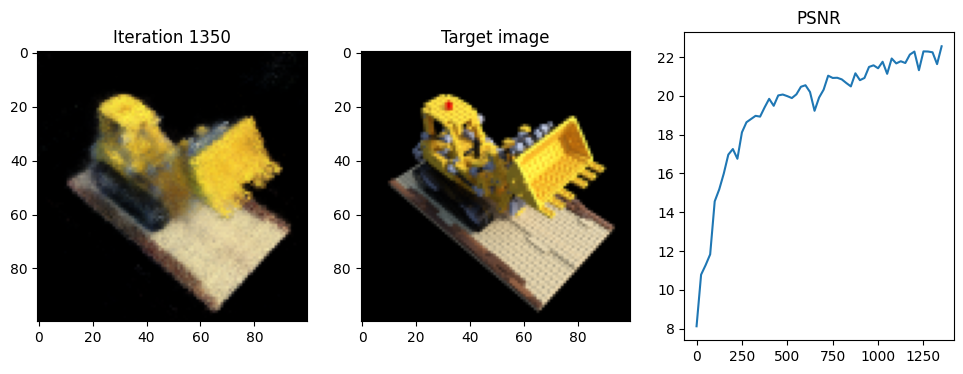

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5890,  0.8088, -0.5081],
         [-0.5820,  0.8107, -0.5081],
         [-0.5751,  0.8125, -0.5081],
         ...,
         [ 0.0857,  0.9892, -0.5081],
         [ 0.0927,  0.9911, -0.5081],
         [ 0.0996,  0.9930, -0.5081]],

        [[-0.5876,  0.8036, -0.5129],
         [-0.5806,  0.8055, -0.5129],
         [-0.5737,  0.8073, -0.5129],
         ...,
         [ 0.0871,  0.9841, -0.5129],
         [ 0.0941,  0.9859, -0.5129],
         [ 0.1010,  0.9878, -0.5129]],

        [[-0.5862,  0.7984, -0.5177],
         [-0.5792,  0.8003, -0.5177],
         [-0.5723,  0.8021, -0.5177],
         ...,
         [ 0.0885,  0.9789, -0.5177],
         [ 0.0954,  0.9807, -0.5177],
         [ 0.1024,  0.9826, -0.5177]],

        ...,

        [[-0.4541,  0.3046, -0.9722],
         [-0.4472,  0.3065, -0.9722],
         [-0.4402,  0.

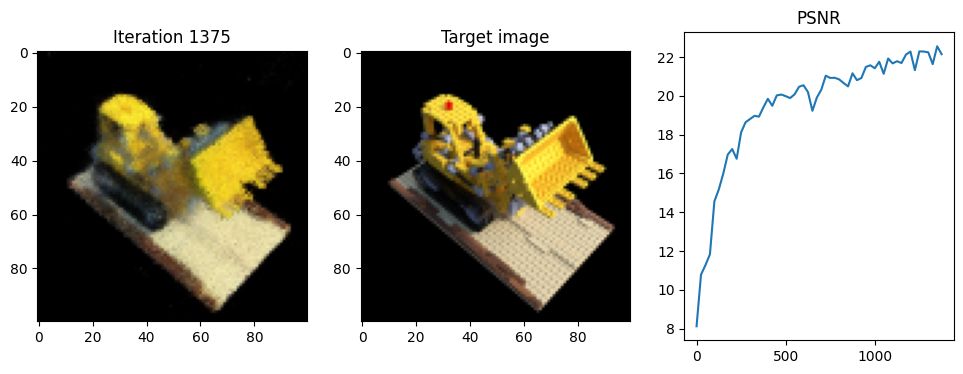

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8817,  0.4899, -0.4916],
         [-0.8762,  0.4945, -0.4916],
         [-0.8707,  0.4992, -0.4916],
         ...,
         [-0.3470,  0.9391, -0.4916],
         [-0.3415,  0.9438, -0.4916],
         [-0.3360,  0.9484, -0.4916]],

        [[-0.8783,  0.4859, -0.4965],
         [-0.8728,  0.4905, -0.4965],
         [-0.8673,  0.4951, -0.4965],
         ...,
         [-0.3436,  0.9351, -0.4965],
         [-0.3381,  0.9397, -0.4965],
         [-0.3326,  0.9443, -0.4965]],

        [[-0.8749,  0.4818, -0.5014],
         [-0.8694,  0.4864, -0.5014],
         [-0.8639,  0.4911, -0.5014],
         ...,
         [-0.3402,  0.9310, -0.5014],
         [-0.3347,  0.9357, -0.5014],
         [-0.3292,  0.9403, -0.5014]],

        ...,

        [[-0.5513,  0.0966, -0.9648],
         [-0.5458,  0.1012, -0.9648],
         [-0.5403,  0.

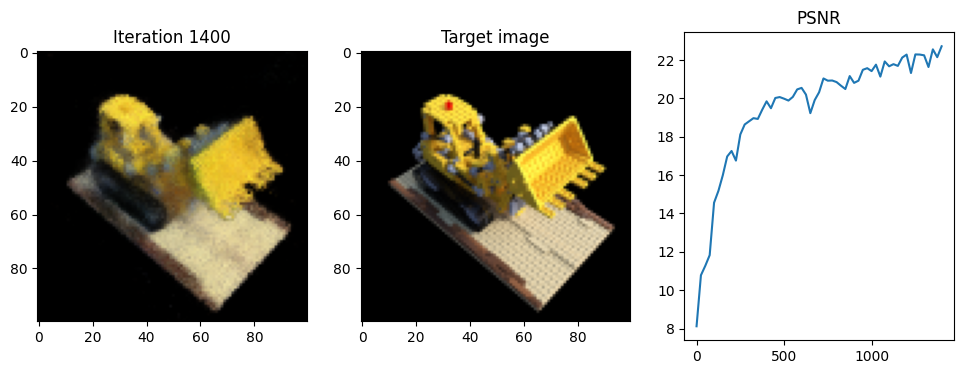

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5617, -0.9538,  0.1844],
         [ 0.5546, -0.9552,  0.1844],
         [ 0.5476, -0.9567,  0.1844],
         ...,
         [-0.1227, -1.0932,  0.1844],
         [-0.1297, -1.0946,  0.1844],
         [-0.1368, -1.0961,  0.1844]],

        [[ 0.5614, -0.9526,  0.1773],
         [ 0.5544, -0.9540,  0.1773],
         [ 0.5473, -0.9555,  0.1773],
         ...,
         [-0.1229, -1.0920,  0.1773],
         [-0.1300, -1.0934,  0.1773],
         [-0.1370, -1.0949,  0.1773]],

        [[ 0.5612, -0.9514,  0.1702],
         [ 0.5541, -0.9528,  0.1702],
         [ 0.5471, -0.9543,  0.1702],
         ...,
         [-0.1232, -1.0908,  0.1702],
         [-0.1302, -1.0922,  0.1702],
         [-0.1373, -1.0937,  0.1702]],

        ...,

        [[ 0.5379, -0.8372, -0.5038],
         [ 0.5309, -0.8386, -0.5038],
         [ 0.5238, -0.

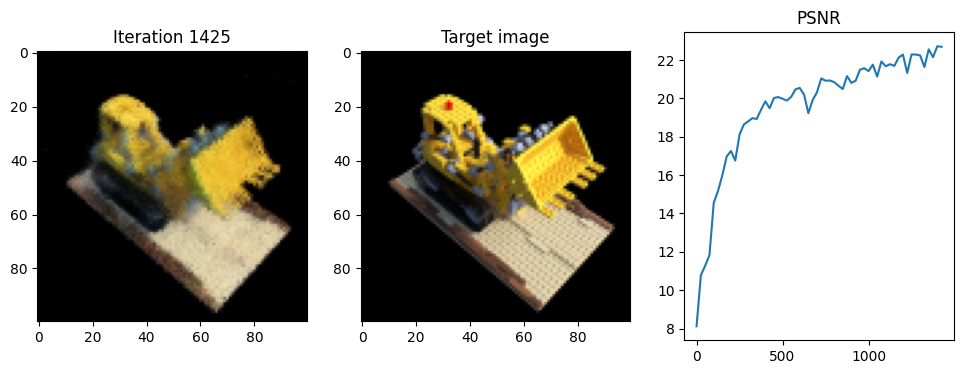

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.6503, -0.0133, -0.9144],
         [ 0.6462, -0.0192, -0.9144],
         [ 0.6421, -0.0251, -0.9144],
         ...,
         [ 0.2519, -0.5869, -0.9144],
         [ 0.2478, -0.5928, -0.9144],
         [ 0.2437, -0.5988, -0.9144]],

        [[ 0.6445, -0.0092, -0.9158],
         [ 0.6404, -0.0151, -0.9158],
         [ 0.6363, -0.0211, -0.9158],
         ...,
         [ 0.2461, -0.5829, -0.9158],
         [ 0.2420, -0.5888, -0.9158],
         [ 0.2379, -0.5947, -0.9158]],

        [[ 0.6387, -0.0052, -0.9171],
         [ 0.6346, -0.0111, -0.9171],
         [ 0.6304, -0.0170, -0.9171],
         ...,
         [ 0.2403, -0.5789, -0.9171],
         [ 0.2362, -0.5848, -0.9171],
         [ 0.2321, -0.5907, -0.9171]],

        ...,

        [[ 0.0869,  0.3780, -1.0458],
         [ 0.0828,  0.3721, -1.0458],
         [ 0.0787,  0.

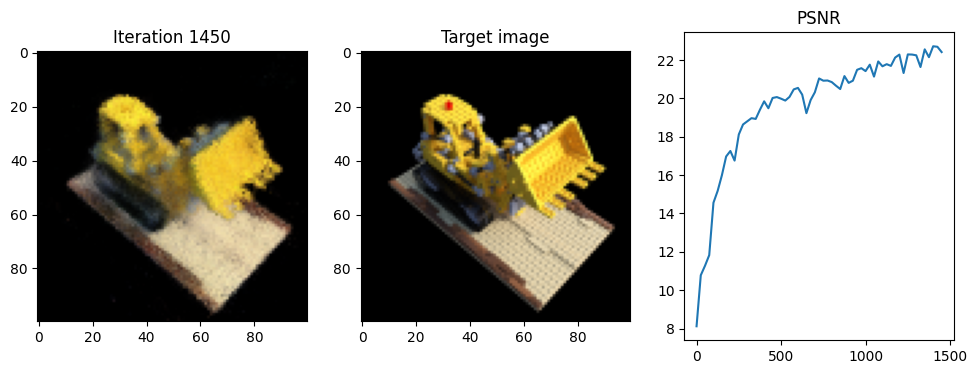

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8685,  0.4267, -0.5682],
         [-0.8631,  0.4315, -0.5682],
         [-0.8578,  0.4363, -0.5682],
         ...,
         [-0.3495,  0.8939, -0.5682],
         [-0.3441,  0.8988, -0.5682],
         [-0.3387,  0.9036, -0.5682]],

        [[-0.8647,  0.4224, -0.5726],
         [-0.8593,  0.4273, -0.5726],
         [-0.8540,  0.4321, -0.5726],
         ...,
         [-0.3456,  0.8897, -0.5726],
         [-0.3403,  0.8945, -0.5726],
         [-0.3349,  0.8994, -0.5726]],

        [[-0.8609,  0.4182, -0.5771],
         [-0.8555,  0.4230, -0.5771],
         [-0.8502,  0.4278, -0.5771],
         ...,
         [-0.3418,  0.8855, -0.5771],
         [-0.3365,  0.8903, -0.5771],
         [-0.3311,  0.8951, -0.5771]],

        ...,

        [[-0.4997,  0.0170, -0.9971],
         [-0.4943,  0.0218, -0.9971],
         [-0.4890,  0.

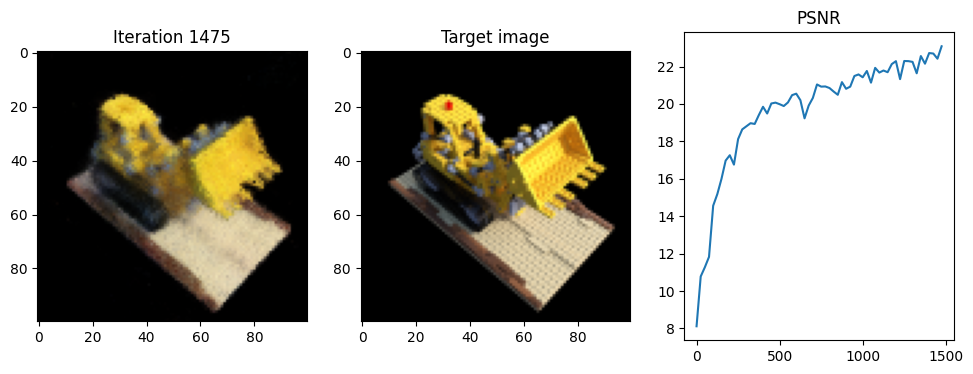

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0867,  0.2079,  0.1874],
         [ 1.0856,  0.2008,  0.1874],
         [ 1.0846,  0.1937,  0.1874],
         ...,
         [ 0.9876, -0.4834,  0.1874],
         [ 0.9866, -0.4905,  0.1874],
         [ 0.9855, -0.4976,  0.1874]],

        [[ 1.0855,  0.2081,  0.1803],
         [ 1.0845,  0.2010,  0.1803],
         [ 1.0834,  0.1939,  0.1803],
         ...,
         [ 0.9864, -0.4832,  0.1803],
         [ 0.9854, -0.4903,  0.1803],
         [ 0.9844, -0.4975,  0.1803]],

        [[ 1.0843,  0.2083,  0.1732],
         [ 1.0833,  0.2012,  0.1732],
         [ 1.0822,  0.1940,  0.1732],
         ...,
         [ 0.9852, -0.4830,  0.1732],
         [ 0.9842, -0.4902,  0.1732],
         [ 0.9832, -0.4973,  0.1732]],

        ...,

        [[ 0.9708,  0.2245, -0.5012],
         [ 0.9698,  0.2174, -0.5012],
         [ 0.9688,  0.

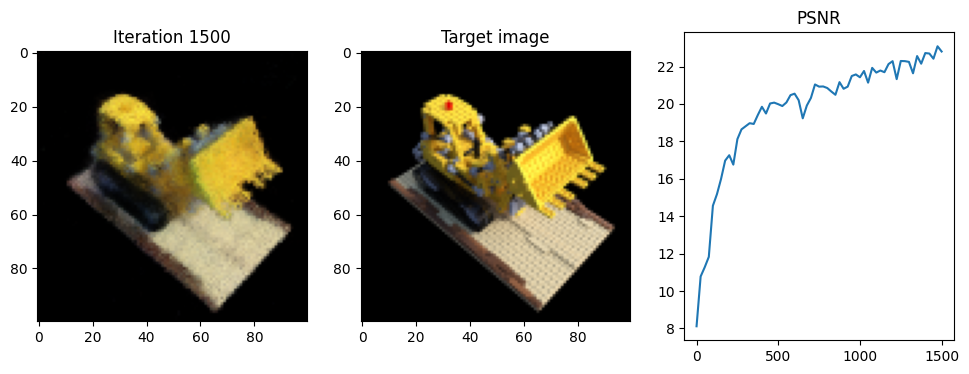

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0267, -0.4404,  0.1056],
         [ 1.0219, -0.4457,  0.1056],
         [ 1.0171, -0.4511,  0.1056],
         ...,
         [ 0.5593, -0.9593,  0.1056],
         [ 0.5544, -0.9646,  0.1056],
         [ 0.5496, -0.9700,  0.1056]],

        [[ 1.0254, -0.4392,  0.0986],
         [ 1.0206, -0.4446,  0.0986],
         [ 1.0158, -0.4499,  0.0986],
         ...,
         [ 0.5580, -0.9581,  0.0986],
         [ 0.5531, -0.9634,  0.0986],
         [ 0.5483, -0.9688,  0.0986]],

        [[ 1.0241, -0.4380,  0.0916],
         [ 1.0193, -0.4434,  0.0916],
         [ 1.0145, -0.4487,  0.0916],
         ...,
         [ 0.5567, -0.9569,  0.0916],
         [ 0.5518, -0.9623,  0.0916],
         [ 0.5470, -0.9676,  0.0916]],

        ...,

        [[ 0.9003, -0.3265, -0.5718],
         [ 0.8955, -0.3319, -0.5718],
         [ 0.8907, -0.

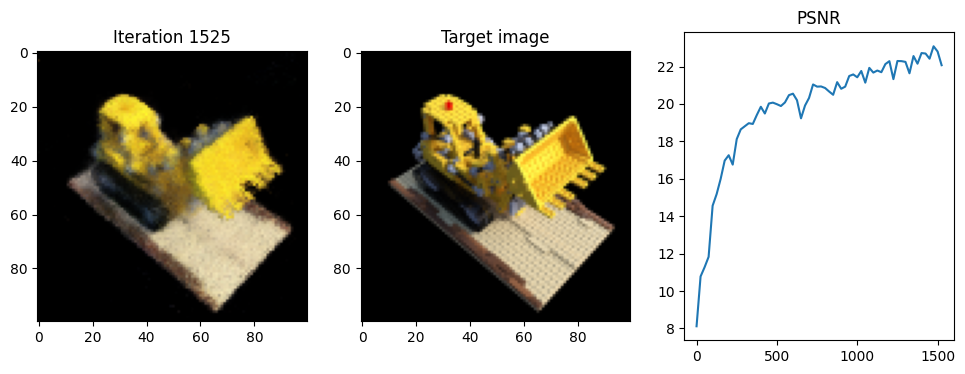

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.4688,  0.5562, -0.8544],
         [-0.4617,  0.5575, -0.8544],
         [-0.4547,  0.5588, -0.8544],
         ...,
         [ 0.2180,  0.6830, -0.8544],
         [ 0.2250,  0.6843, -0.8544],
         [ 0.2321,  0.6856, -0.8544]],

        [[-0.4676,  0.5494, -0.8565],
         [-0.4605,  0.5507, -0.8565],
         [-0.4534,  0.5520, -0.8565],
         ...,
         [ 0.2192,  0.6762, -0.8565],
         [ 0.2263,  0.6776, -0.8565],
         [ 0.2334,  0.6789, -0.8565]],

        [[-0.4663,  0.5426, -0.8586],
         [-0.4592,  0.5439, -0.8586],
         [-0.4522,  0.5452, -0.8586],
         ...,
         [ 0.2205,  0.6695, -0.8586],
         [ 0.2275,  0.6708, -0.8586],
         [ 0.2346,  0.6721, -0.8586]],

        ...,

        [[-0.3473, -0.1017, -1.0551],
         [-0.3402, -0.1004, -1.0551],
         [-0.3331, -0.

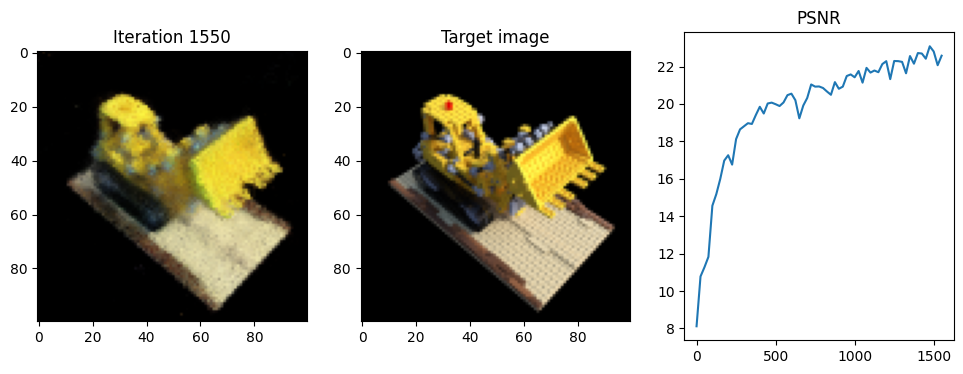

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.6349,  0.9245,  0.0377],
         [-0.6279,  0.9265,  0.0377],
         [-0.6210,  0.9284,  0.0377],
         ...,
         [ 0.0373,  1.1141,  0.0377],
         [ 0.0442,  1.1161,  0.0377],
         [ 0.0512,  1.1180,  0.0377]],

        [[-0.6343,  0.9224,  0.0308],
         [-0.6273,  0.9244,  0.0308],
         [-0.6204,  0.9263,  0.0308],
         ...,
         [ 0.0379,  1.1120,  0.0308],
         [ 0.0448,  1.1140,  0.0308],
         [ 0.0517,  1.1159,  0.0308]],

        [[-0.6337,  0.9203,  0.0239],
         [-0.6267,  0.9222,  0.0239],
         [-0.6198,  0.9242,  0.0239],
         ...,
         [ 0.0385,  1.1099,  0.0239],
         [ 0.0454,  1.1119,  0.0239],
         [ 0.0523,  1.1138,  0.0239]],

        ...,

        [[-0.5770,  0.7194, -0.6274],
         [-0.5701,  0.7213, -0.6274],
         [-0.5631,  0.

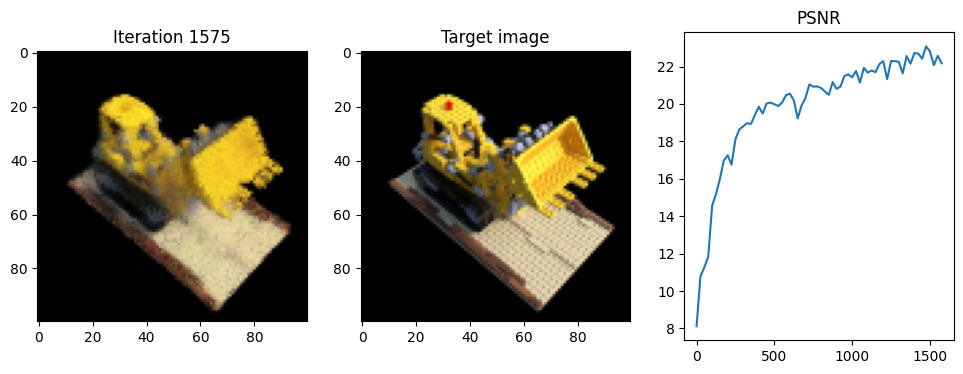

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.7117,  0.8574,  0.1322],
         [ 0.7155,  0.8513,  0.1322],
         [ 0.7192,  0.8452,  0.1322],
         ...,
         [ 1.0762,  0.2617,  0.1322],
         [ 1.0799,  0.2555,  0.1322],
         [ 1.0837,  0.2494,  0.1322]],

        [[ 0.7104,  0.8566,  0.1252],
         [ 0.7141,  0.8505,  0.1252],
         [ 0.7179,  0.8443,  0.1252],
         ...,
         [ 1.0748,  0.2609,  0.1252],
         [ 1.0786,  0.2547,  0.1252],
         [ 1.0823,  0.2486,  0.1252]],

        [[ 0.7090,  0.8558,  0.1182],
         [ 0.7128,  0.8496,  0.1182],
         [ 0.7165,  0.8435,  0.1182],
         ...,
         [ 1.0735,  0.2600,  0.1182],
         [ 1.0772,  0.2539,  0.1182],
         [ 1.0810,  0.2478,  0.1182]],

        ...,

        [[ 0.5812,  0.7776, -0.5492],
         [ 0.5850,  0.7715, -0.5492],
         [ 0.5887,  0.

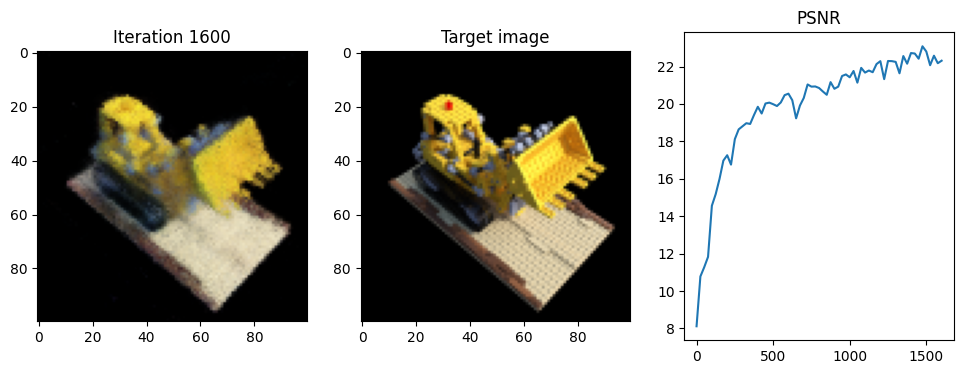

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5438,  0.7250, -0.6617],
         [ 0.5473,  0.7188, -0.6617],
         [ 0.5509,  0.7125, -0.6617],
         ...,
         [ 0.8901,  0.1186, -0.6617],
         [ 0.8936,  0.1123, -0.6617],
         [ 0.8972,  0.1060, -0.6617]],

        [[ 0.5384,  0.7220, -0.6655],
         [ 0.5420,  0.7158, -0.6655],
         [ 0.5456,  0.7095, -0.6655],
         ...,
         [ 0.8848,  0.1155, -0.6655],
         [ 0.8883,  0.1093, -0.6655],
         [ 0.8919,  0.1030, -0.6655]],

        [[ 0.5331,  0.7190, -0.6692],
         [ 0.5367,  0.7127, -0.6692],
         [ 0.5403,  0.7065, -0.6692],
         ...,
         [ 0.8794,  0.1125, -0.6692],
         [ 0.8830,  0.1062, -0.6692],
         [ 0.8866,  0.1000, -0.6692]],

        ...,

        [[ 0.0277,  0.4304, -1.0286],
         [ 0.0313,  0.4241, -1.0286],
         [ 0.0349,  0.

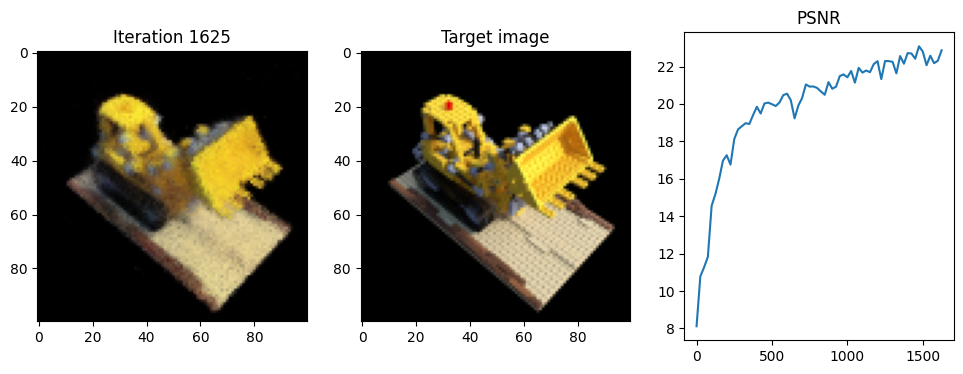

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3299, -0.8127, -0.6999],
         [ 0.3227, -0.8125, -0.6999],
         [ 0.3155, -0.8122, -0.6999],
         ...,
         [-0.3680, -0.7867, -0.6999],
         [-0.3752, -0.7864, -0.6999],
         [-0.3824, -0.7862, -0.6999]],

        [[ 0.3301, -0.8064, -0.7034],
         [ 0.3230, -0.8062, -0.7034],
         [ 0.3158, -0.8059, -0.7034],
         ...,
         [-0.3678, -0.7804, -0.7034],
         [-0.3750, -0.7801, -0.7034],
         [-0.3822, -0.7799, -0.7034]],

        [[ 0.3304, -0.8002, -0.7068],
         [ 0.3232, -0.7999, -0.7068],
         [ 0.3160, -0.7996, -0.7068],
         ...,
         [-0.3675, -0.7741, -0.7068],
         [-0.3747, -0.7738, -0.7068],
         [-0.3819, -0.7736, -0.7068]],

        ...,

        [[ 0.3527, -0.2024, -1.0386],
         [ 0.3455, -0.2022, -1.0386],
         [ 0.3383, -0.

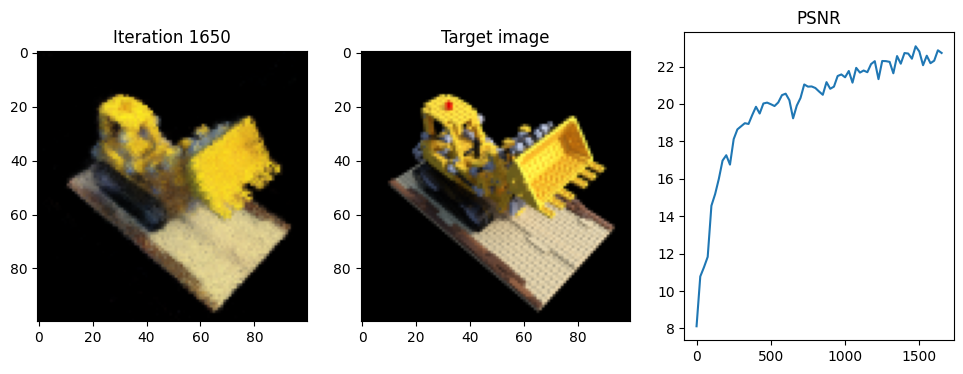

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.0879,  0.1496,  0.2307],
         [-1.0847,  0.1560,  0.2307],
         [-1.0814,  0.1624,  0.2307],
         ...,
         [-0.7712,  0.7721,  0.2307],
         [-0.7680,  0.7785,  0.2307],
         [-0.7647,  0.7849,  0.2307]],

        [[-1.0871,  0.1492,  0.2235],
         [-1.0839,  0.1556,  0.2235],
         [-1.0806,  0.1620,  0.2235],
         ...,
         [-0.7704,  0.7717,  0.2235],
         [-0.7672,  0.7781,  0.2235],
         [-0.7639,  0.7845,  0.2235]],

        [[-1.0863,  0.1488,  0.2164],
         [-1.0830,  0.1552,  0.2164],
         [-1.0798,  0.1616,  0.2164],
         ...,
         [-0.7696,  0.7713,  0.2164],
         [-0.7663,  0.7777,  0.2164],
         [-0.7631,  0.7841,  0.2164]],

        ...,

        [[-1.0092,  0.1096, -0.4621],
         [-1.0060,  0.1160, -0.4621],
         [-1.0027,  0.

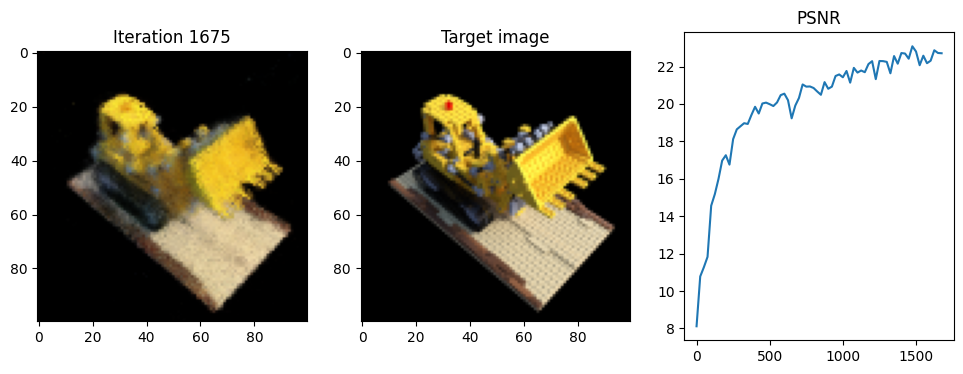

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1569, -0.9449, -0.5846],
         [ 0.1499, -0.9433, -0.5846],
         [ 0.1429, -0.9417, -0.5846],
         ...,
         [-0.5245, -0.7920, -0.5846],
         [-0.5315, -0.7904, -0.5846],
         [-0.5386, -0.7888, -0.5846]],

        [[ 0.1582, -0.9393, -0.5889],
         [ 0.1512, -0.9377, -0.5889],
         [ 0.1441, -0.9361, -0.5889],
         ...,
         [-0.5233, -0.7864, -0.5889],
         [-0.5303, -0.7848, -0.5889],
         [-0.5373, -0.7832, -0.5889]],

        [[ 0.1595, -0.9337, -0.5932],
         [ 0.1524, -0.9321, -0.5932],
         [ 0.1454, -0.9305, -0.5932],
         ...,
         [-0.5220, -0.7807, -0.5932],
         [-0.5290, -0.7792, -0.5932],
         [-0.5360, -0.7776, -0.5932]],

        ...,

        [[ 0.2793, -0.3995, -1.0033],
         [ 0.2723, -0.3979, -1.0033],
         [ 0.2653, -0.

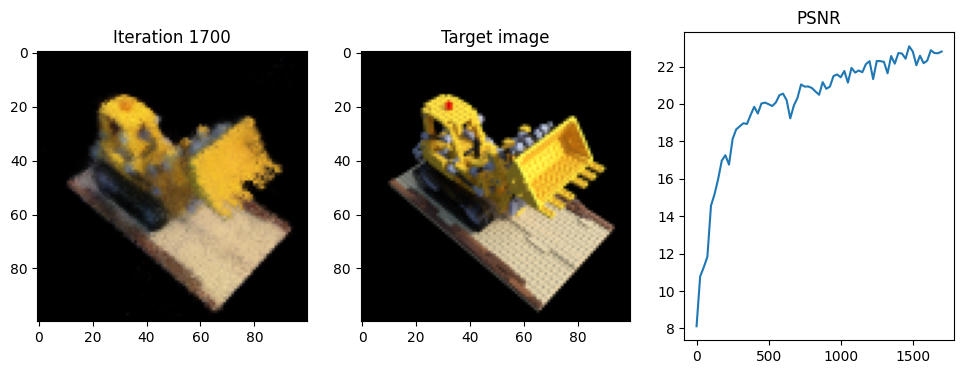

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.7139,  0.2524, -0.8282],
         [ 0.7127,  0.2453, -0.8282],
         [ 0.7116,  0.2382, -0.8282],
         ...,
         [ 0.6056, -0.4376, -0.8282],
         [ 0.6045, -0.4447, -0.8282],
         [ 0.6034, -0.4518, -0.8282]],

        [[ 0.7071,  0.2535, -0.8305],
         [ 0.7060,  0.2463, -0.8305],
         [ 0.7049,  0.2392, -0.8305],
         ...,
         [ 0.5989, -0.4365, -0.8305],
         [ 0.5978, -0.4436, -0.8305],
         [ 0.5966, -0.4507, -0.8305]],

        [[ 0.7004,  0.2545, -0.8329],
         [ 0.6993,  0.2474, -0.8329],
         [ 0.6982,  0.2403, -0.8329],
         ...,
         [ 0.5921, -0.4355, -0.8329],
         [ 0.5910, -0.4426, -0.8329],
         [ 0.5899, -0.4497, -0.8329]],

        ...,

        [[ 0.0615,  0.3548, -1.0557],
         [ 0.0604,  0.3476, -1.0557],
         [ 0.0593,  0.

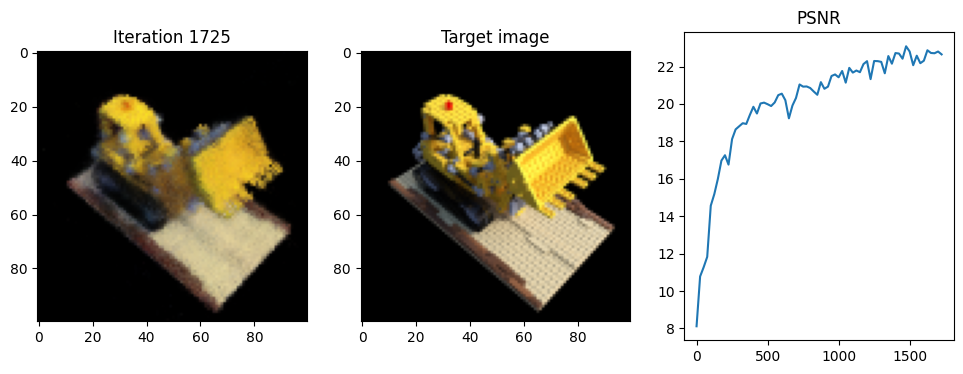

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 8.0956e-03,  8.6263e-01, -7.1763e-01],
         [ 1.4610e-02,  8.5957e-01, -7.1763e-01],
         [ 2.1125e-02,  8.5650e-01, -7.1763e-01],
         ...,
         [ 6.4001e-01,  5.6524e-01, -7.1763e-01],
         [ 6.4653e-01,  5.6218e-01, -7.1763e-01],
         [ 6.5304e-01,  5.5911e-01, -7.1763e-01]],

        [[ 5.3818e-03,  8.5687e-01, -7.2098e-01],
         [ 1.1896e-02,  8.5380e-01, -7.2098e-01],
         [ 1.8411e-02,  8.5073e-01, -7.2098e-01],
         ...,
         [ 6.3730e-01,  5.5947e-01, -7.2098e-01],
         [ 6.4381e-01,  5.5641e-01, -7.2098e-01],
         [ 6.5033e-01,  5.5334e-01, -7.2098e-01]],

        [[ 2.6680e-03,  8.5110e-01, -7.2433e-01],
         [ 9.1826e-03,  8.4803e-01, -7.2433e-01],
         [ 1.5697e-02,  8.4497e-01, -7.2433e-01],
         ...,
         [ 6.3459e-01,  5.5371e-01, -7.2433e-01]

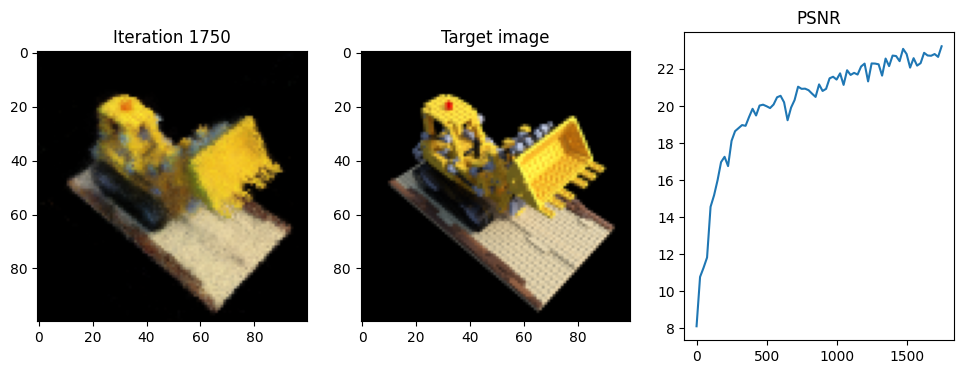

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9326,  0.6240,  0.0122],
         [-0.9269,  0.6284,  0.0122],
         [-0.9211,  0.6328,  0.0122],
         ...,
         [-0.3785,  1.0492,  0.0122],
         [-0.3728,  1.0535,  0.0122],
         [-0.3671,  1.0579,  0.0122]],

        [[-0.9311,  0.6221,  0.0054],
         [-0.9254,  0.6265,  0.0054],
         [-0.9197,  0.6309,  0.0054],
         ...,
         [-0.3770,  1.0473,  0.0054],
         [-0.3713,  1.0517,  0.0054],
         [-0.3656,  1.0560,  0.0054]],

        [[-0.9297,  0.6203, -0.0014],
         [-0.9240,  0.6246, -0.0014],
         [-0.9183,  0.6290, -0.0014],
         ...,
         [-0.3756,  1.0454, -0.0014],
         [-0.3699,  1.0498, -0.0014],
         [-0.3642,  1.0542, -0.0014]],

        ...,

        [[-0.7932,  0.4423, -0.6476],
         [-0.7875,  0.4467, -0.6476],
         [-0.7817,  0.

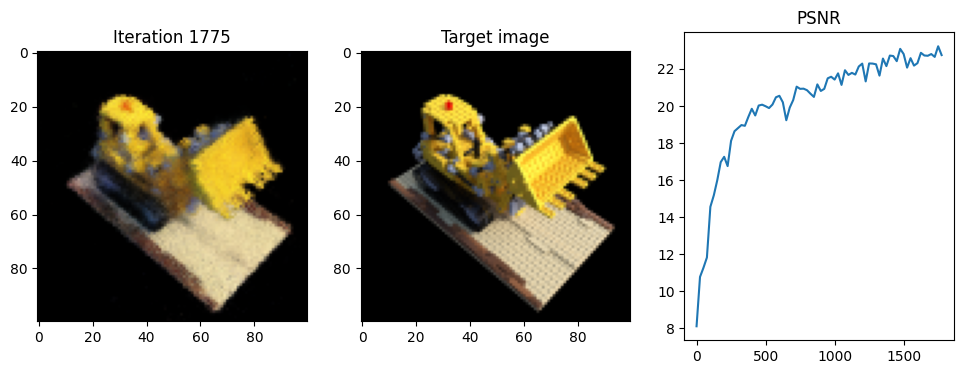

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.3682,  0.6250, -0.8561],
         [-0.3610,  0.6251, -0.8561],
         [-0.3538,  0.6252, -0.8561],
         ...,
         [ 0.3302,  0.6341, -0.8561],
         [ 0.3374,  0.6342, -0.8561],
         [ 0.3446,  0.6343, -0.8561]],

        [[-0.3681,  0.6181, -0.8582],
         [-0.3609,  0.6182, -0.8582],
         [-0.3537,  0.6183, -0.8582],
         ...,
         [ 0.3303,  0.6272, -0.8582],
         [ 0.3375,  0.6273, -0.8582],
         [ 0.3447,  0.6274, -0.8582]],

        [[-0.3680,  0.6112, -0.8602],
         [-0.3608,  0.6113, -0.8602],
         [-0.3536,  0.6114, -0.8602],
         ...,
         [ 0.3304,  0.6203, -0.8602],
         [ 0.3376,  0.6204, -0.8602],
         [ 0.3448,  0.6205, -0.8602]],

        ...,

        [[-0.3595, -0.0444, -1.0550],
         [-0.3523, -0.0443, -1.0550],
         [-0.3451, -0.

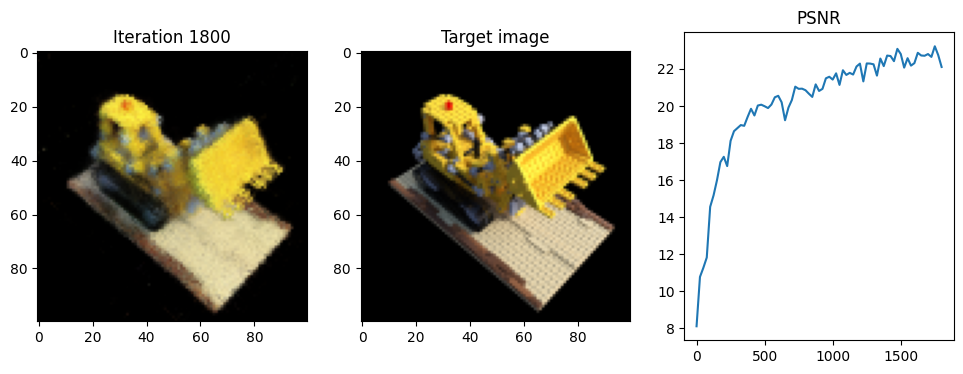

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8697,  0.6911, -0.1585],
         [-0.8637,  0.6950, -0.1585],
         [-0.8576,  0.6989, -0.1585],
         ...,
         [-0.2815,  1.0676, -0.1585],
         [-0.2754,  1.0715, -0.1585],
         [-0.2694,  1.0754, -0.1585]],

        [[-0.8679,  0.6882, -0.1648],
         [-0.8618,  0.6921, -0.1648],
         [-0.8558,  0.6960, -0.1648],
         ...,
         [-0.2796,  1.0647, -0.1648],
         [-0.2736,  1.0686, -0.1648],
         [-0.2675,  1.0725, -0.1648]],

        [[-0.8660,  0.6854, -0.1711],
         [-0.8600,  0.6892, -0.1711],
         [-0.8539,  0.6931, -0.1711],
         ...,
         [-0.2778,  1.0618, -0.1711],
         [-0.2717,  1.0657, -0.1711],
         [-0.2657,  1.0696, -0.1711]],

        ...,

        [[-0.6908,  0.4116, -0.7730],
         [-0.6848,  0.4155, -0.7730],
         [-0.6787,  0.

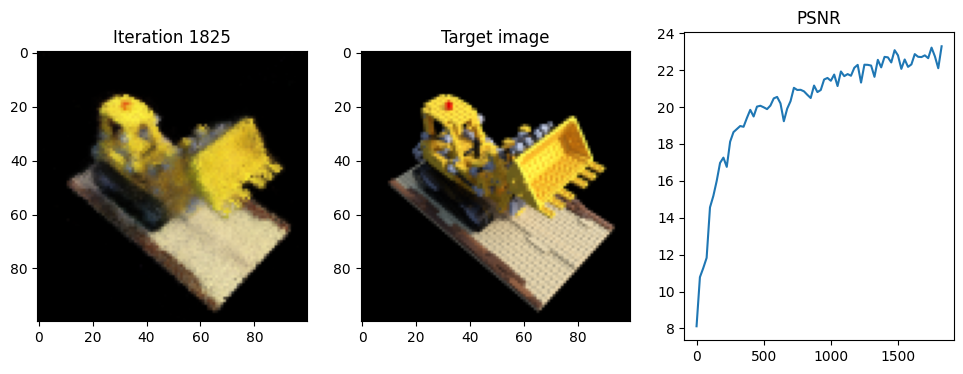

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.2707,  1.0884, -0.0362],
         [-0.2635,  1.0878, -0.0362],
         [-0.2563,  1.0872, -0.0362],
         ...,
         [ 0.4253,  1.0305, -0.0362],
         [ 0.4325,  1.0299, -0.0362],
         [ 0.4397,  1.0293, -0.0362]],

        [[-0.2709,  1.0857, -0.0429],
         [-0.2637,  1.0851, -0.0429],
         [-0.2566,  1.0845, -0.0429],
         ...,
         [ 0.4251,  1.0278, -0.0429],
         [ 0.4323,  1.0272, -0.0429],
         [ 0.4394,  1.0266, -0.0429]],

        [[-0.2711,  1.0831, -0.0496],
         [-0.2639,  1.0825, -0.0496],
         [-0.2568,  1.0819, -0.0496],
         ...,
         [ 0.4249,  1.0252, -0.0496],
         [ 0.4320,  1.0246, -0.0496],
         [ 0.4392,  1.0240, -0.0496]],

        ...,

        [[-0.2921,  0.8305, -0.6849],
         [-0.2850,  0.8299, -0.6849],
         [-0.2778,  0.

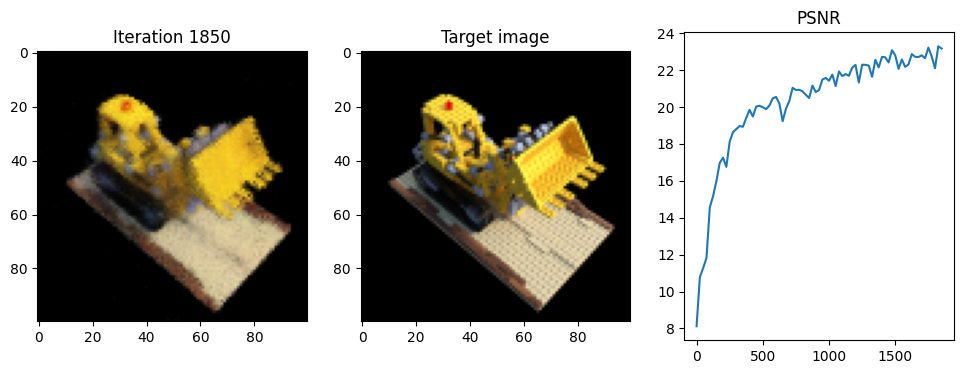

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.4718, -1.0153, -0.0753],
         [-0.4770, -1.0104, -0.0753],
         [-0.4822, -1.0054, -0.0753],
         ...,
         [-0.9769, -0.5330, -0.0753],
         [-0.9821, -0.5280, -0.0753],
         [-0.9873, -0.5231, -0.0753]],

        [[-0.4698, -1.0132, -0.0818],
         [-0.4750, -1.0083, -0.0818],
         [-0.4802, -1.0033, -0.0818],
         ...,
         [-0.9749, -0.5309, -0.0818],
         [-0.9801, -0.5259, -0.0818],
         [-0.9853, -0.5210, -0.0818]],

        [[-0.4678, -1.0111, -0.0884],
         [-0.4730, -1.0062, -0.0884],
         [-0.4782, -1.0012, -0.0884],
         ...,
         [-0.9729, -0.5288, -0.0884],
         [-0.9781, -0.5238, -0.0884],
         [-0.9833, -0.5189, -0.0884]],

        ...,

        [[-0.2767, -0.8110, -0.7140],
         [-0.2819, -0.8061, -0.7140],
         [-0.2871, -0.

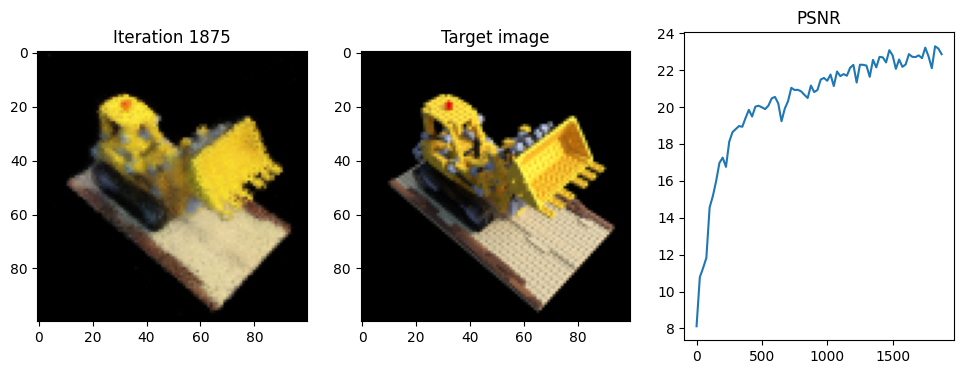

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.7988, -0.0661, -0.7854],
         [-0.7961, -0.0594, -0.7854],
         [-0.7934, -0.0527, -0.7854],
         ...,
         [-0.5376,  0.5816, -0.7854],
         [-0.5349,  0.5883, -0.7854],
         [-0.5322,  0.5950, -0.7854]],

        [[-0.7926, -0.0686, -0.7881],
         [-0.7899, -0.0619, -0.7881],
         [-0.7872, -0.0552, -0.7881],
         ...,
         [-0.5314,  0.5792, -0.7881],
         [-0.5287,  0.5858, -0.7881],
         [-0.5260,  0.5925, -0.7881]],

        [[-0.7864, -0.0711, -0.7909],
         [-0.7837, -0.0644, -0.7909],
         [-0.7810, -0.0577, -0.7909],
         ...,
         [-0.5253,  0.5767, -0.7909],
         [-0.5226,  0.5833, -0.7909],
         [-0.5199,  0.5900, -0.7909]],

        ...,

        [[-0.2006, -0.3073, -1.0533],
         [-0.1979, -0.3006, -1.0533],
         [-0.1952, -0.

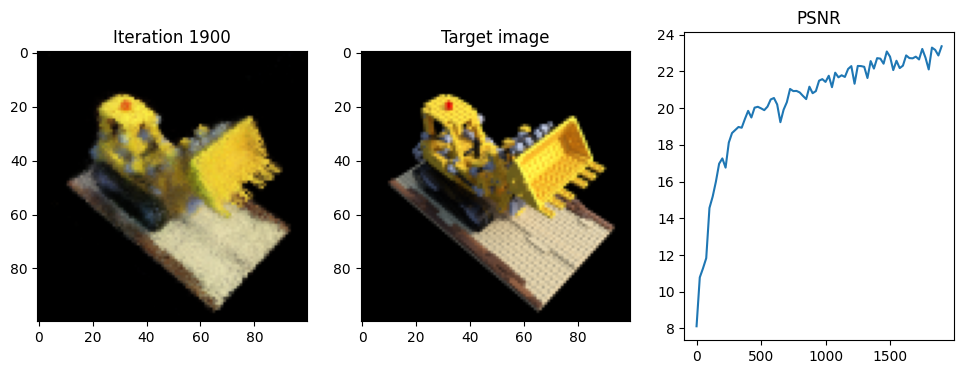

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.1221,  0.0078, -0.0072],
         [-1.1197,  0.0146, -0.0072],
         [-1.1174,  0.0214, -0.0072],
         ...,
         [-0.8934,  0.6677, -0.0072],
         [-0.8911,  0.6745, -0.0072],
         [-0.8887,  0.6813, -0.0072]],

        [[-1.1197,  0.0070, -0.0139],
         [-1.1174,  0.0138, -0.0139],
         [-1.1150,  0.0206, -0.0139],
         ...,
         [-0.8911,  0.6669, -0.0139],
         [-0.8887,  0.6737, -0.0139],
         [-0.8864,  0.6805, -0.0139]],

        [[-1.1174,  0.0062, -0.0207],
         [-1.1150,  0.0130, -0.0207],
         [-1.1127,  0.0198, -0.0207],
         ...,
         [-0.8887,  0.6661, -0.0207],
         [-0.8864,  0.6729, -0.0207],
         [-0.8840,  0.6797, -0.0207]],

        ...,

        [[-0.8944, -0.0711, -0.6627],
         [-0.8920, -0.0643, -0.6627],
         [-0.8897, -0.

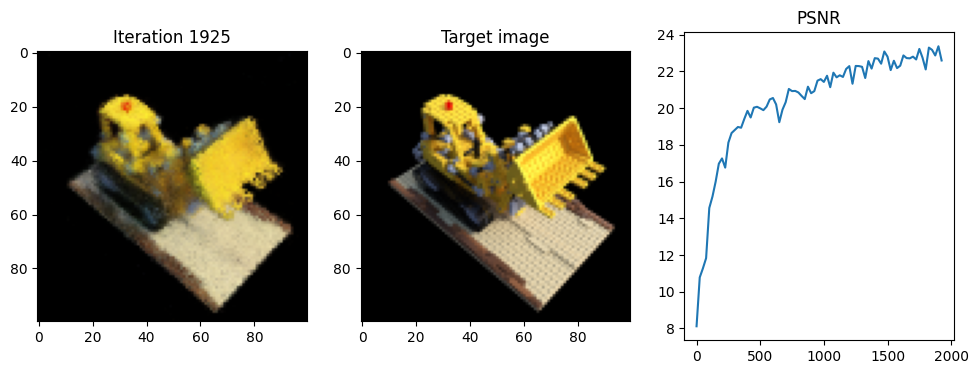

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5702, -0.9487,  0.1847],
         [ 0.5631, -0.9502,  0.1847],
         [ 0.5561, -0.9517,  0.1847],
         ...,
         [-0.1129, -1.0942,  0.1847],
         [-0.1199, -1.0957,  0.1847],
         [-0.1270, -1.0972,  0.1847]],

        [[ 0.5699, -0.9475,  0.1776],
         [ 0.5629, -0.9490,  0.1776],
         [ 0.5558, -0.9505,  0.1776],
         ...,
         [-0.1131, -1.0930,  0.1776],
         [-0.1202, -1.0945,  0.1776],
         [-0.1272, -1.0960,  0.1776]],

        [[ 0.5697, -0.9463,  0.1705],
         [ 0.5626, -0.9478,  0.1705],
         [ 0.5556, -0.9493,  0.1705],
         ...,
         [-0.1134, -1.0918,  0.1705],
         [-0.1204, -1.0933,  0.1705],
         [-0.1275, -1.0948,  0.1705]],

        ...,

        [[ 0.5454, -0.8325, -0.5035],
         [ 0.5384, -0.8340, -0.5035],
         [ 0.5314, -0.

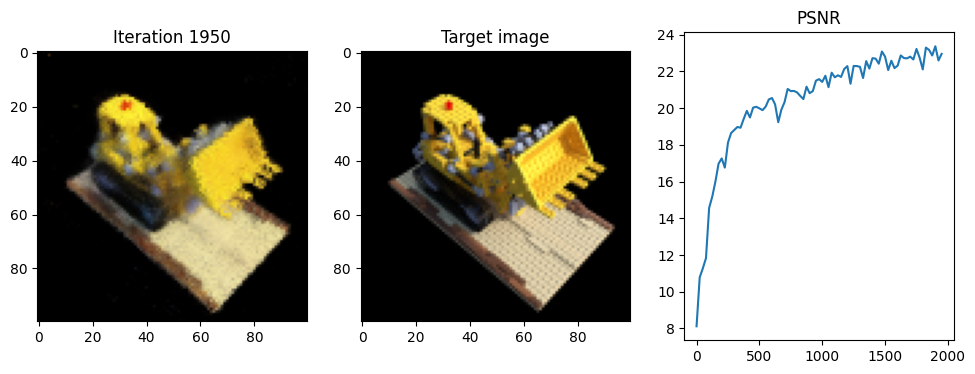

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.7976, -0.7889,  0.0277],
         [ 0.7911, -0.7921,  0.0277],
         [ 0.7847, -0.7953,  0.0277],
         ...,
         [ 0.1731, -1.1015,  0.0277],
         [ 0.1666, -1.1048,  0.0277],
         [ 0.1602, -1.1080,  0.0277]],

        [[ 0.7966, -0.7868,  0.0208],
         [ 0.7901, -0.7901,  0.0208],
         [ 0.7837, -0.7933,  0.0208],
         ...,
         [ 0.1721, -1.0995,  0.0208],
         [ 0.1656, -1.1027,  0.0208],
         [ 0.1592, -1.1060,  0.0208]],

        [[ 0.7955, -0.7848,  0.0140],
         [ 0.7891, -0.7880,  0.0140],
         [ 0.7827, -0.7913,  0.0140],
         ...,
         [ 0.1710, -1.0975,  0.0140],
         [ 0.1646, -1.1007,  0.0140],
         [ 0.1582, -1.1039,  0.0140]],

        ...,

        [[ 0.6994, -0.5927, -0.6354],
         [ 0.6929, -0.5959, -0.6354],
         [ 0.6865, -0.

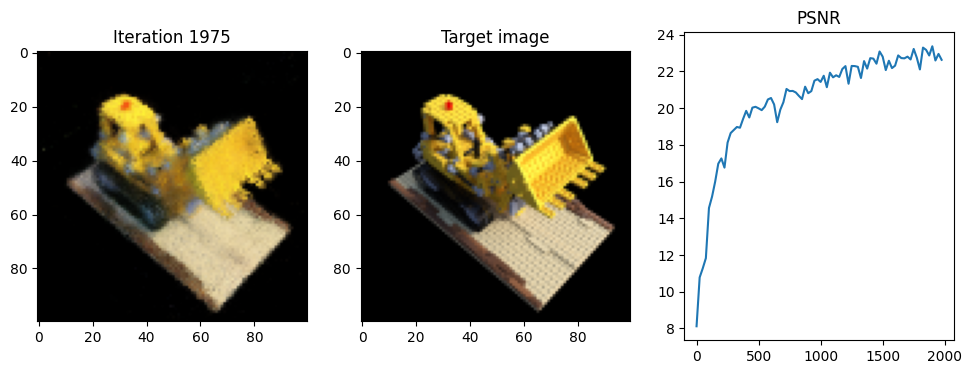

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.3602, -0.5947, -0.8808],
         [-0.3636, -0.5883, -0.8808],
         [-0.3669, -0.5819, -0.8808],
         ...,
         [-0.6839,  0.0242, -0.8808],
         [-0.6873,  0.0306, -0.8808],
         [-0.6906,  0.0369, -0.8808]],

        [[-0.3541, -0.5915, -0.8825],
         [-0.3574, -0.5851, -0.8825],
         [-0.3607, -0.5787, -0.8825],
         ...,
         [-0.6777,  0.0274, -0.8825],
         [-0.6811,  0.0338, -0.8825],
         [-0.6844,  0.0402, -0.8825]],

        [[-0.3479, -0.5882, -0.8843],
         [-0.3512, -0.5818, -0.8843],
         [-0.3546, -0.5755, -0.8843],
         ...,
         [-0.6716,  0.0306, -0.8843],
         [-0.6749,  0.0370, -0.8843],
         [-0.6782,  0.0434, -0.8843]],

        ...,

        [[ 0.2396, -0.2809, -1.0525],
         [ 0.2363, -0.2746, -1.0525],
         [ 0.2329, -0.

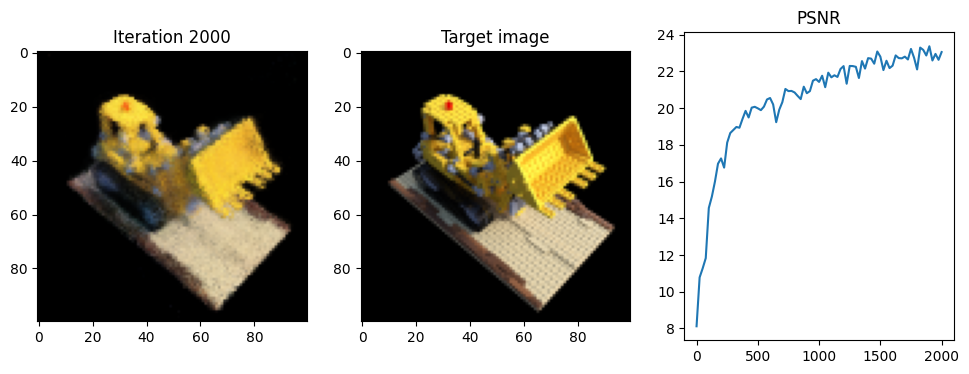

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5617, -0.9538,  0.1844],
         [ 0.5546, -0.9552,  0.1844],
         [ 0.5476, -0.9567,  0.1844],
         ...,
         [-0.1227, -1.0932,  0.1844],
         [-0.1297, -1.0946,  0.1844],
         [-0.1368, -1.0961,  0.1844]],

        [[ 0.5614, -0.9526,  0.1773],
         [ 0.5544, -0.9540,  0.1773],
         [ 0.5473, -0.9555,  0.1773],
         ...,
         [-0.1229, -1.0920,  0.1773],
         [-0.1300, -1.0934,  0.1773],
         [-0.1370, -1.0949,  0.1773]],

        [[ 0.5612, -0.9514,  0.1702],
         [ 0.5541, -0.9528,  0.1702],
         [ 0.5471, -0.9543,  0.1702],
         ...,
         [-0.1232, -1.0908,  0.1702],
         [-0.1302, -1.0922,  0.1702],
         [-0.1373, -1.0937,  0.1702]],

        ...,

        [[ 0.5379, -0.8372, -0.5038],
         [ 0.5309, -0.8386, -0.5038],
         [ 0.5238, -0.

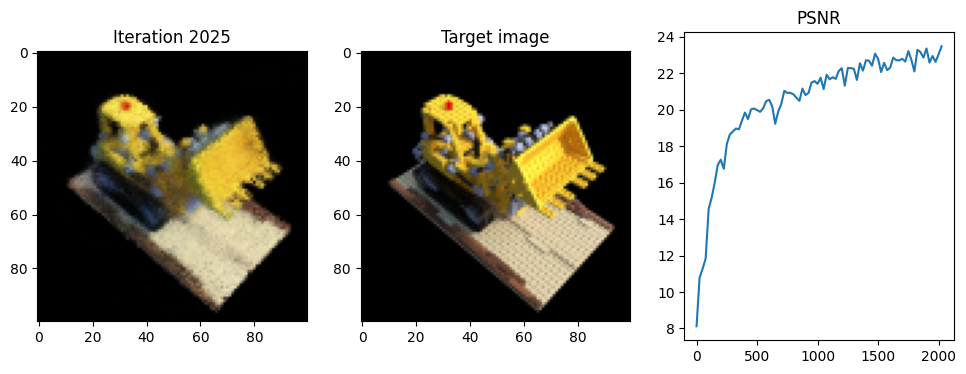

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0078,  0.4466, -0.2097],
         [ 1.0085,  0.4395, -0.2097],
         [ 1.0091,  0.4323, -0.2097],
         ...,
         [ 1.0668, -0.2493, -0.2097],
         [ 1.0674, -0.2564, -0.2097],
         [ 1.0680, -0.2636, -0.2097]],

        [[ 1.0041,  0.4463, -0.2158],
         [ 1.0047,  0.4392, -0.2158],
         [ 1.0053,  0.4320, -0.2158],
         ...,
         [ 1.0631, -0.2496, -0.2158],
         [ 1.0637, -0.2568, -0.2158],
         [ 1.0643, -0.2639, -0.2158]],

        [[ 1.0004,  0.4460, -0.2220],
         [ 1.0010,  0.4388, -0.2220],
         [ 1.0016,  0.4317, -0.2220],
         ...,
         [ 1.0594, -0.2499, -0.2220],
         [ 1.0600, -0.2571, -0.2220],
         [ 1.0606, -0.2642, -0.2220]],

        ...,

        [[ 0.6476,  0.4161, -0.8072],
         [ 0.6482,  0.4090, -0.8072],
         [ 0.6488,  0.

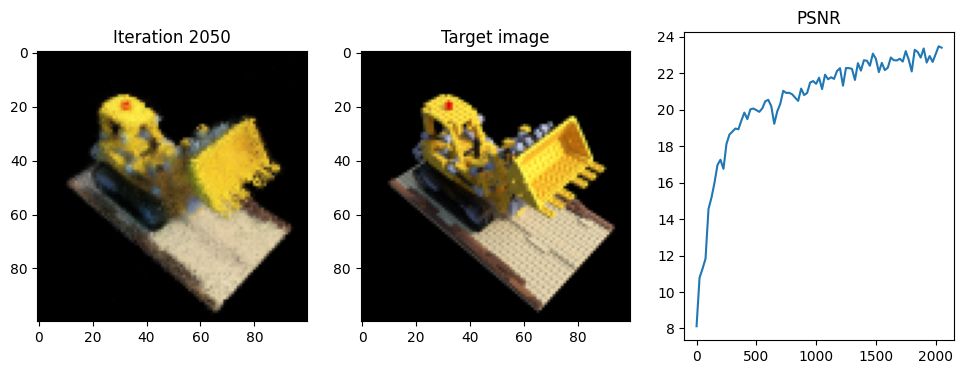

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.1092,  0.1040, -0.1346],
         [ 1.1075,  0.0970, -0.1346],
         [ 1.1058,  0.0900, -0.1346],
         ...,
         [ 0.9462, -0.5751, -0.1346],
         [ 0.9445, -0.5821, -0.1346],
         [ 0.9428, -0.5891, -0.1346]],

        [[ 1.1060,  0.1048, -0.1410],
         [ 1.1043,  0.0978, -0.1410],
         [ 1.1026,  0.0908, -0.1410],
         ...,
         [ 0.9430, -0.5743, -0.1410],
         [ 0.9413, -0.5813, -0.1410],
         [ 0.9396, -0.5883, -0.1410]],

        [[ 1.1028,  0.1055, -0.1474],
         [ 1.1011,  0.0985, -0.1474],
         [ 1.0994,  0.0915, -0.1474],
         ...,
         [ 0.9398, -0.5736, -0.1474],
         [ 0.9381, -0.5806, -0.1474],
         [ 0.9365, -0.5876, -0.1474]],

        ...,

        [[ 0.8001,  0.1782, -0.7565],
         [ 0.7984,  0.1712, -0.7565],
         [ 0.7967,  0.

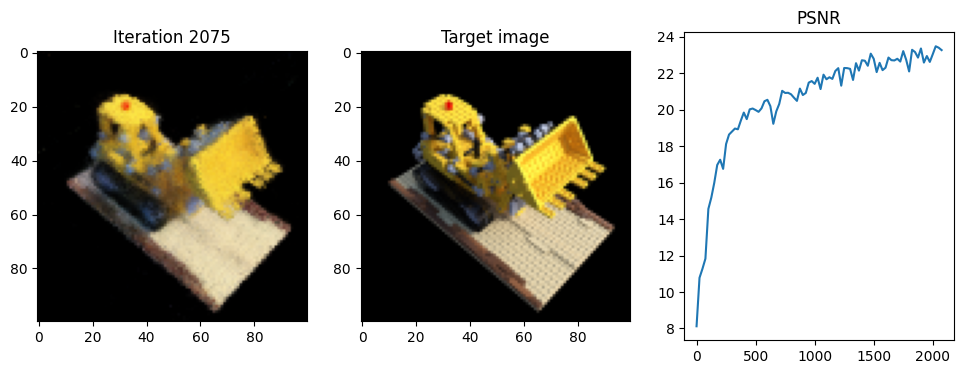

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0267, -0.4404,  0.1056],
         [ 1.0219, -0.4457,  0.1056],
         [ 1.0171, -0.4511,  0.1056],
         ...,
         [ 0.5593, -0.9593,  0.1056],
         [ 0.5544, -0.9646,  0.1056],
         [ 0.5496, -0.9700,  0.1056]],

        [[ 1.0254, -0.4392,  0.0986],
         [ 1.0206, -0.4446,  0.0986],
         [ 1.0158, -0.4499,  0.0986],
         ...,
         [ 0.5580, -0.9581,  0.0986],
         [ 0.5531, -0.9634,  0.0986],
         [ 0.5483, -0.9688,  0.0986]],

        [[ 1.0241, -0.4380,  0.0916],
         [ 1.0193, -0.4434,  0.0916],
         [ 1.0145, -0.4487,  0.0916],
         ...,
         [ 0.5567, -0.9569,  0.0916],
         [ 0.5518, -0.9623,  0.0916],
         [ 0.5470, -0.9676,  0.0916]],

        ...,

        [[ 0.9003, -0.3265, -0.5718],
         [ 0.8955, -0.3319, -0.5718],
         [ 0.8907, -0.

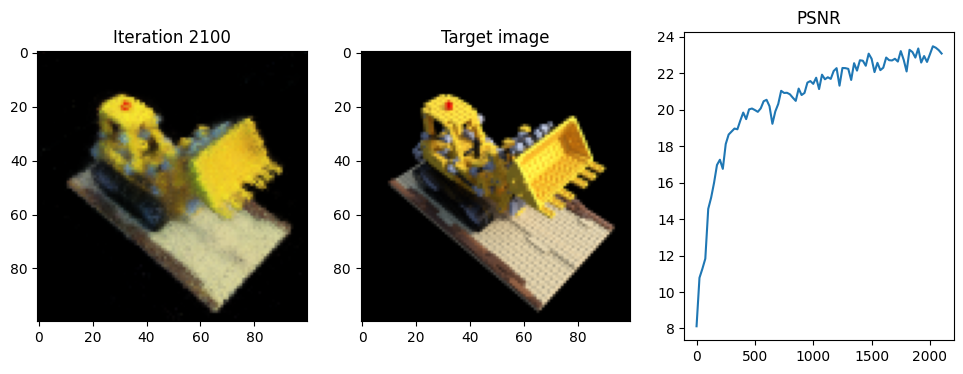

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.7988, -0.0661, -0.7854],
         [-0.7961, -0.0594, -0.7854],
         [-0.7934, -0.0527, -0.7854],
         ...,
         [-0.5376,  0.5816, -0.7854],
         [-0.5349,  0.5883, -0.7854],
         [-0.5322,  0.5950, -0.7854]],

        [[-0.7926, -0.0686, -0.7881],
         [-0.7899, -0.0619, -0.7881],
         [-0.7872, -0.0552, -0.7881],
         ...,
         [-0.5314,  0.5792, -0.7881],
         [-0.5287,  0.5858, -0.7881],
         [-0.5260,  0.5925, -0.7881]],

        [[-0.7864, -0.0711, -0.7909],
         [-0.7837, -0.0644, -0.7909],
         [-0.7810, -0.0577, -0.7909],
         ...,
         [-0.5253,  0.5767, -0.7909],
         [-0.5226,  0.5833, -0.7909],
         [-0.5199,  0.5900, -0.7909]],

        ...,

        [[-0.2006, -0.3073, -1.0533],
         [-0.1979, -0.3006, -1.0533],
         [-0.1952, -0.

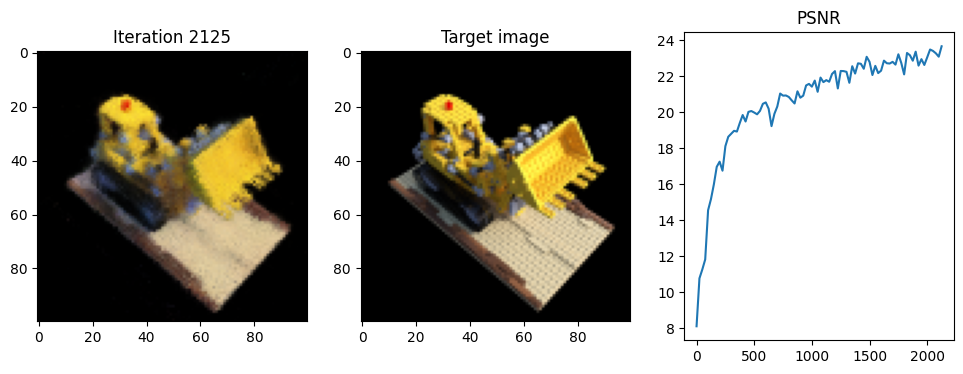

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5443, -0.7094, -0.6780],
         [ 0.5373, -0.7111, -0.6780],
         [ 0.5303, -0.7128, -0.6780],
         ...,
         [-0.1340, -0.8755, -0.6780],
         [-0.1410, -0.8772, -0.6780],
         [-0.1480, -0.8789, -0.6780]],

        [[ 0.5429, -0.7034, -0.6816],
         [ 0.5359, -0.7051, -0.6816],
         [ 0.5289, -0.7068, -0.6816],
         ...,
         [-0.1355, -0.8695, -0.6816],
         [-0.1425, -0.8712, -0.6816],
         [-0.1495, -0.8729, -0.6816]],

        [[ 0.5414, -0.6974, -0.6853],
         [ 0.5344, -0.6991, -0.6853],
         [ 0.5274, -0.7008, -0.6853],
         ...,
         [-0.1370, -0.8635, -0.6853],
         [-0.1440, -0.8652, -0.6853],
         [-0.1510, -0.8669, -0.6853]],

        ...,

        [[ 0.4013, -0.1253, -1.0331],
         [ 0.3943, -0.1270, -1.0331],
         [ 0.3873, -0.

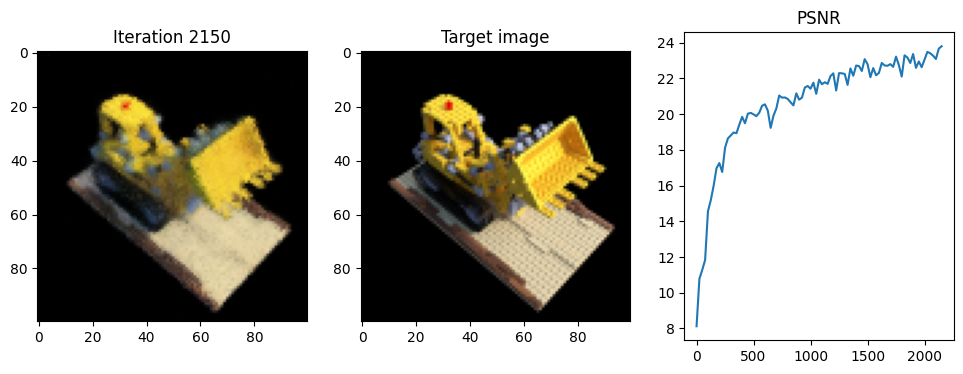

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 8.0956e-03,  8.6263e-01, -7.1763e-01],
         [ 1.4610e-02,  8.5957e-01, -7.1763e-01],
         [ 2.1125e-02,  8.5650e-01, -7.1763e-01],
         ...,
         [ 6.4001e-01,  5.6524e-01, -7.1763e-01],
         [ 6.4653e-01,  5.6218e-01, -7.1763e-01],
         [ 6.5304e-01,  5.5911e-01, -7.1763e-01]],

        [[ 5.3818e-03,  8.5687e-01, -7.2098e-01],
         [ 1.1896e-02,  8.5380e-01, -7.2098e-01],
         [ 1.8411e-02,  8.5073e-01, -7.2098e-01],
         ...,
         [ 6.3730e-01,  5.5947e-01, -7.2098e-01],
         [ 6.4381e-01,  5.5641e-01, -7.2098e-01],
         [ 6.5033e-01,  5.5334e-01, -7.2098e-01]],

        [[ 2.6680e-03,  8.5110e-01, -7.2433e-01],
         [ 9.1826e-03,  8.4803e-01, -7.2433e-01],
         [ 1.5697e-02,  8.4497e-01, -7.2433e-01],
         ...,
         [ 6.3459e-01,  5.5371e-01, -7.2433e-01]

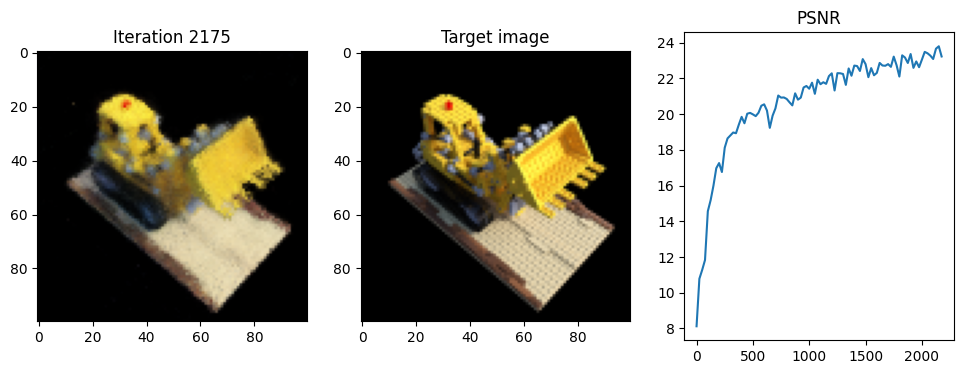

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9745,  0.3719, -0.4138],
         [-0.9698,  0.3773, -0.4138],
         [-0.9651,  0.3827, -0.4138],
         ...,
         [-0.5156,  0.8983, -0.4138],
         [-0.5109,  0.9038, -0.4138],
         [-0.5062,  0.9092, -0.4138]],

        [[-0.9708,  0.3687, -0.4191],
         [-0.9661,  0.3741, -0.4191],
         [-0.9614,  0.3795, -0.4191],
         ...,
         [-0.5119,  0.8951, -0.4191],
         [-0.5072,  0.9006, -0.4191],
         [-0.5025,  0.9060, -0.4191]],

        [[-0.9672,  0.3655, -0.4244],
         [-0.9624,  0.3709, -0.4244],
         [-0.9577,  0.3763, -0.4244],
         ...,
         [-0.5083,  0.8919, -0.4244],
         [-0.5035,  0.8974, -0.4244],
         [-0.4988,  0.9028, -0.4244]],

        ...,

        [[-0.6174,  0.0606, -0.9270],
         [-0.6127,  0.0660, -0.9270],
         [-0.6079,  0.

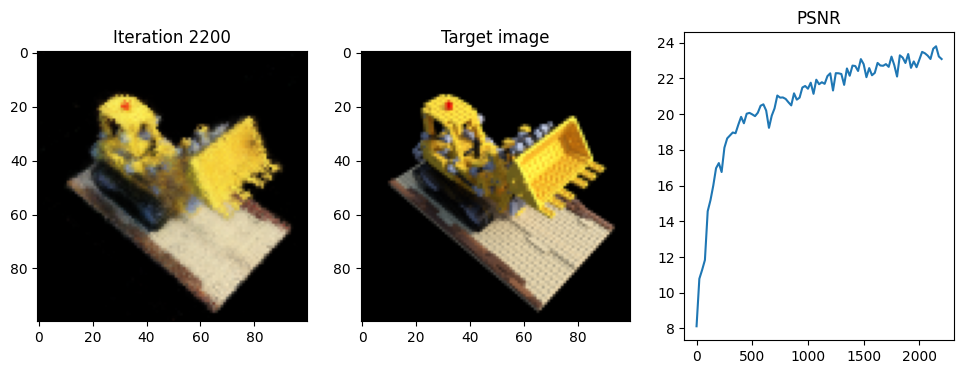

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.9594,  0.4892, -0.3151],
         [ 0.9604,  0.4821, -0.3151],
         [ 0.9613,  0.4750, -0.3151],
         ...,
         [ 1.0505, -0.2032, -0.3151],
         [ 1.0514, -0.2103, -0.3151],
         [ 1.0524, -0.2175, -0.3151]],

        [[ 0.9551,  0.4887, -0.3209],
         [ 0.9561,  0.4815, -0.3209],
         [ 0.9570,  0.4744, -0.3209],
         ...,
         [ 1.0462, -0.2038, -0.3209],
         [ 1.0471, -0.2109, -0.3209],
         [ 1.0481, -0.2180, -0.3209]],

        [[ 0.9508,  0.4881, -0.3266],
         [ 0.9518,  0.4810, -0.3266],
         [ 0.9527,  0.4738, -0.3266],
         ...,
         [ 1.0419, -0.2043, -0.3266],
         [ 1.0428, -0.2115, -0.3266],
         [ 1.0438, -0.2186, -0.3266]],

        ...,

        [[ 0.5423,  0.4344, -0.8726],
         [ 0.5432,  0.4273, -0.8726],
         [ 0.5441,  0.

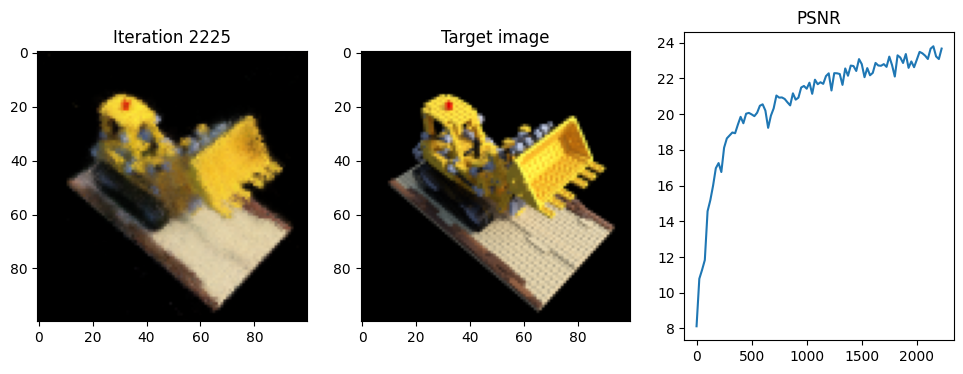

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.9634,  0.0415, -0.5738],
         [ 0.9610,  0.0347, -0.5738],
         [ 0.9586,  0.0279, -0.5738],
         ...,
         [ 0.7309, -0.6170, -0.5738],
         [ 0.7285, -0.6238, -0.5738],
         [ 0.7261, -0.6306, -0.5738]],

        [[ 0.9581,  0.0434, -0.5782],
         [ 0.9557,  0.0366, -0.5782],
         [ 0.9533,  0.0298, -0.5782],
         ...,
         [ 0.7255, -0.6151, -0.5782],
         [ 0.7231, -0.6219, -0.5782],
         [ 0.7207, -0.6287, -0.5782]],

        [[ 0.9527,  0.0453, -0.5826],
         [ 0.9503,  0.0385, -0.5826],
         [ 0.9479,  0.0317, -0.5826],
         ...,
         [ 0.7201, -0.6132, -0.5826],
         [ 0.7177, -0.6200, -0.5826],
         [ 0.7153, -0.6268, -0.5826]],

        ...,

        [[ 0.4412,  0.2260, -0.9992],
         [ 0.4388,  0.2192, -0.9992],
         [ 0.4364,  0.

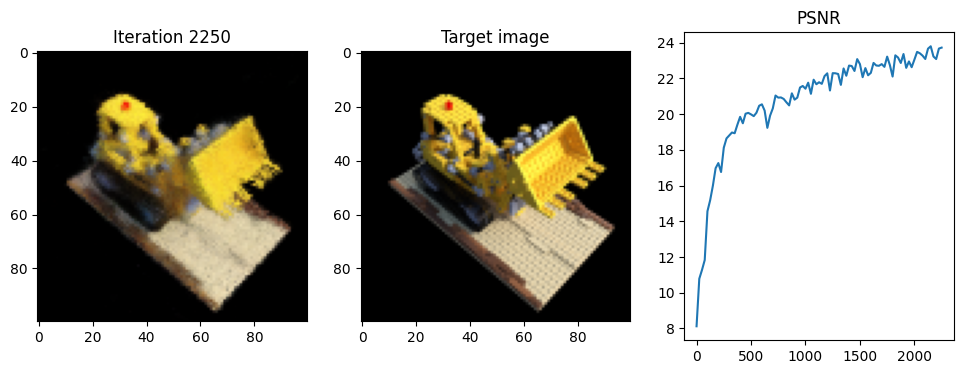

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.6347, -0.5658, -0.7323],
         [-0.6368, -0.5589, -0.7323],
         [-0.6389, -0.5520, -0.7323],
         ...,
         [-0.8350,  0.1033, -0.7323],
         [-0.8371,  0.1102, -0.7323],
         [-0.8391,  0.1171, -0.7323]],

        [[-0.6286, -0.5639, -0.7355],
         [-0.6306, -0.5570, -0.7355],
         [-0.6327, -0.5501, -0.7355],
         ...,
         [-0.8288,  0.1052, -0.7355],
         [-0.8309,  0.1121, -0.7355],
         [-0.8330,  0.1190, -0.7355]],

        [[-0.6224, -0.5621, -0.7387],
         [-0.6245, -0.5552, -0.7387],
         [-0.6265, -0.5483, -0.7387],
         ...,
         [-0.8227,  0.1070, -0.7387],
         [-0.8247,  0.1139, -0.7387],
         [-0.8268,  0.1208, -0.7387]],

        ...,

        [[-0.0368, -0.3868, -1.0455],
         [-0.0388, -0.3799, -1.0455],
         [-0.0409, -0.

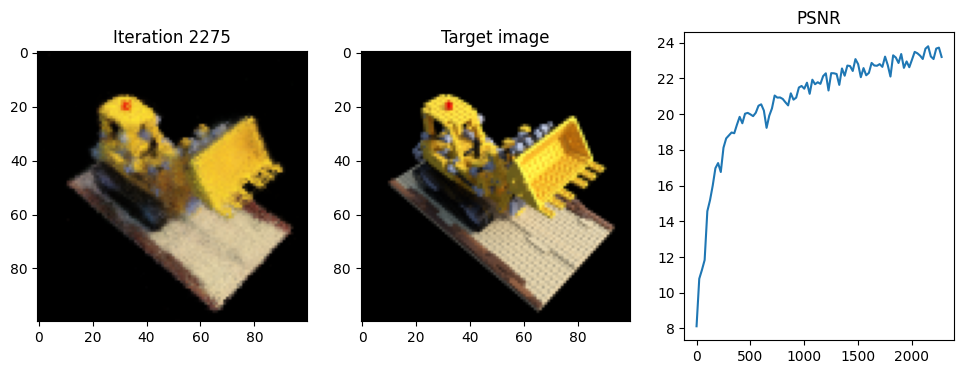

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.8685,  0.4267, -0.5682],
         [-0.8631,  0.4315, -0.5682],
         [-0.8578,  0.4363, -0.5682],
         ...,
         [-0.3495,  0.8939, -0.5682],
         [-0.3441,  0.8988, -0.5682],
         [-0.3387,  0.9036, -0.5682]],

        [[-0.8647,  0.4224, -0.5726],
         [-0.8593,  0.4273, -0.5726],
         [-0.8540,  0.4321, -0.5726],
         ...,
         [-0.3456,  0.8897, -0.5726],
         [-0.3403,  0.8945, -0.5726],
         [-0.3349,  0.8994, -0.5726]],

        [[-0.8609,  0.4182, -0.5771],
         [-0.8555,  0.4230, -0.5771],
         [-0.8502,  0.4278, -0.5771],
         ...,
         [-0.3418,  0.8855, -0.5771],
         [-0.3365,  0.8903, -0.5771],
         [-0.3311,  0.8951, -0.5771]],

        ...,

        [[-0.4997,  0.0170, -0.9971],
         [-0.4943,  0.0218, -0.9971],
         [-0.4890,  0.

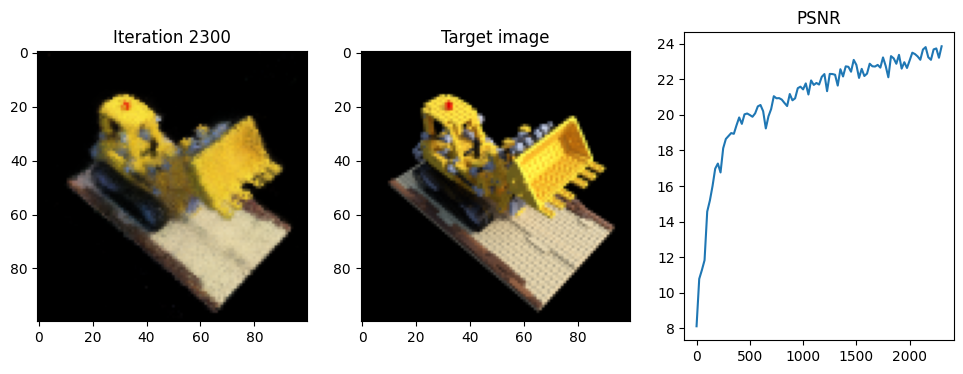

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-1.0879,  0.1496,  0.2307],
         [-1.0847,  0.1560,  0.2307],
         [-1.0814,  0.1624,  0.2307],
         ...,
         [-0.7712,  0.7721,  0.2307],
         [-0.7680,  0.7785,  0.2307],
         [-0.7647,  0.7849,  0.2307]],

        [[-1.0871,  0.1492,  0.2235],
         [-1.0839,  0.1556,  0.2235],
         [-1.0806,  0.1620,  0.2235],
         ...,
         [-0.7704,  0.7717,  0.2235],
         [-0.7672,  0.7781,  0.2235],
         [-0.7639,  0.7845,  0.2235]],

        [[-1.0863,  0.1488,  0.2164],
         [-1.0830,  0.1552,  0.2164],
         [-1.0798,  0.1616,  0.2164],
         ...,
         [-0.7696,  0.7713,  0.2164],
         [-0.7663,  0.7777,  0.2164],
         [-0.7631,  0.7841,  0.2164]],

        ...,

        [[-1.0092,  0.1096, -0.4621],
         [-1.0060,  0.1160, -0.4621],
         [-1.0027,  0.

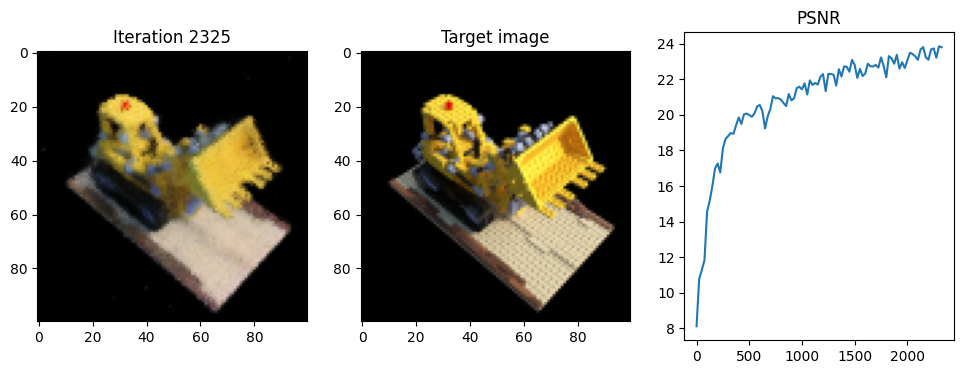

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.5617, -0.9538,  0.1844],
         [ 0.5546, -0.9552,  0.1844],
         [ 0.5476, -0.9567,  0.1844],
         ...,
         [-0.1227, -1.0932,  0.1844],
         [-0.1297, -1.0946,  0.1844],
         [-0.1368, -1.0961,  0.1844]],

        [[ 0.5614, -0.9526,  0.1773],
         [ 0.5544, -0.9540,  0.1773],
         [ 0.5473, -0.9555,  0.1773],
         ...,
         [-0.1229, -1.0920,  0.1773],
         [-0.1300, -1.0934,  0.1773],
         [-0.1370, -1.0949,  0.1773]],

        [[ 0.5612, -0.9514,  0.1702],
         [ 0.5541, -0.9528,  0.1702],
         [ 0.5471, -0.9543,  0.1702],
         ...,
         [-0.1232, -1.0908,  0.1702],
         [-0.1302, -1.0922,  0.1702],
         [-0.1373, -1.0937,  0.1702]],

        ...,

        [[ 0.5379, -0.8372, -0.5038],
         [ 0.5309, -0.8386, -0.5038],
         [ 0.5238, -0.

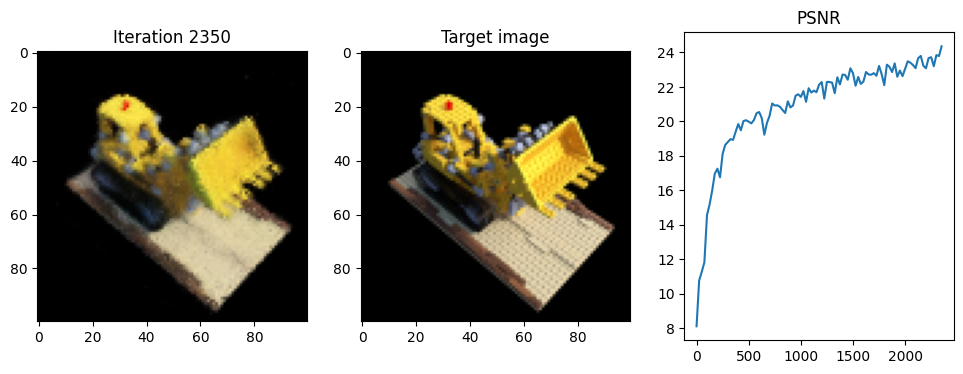

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9433,  0.0620, -0.6046],
         [-0.9402,  0.0685, -0.6046],
         [-0.9370,  0.0749, -0.6046],
         ...,
         [-0.6356,  0.6890, -0.6046],
         [-0.6324,  0.6954, -0.6046],
         [-0.6292,  0.7019, -0.6046]],

        [[-0.9381,  0.0594, -0.6087],
         [-0.9349,  0.0659, -0.6087],
         [-0.9317,  0.0724, -0.6087],
         ...,
         [-0.6303,  0.6864, -0.6087],
         [-0.6272,  0.6928, -0.6087],
         [-0.6240,  0.6993, -0.6087]],

        [[-0.9328,  0.0568, -0.6129],
         [-0.9296,  0.0633, -0.6129],
         [-0.9265,  0.0698, -0.6129],
         ...,
         [-0.6251,  0.6838, -0.6129],
         [-0.6219,  0.6903, -0.6129],
         [-0.6187,  0.6967, -0.6129]],

        ...,

        [[-0.4331, -0.1884, -1.0104],
         [-0.4300, -0.1820, -1.0104],
         [-0.4268, -0.

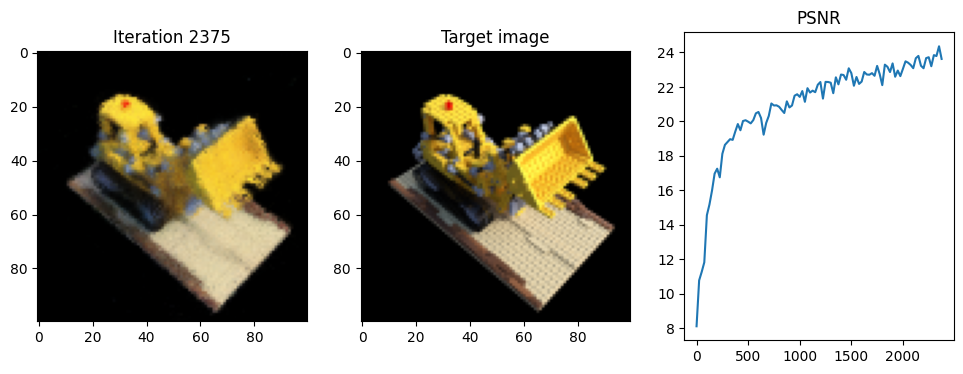

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.4202, -0.7161, -0.7549],
         [ 0.4130, -0.7167, -0.7549],
         [ 0.4059, -0.7173, -0.7549],
         ...,
         [-0.2758, -0.7734, -0.7549],
         [-0.2830, -0.7740, -0.7549],
         [-0.2902, -0.7746, -0.7549]],

        [[ 0.4197, -0.7096, -0.7579],
         [ 0.4125, -0.7102, -0.7579],
         [ 0.4053, -0.7108, -0.7579],
         ...,
         [-0.2764, -0.7669, -0.7579],
         [-0.2835, -0.7675, -0.7579],
         [-0.2907, -0.7681, -0.7579]],

        [[ 0.4191, -0.7031, -0.7609],
         [ 0.4120, -0.7037, -0.7609],
         [ 0.4048, -0.7043, -0.7609],
         ...,
         [-0.2769, -0.7604, -0.7609],
         [-0.2841, -0.7610, -0.7609],
         [-0.2912, -0.7616, -0.7609]],

        ...,

        [[ 0.3682, -0.0850, -1.0494],
         [ 0.3610, -0.0856, -1.0494],
         [ 0.3539, -0.

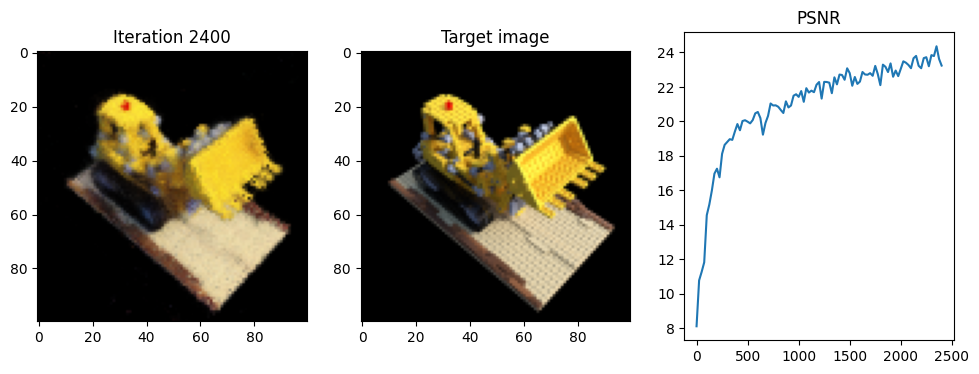

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0267, -0.4404,  0.1056],
         [ 1.0219, -0.4457,  0.1056],
         [ 1.0171, -0.4511,  0.1056],
         ...,
         [ 0.5593, -0.9593,  0.1056],
         [ 0.5544, -0.9646,  0.1056],
         [ 0.5496, -0.9700,  0.1056]],

        [[ 1.0254, -0.4392,  0.0986],
         [ 1.0206, -0.4446,  0.0986],
         [ 1.0158, -0.4499,  0.0986],
         ...,
         [ 0.5580, -0.9581,  0.0986],
         [ 0.5531, -0.9634,  0.0986],
         [ 0.5483, -0.9688,  0.0986]],

        [[ 1.0241, -0.4380,  0.0916],
         [ 1.0193, -0.4434,  0.0916],
         [ 1.0145, -0.4487,  0.0916],
         ...,
         [ 0.5567, -0.9569,  0.0916],
         [ 0.5518, -0.9623,  0.0916],
         [ 0.5470, -0.9676,  0.0916]],

        ...,

        [[ 0.9003, -0.3265, -0.5718],
         [ 0.8955, -0.3319, -0.5718],
         [ 0.8907, -0.

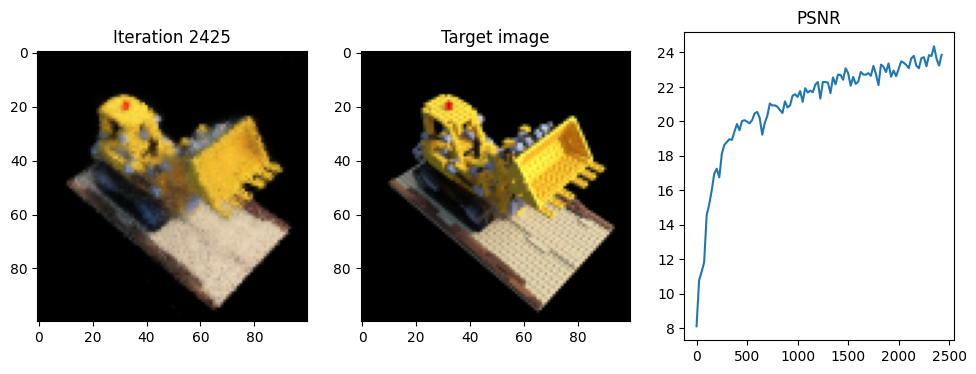

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.5649, -0.9692,  0.0278],
         [-0.5696, -0.9637,  0.0278],
         [-0.5744, -0.9583,  0.0278],
         ...,
         [-1.0235, -0.4425,  0.0278],
         [-1.0282, -0.4370,  0.0278],
         [-1.0330, -0.4316,  0.0278]],

        [[-0.5632, -0.9677,  0.0210],
         [-0.5679, -0.9623,  0.0210],
         [-0.5727, -0.9568,  0.0210],
         ...,
         [-1.0218, -0.4410,  0.0210],
         [-1.0265, -0.4355,  0.0210],
         [-1.0313, -0.4301,  0.0210]],

        [[-0.5615, -0.9662,  0.0142],
         [-0.5662, -0.9608,  0.0142],
         [-0.5710, -0.9553,  0.0142],
         ...,
         [-1.0201, -0.4395,  0.0142],
         [-1.0248, -0.4341,  0.0142],
         [-1.0296, -0.4286,  0.0142]],

        ...,

        [[-0.3995, -0.8252, -0.6352],
         [-0.4043, -0.8198, -0.6352],
         [-0.4090, -0.

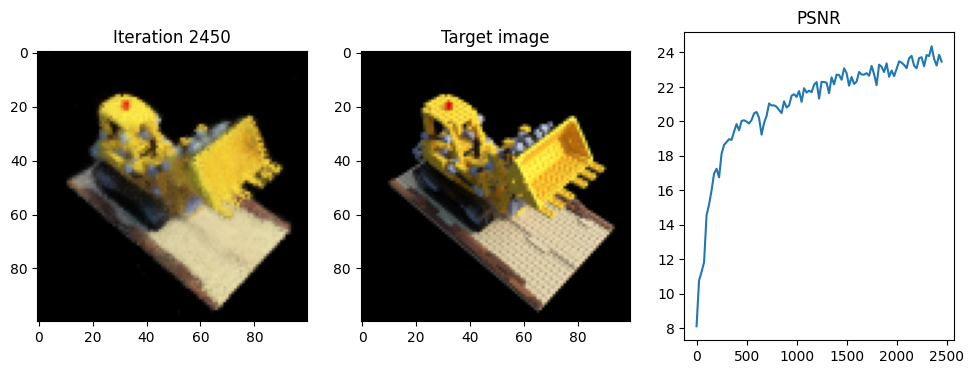

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.9905, -0.5087,  0.1392],
         [ 0.9853, -0.5137,  0.1392],
         [ 0.9801, -0.5187,  0.1392],
         ...,
         [ 0.4877, -0.9934,  0.1392],
         [ 0.4825, -0.9984,  0.1392],
         [ 0.4773, -1.0034,  0.1392]],

        [[ 0.9894, -0.5076,  0.1321],
         [ 0.9842, -0.5126,  0.1321],
         [ 0.9790, -0.5176,  0.1321],
         ...,
         [ 0.4866, -0.9923,  0.1321],
         [ 0.4814, -0.9973,  0.1321],
         [ 0.4763, -1.0023,  0.1321]],

        [[ 0.9884, -0.5065,  0.1251],
         [ 0.9832, -0.5115,  0.1251],
         [ 0.9780, -0.5165,  0.1251],
         ...,
         [ 0.4856, -0.9912,  0.1251],
         [ 0.4804, -0.9962,  0.1251],
         [ 0.4752, -1.0012,  0.1251]],

        ...,

        [[ 0.8874, -0.4018, -0.5433],
         [ 0.8822, -0.4068, -0.5433],
         [ 0.8771, -0.

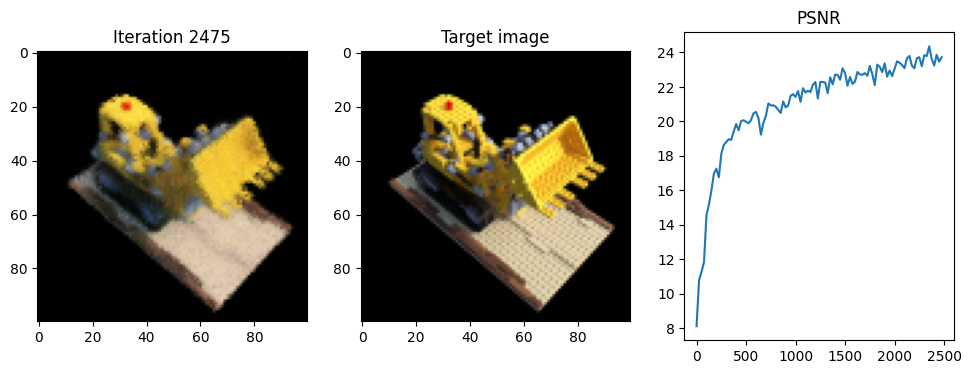

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3672, -0.9379, -0.4947],
         [ 0.3600, -0.9379, -0.4947],
         [ 0.3528, -0.9380, -0.4947],
         ...,
         [-0.3312, -0.9432, -0.4947],
         [-0.3384, -0.9433, -0.4947],
         [-0.3456, -0.9434, -0.4947]],

        [[ 0.3672, -0.9326, -0.4996],
         [ 0.3600, -0.9326, -0.4996],
         [ 0.3528, -0.9327, -0.4996],
         ...,
         [-0.3312, -0.9379, -0.4996],
         [-0.3384, -0.9380, -0.4996],
         [-0.3456, -0.9380, -0.4996]],

        [[ 0.3671, -0.9273, -0.5044],
         [ 0.3599, -0.9273, -0.5044],
         [ 0.3527, -0.9274, -0.5044],
         ...,
         [-0.3313, -0.9326, -0.5044],
         [-0.3385, -0.9327, -0.5044],
         [-0.3457, -0.9327, -0.5044]],

        ...,

        [[ 0.3633, -0.4227, -0.9662],
         [ 0.3561, -0.4227, -0.9662],
         [ 0.3489, -0.

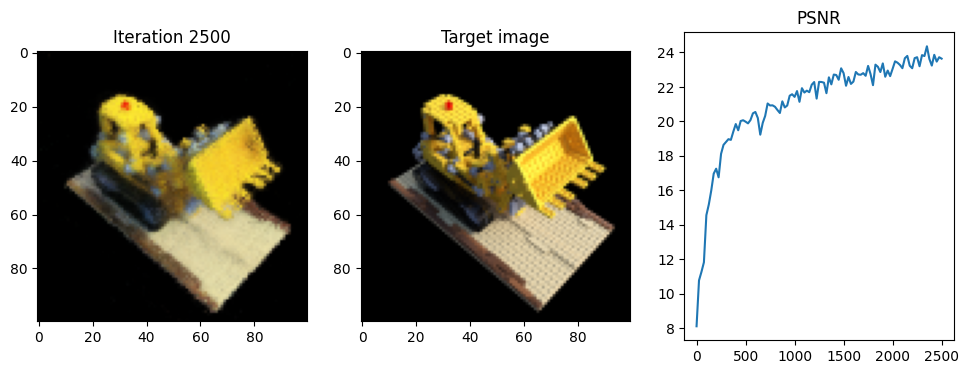

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0746,  0.2694, -0.1785],
         [ 1.0740,  0.2622, -0.1785],
         [ 1.0734,  0.2550, -0.1785],
         ...,
         [ 1.0151, -0.4265, -0.1785],
         [ 1.0145, -0.4337, -0.1785],
         [ 1.0138, -0.4408, -0.1785]],

        [[ 1.0711,  0.2697, -0.1847],
         [ 1.0705,  0.2625, -0.1847],
         [ 1.0699,  0.2553, -0.1847],
         ...,
         [ 1.0115, -0.4262, -0.1847],
         [ 1.0109, -0.4334, -0.1847],
         [ 1.0103, -0.4405, -0.1847]],

        [[ 1.0676,  0.2700, -0.1910],
         [ 1.0669,  0.2628, -0.1910],
         [ 1.0663,  0.2556, -0.1910],
         ...,
         [ 1.0080, -0.4259, -0.1910],
         [ 1.0074, -0.4331, -0.1910],
         [ 1.0068, -0.4402, -0.1910]],

        ...,

        [[ 0.7323,  0.2986, -0.7865],
         [ 0.7317,  0.2915, -0.7865],
         [ 0.7311,  0.

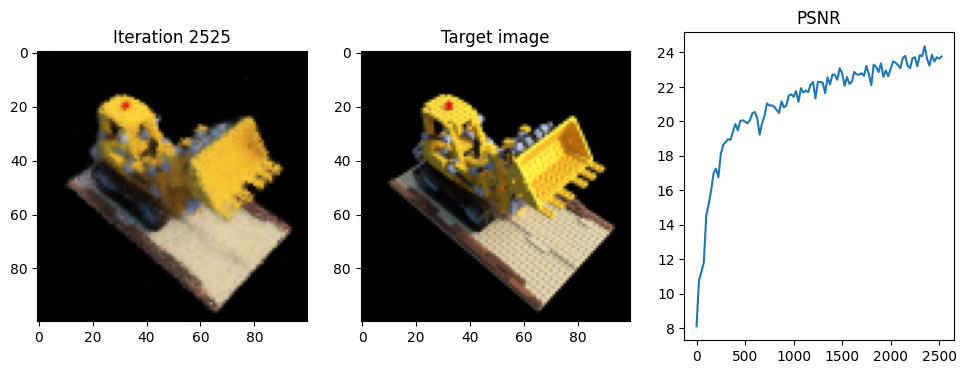

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.9881, -0.5263, -0.0759],
         [-0.9893, -0.5192, -0.0759],
         [-0.9905, -0.5121, -0.0759],
         ...,
         [-1.1008,  0.1629, -0.0759],
         [-1.1020,  0.1700, -0.0759],
         [-1.1031,  0.1771, -0.0759]],

        [[-0.9853, -0.5259, -0.0824],
         [-0.9864, -0.5188, -0.0824],
         [-0.9876, -0.5116, -0.0824],
         ...,
         [-1.0979,  0.1634, -0.0824],
         [-1.0991,  0.1705, -0.0824],
         [-1.1003,  0.1776, -0.0824]],

        [[-0.9824, -0.5254, -0.0890],
         [-0.9835, -0.5183, -0.0890],
         [-0.9847, -0.5112, -0.0890],
         ...,
         [-1.0951,  0.1639, -0.0890],
         [-1.0962,  0.1710, -0.0890],
         [-1.0974,  0.1781, -0.0890]],

        ...,

        [[-0.7090, -0.4807, -0.7144],
         [-0.7101, -0.4736, -0.7144],
         [-0.7113, -0.

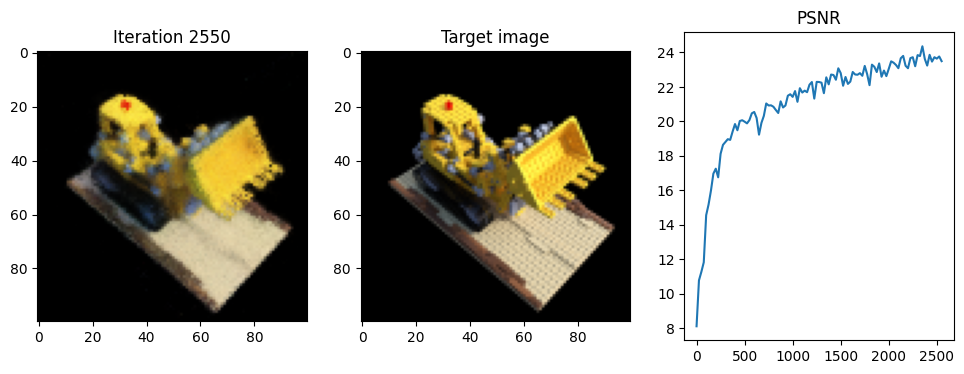

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0267, -0.4404,  0.1056],
         [ 1.0219, -0.4457,  0.1056],
         [ 1.0171, -0.4511,  0.1056],
         ...,
         [ 0.5593, -0.9593,  0.1056],
         [ 0.5544, -0.9646,  0.1056],
         [ 0.5496, -0.9700,  0.1056]],

        [[ 1.0254, -0.4392,  0.0986],
         [ 1.0206, -0.4446,  0.0986],
         [ 1.0158, -0.4499,  0.0986],
         ...,
         [ 0.5580, -0.9581,  0.0986],
         [ 0.5531, -0.9634,  0.0986],
         [ 0.5483, -0.9688,  0.0986]],

        [[ 1.0241, -0.4380,  0.0916],
         [ 1.0193, -0.4434,  0.0916],
         [ 1.0145, -0.4487,  0.0916],
         ...,
         [ 0.5567, -0.9569,  0.0916],
         [ 0.5518, -0.9623,  0.0916],
         [ 0.5470, -0.9676,  0.0916]],

        ...,

        [[ 0.9003, -0.3265, -0.5718],
         [ 0.8955, -0.3319, -0.5718],
         [ 0.8907, -0.

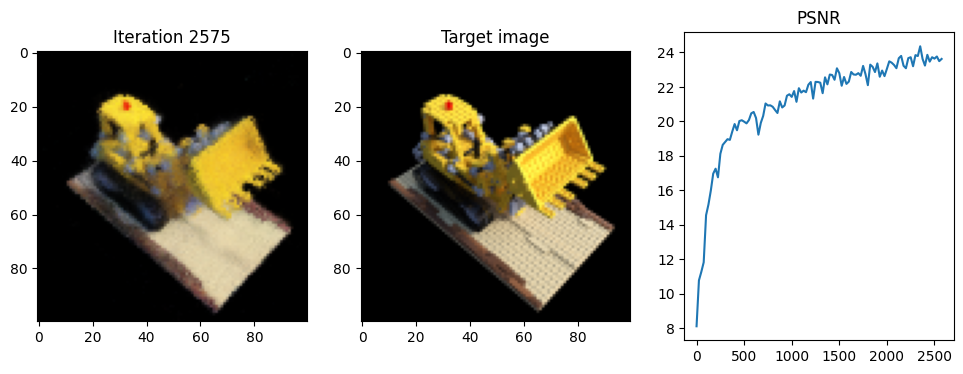

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.1119, -0.1413, -0.0541],
         [ 1.1087, -0.1477, -0.0541],
         [ 1.1056, -0.1542, -0.0541],
         ...,
         [ 0.8060, -0.7691, -0.0541],
         [ 0.8029, -0.7756, -0.0541],
         [ 0.7997, -0.7821, -0.0541]],

        [[ 1.1094, -0.1400, -0.0608],
         [ 1.1062, -0.1465, -0.0608],
         [ 1.1031, -0.1530, -0.0608],
         ...,
         [ 0.8035, -0.7679, -0.0608],
         [ 0.8004, -0.7744, -0.0608],
         [ 0.7972, -0.7808, -0.0608]],

        [[ 1.1069, -0.1388, -0.0674],
         [ 1.1037, -0.1453, -0.0674],
         [ 1.1006, -0.1518, -0.0674],
         ...,
         [ 0.8010, -0.7667, -0.0674],
         [ 0.7979, -0.7731, -0.0674],
         [ 0.7947, -0.7796, -0.0674]],

        ...,

        [[ 0.8694, -0.0231, -0.6984],
         [ 0.8663, -0.0296, -0.6984],
         [ 0.8631, -0.

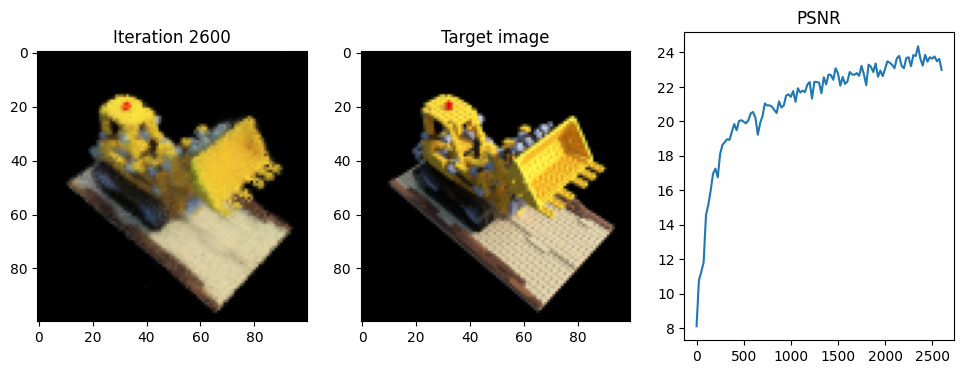

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1194, -1.1016,  0.1770],
         [ 0.1124, -1.1001,  0.1770],
         [ 0.1054, -1.0985,  0.1770],
         ...,
         [-0.5617, -0.9472,  0.1770],
         [-0.5687, -0.9457,  0.1770],
         [-0.5758, -0.9441,  0.1770]],

        [[ 0.1197, -1.1004,  0.1699],
         [ 0.1127, -1.0988,  0.1699],
         [ 0.1057, -1.0972,  0.1699],
         ...,
         [-0.5614, -0.9460,  0.1699],
         [-0.5684, -0.9444,  0.1699],
         [-0.5755, -0.9428,  0.1699]],

        [[ 0.1200, -1.0992,  0.1628],
         [ 0.1130, -1.0976,  0.1628],
         [ 0.1059, -1.0960,  0.1628],
         ...,
         [-0.5611, -0.9448,  0.1628],
         [-0.5682, -0.9432,  0.1628],
         [-0.5752, -0.9416,  0.1628]],

        ...,

        [[ 0.1468, -0.9809, -0.5104],
         [ 0.1398, -0.9793, -0.5104],
         [ 0.1327, -0.

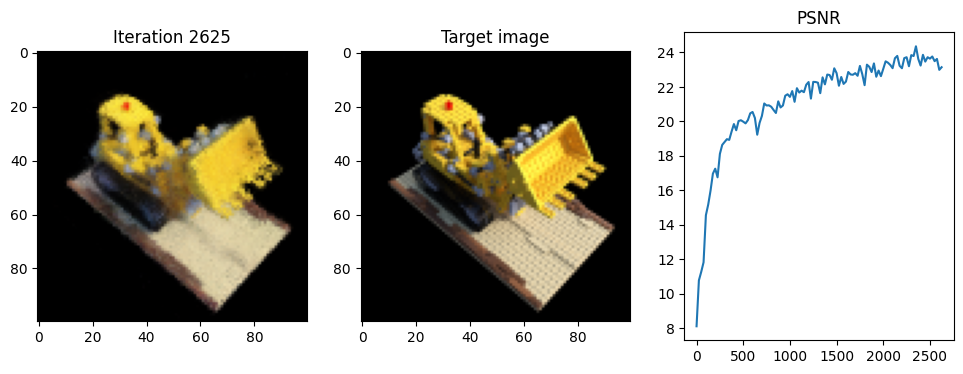

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1859,  0.9753, -0.5230],
         [ 0.1920,  0.9714, -0.5230],
         [ 0.1981,  0.9676, -0.5230],
         ...,
         [ 0.7778,  0.6046, -0.5230],
         [ 0.7839,  0.6008, -0.5230],
         [ 0.7900,  0.5970, -0.5230]],

        [[ 0.1830,  0.9706, -0.5277],
         [ 0.1891,  0.9668, -0.5277],
         [ 0.1952,  0.9630, -0.5277],
         ...,
         [ 0.7749,  0.6000, -0.5277],
         [ 0.7810,  0.5962, -0.5277],
         [ 0.7871,  0.5924, -0.5277]],

        [[ 0.1801,  0.9660, -0.5324],
         [ 0.1862,  0.9622, -0.5324],
         [ 0.1923,  0.9584, -0.5324],
         ...,
         [ 0.7720,  0.5954, -0.5324],
         [ 0.7781,  0.5916, -0.5324],
         [ 0.7842,  0.5878, -0.5324]],

        ...,

        [[-0.0950,  0.5266, -0.9786],
         [-0.0889,  0.5228, -0.9786],
         [-0.0828,  0.

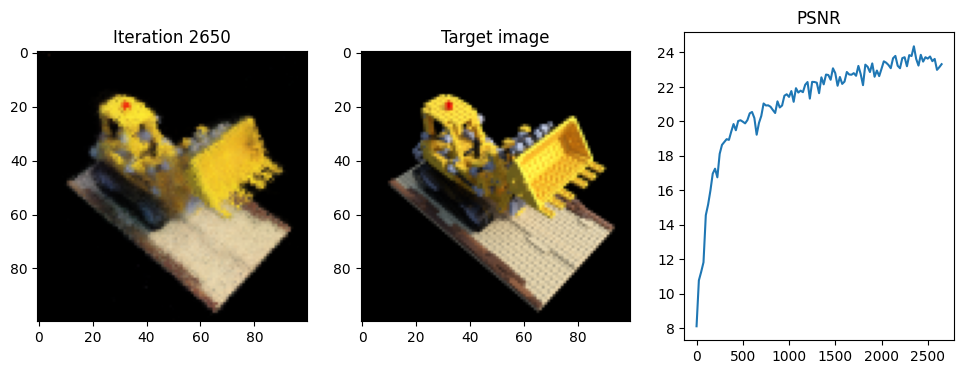

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.8679, -0.7064,  0.0829],
         [ 0.8618, -0.7102,  0.0829],
         [ 0.8557, -0.7140,  0.0829],
         ...,
         [ 0.2763, -1.0775,  0.0829],
         [ 0.2702, -1.0813,  0.0829],
         [ 0.2641, -1.0851,  0.0829]],

        [[ 0.8669, -0.7048,  0.0760],
         [ 0.8608, -0.7086,  0.0760],
         [ 0.8547, -0.7124,  0.0760],
         ...,
         [ 0.2753, -1.0758,  0.0760],
         [ 0.2692, -1.0797,  0.0760],
         [ 0.2631, -1.0835,  0.0760]],

        [[ 0.8659, -0.7032,  0.0691],
         [ 0.8598, -0.7070,  0.0691],
         [ 0.8537, -0.7108,  0.0691],
         ...,
         [ 0.2743, -1.0742,  0.0691],
         [ 0.2682, -1.0781,  0.0691],
         [ 0.2621, -1.0819,  0.0691]],

        ...,

        [[ 0.7699, -0.5500, -0.5906],
         [ 0.7638, -0.5539, -0.5906],
         [ 0.7577, -0.

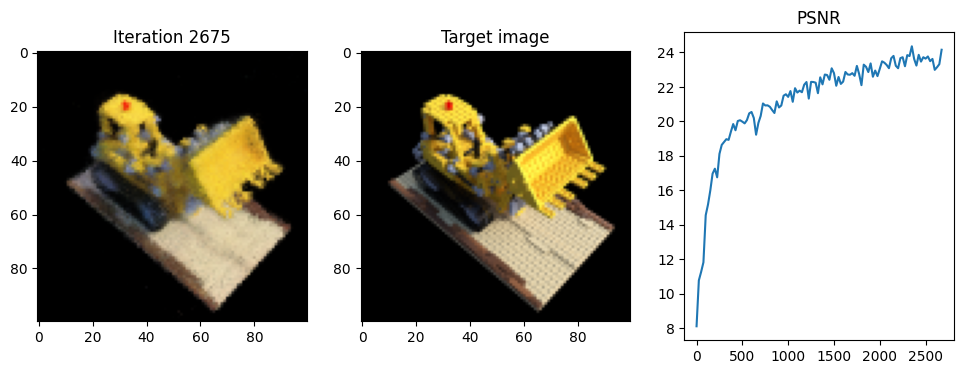

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3659, -1.0453, -0.1809],
         [ 0.3587, -1.0453, -0.1809],
         [ 0.3515, -1.0454, -0.1809],
         ...,
         [-0.3325, -1.0492, -0.1809],
         [-0.3397, -1.0493, -0.1809],
         [-0.3469, -1.0493, -0.1809]],

        [[ 0.3659, -1.0417, -0.1871],
         [ 0.3587, -1.0418, -0.1871],
         [ 0.3515, -1.0418, -0.1871],
         ...,
         [-0.3325, -1.0457, -0.1871],
         [-0.3397, -1.0457, -0.1871],
         [-0.3469, -1.0457, -0.1871]],

        [[ 0.3659, -1.0382, -0.1934],
         [ 0.3587, -1.0382, -0.1934],
         [ 0.3515, -1.0382, -0.1934],
         ...,
         [-0.3325, -1.0421, -0.1934],
         [-0.3397, -1.0422, -0.1934],
         [-0.3469, -1.0422, -0.1934]],

        ...,

        [[ 0.3640, -0.7003, -0.7881],
         [ 0.3568, -0.7004, -0.7881],
         [ 0.3496, -0.

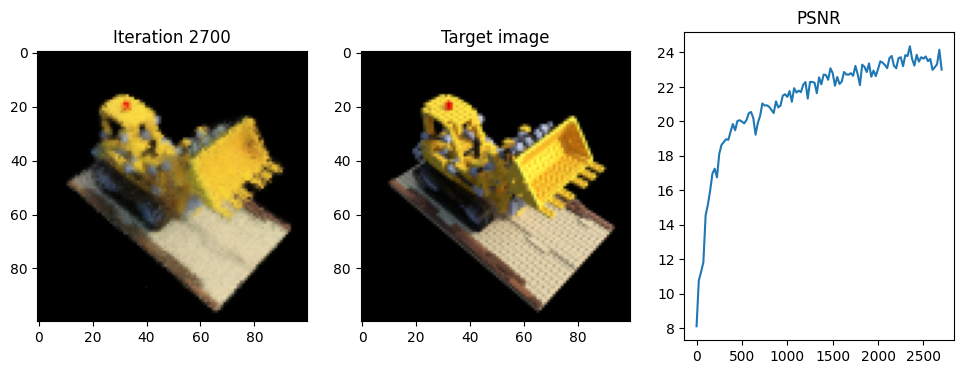

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.3682,  0.6250, -0.8561],
         [-0.3610,  0.6251, -0.8561],
         [-0.3538,  0.6252, -0.8561],
         ...,
         [ 0.3302,  0.6341, -0.8561],
         [ 0.3374,  0.6342, -0.8561],
         [ 0.3446,  0.6343, -0.8561]],

        [[-0.3681,  0.6181, -0.8582],
         [-0.3609,  0.6182, -0.8582],
         [-0.3537,  0.6183, -0.8582],
         ...,
         [ 0.3303,  0.6272, -0.8582],
         [ 0.3375,  0.6273, -0.8582],
         [ 0.3447,  0.6274, -0.8582]],

        [[-0.3680,  0.6112, -0.8602],
         [-0.3608,  0.6113, -0.8602],
         [-0.3536,  0.6114, -0.8602],
         ...,
         [ 0.3304,  0.6203, -0.8602],
         [ 0.3376,  0.6204, -0.8602],
         [ 0.3448,  0.6205, -0.8602]],

        ...,

        [[-0.3595, -0.0444, -1.0550],
         [-0.3523, -0.0443, -1.0550],
         [-0.3451, -0.

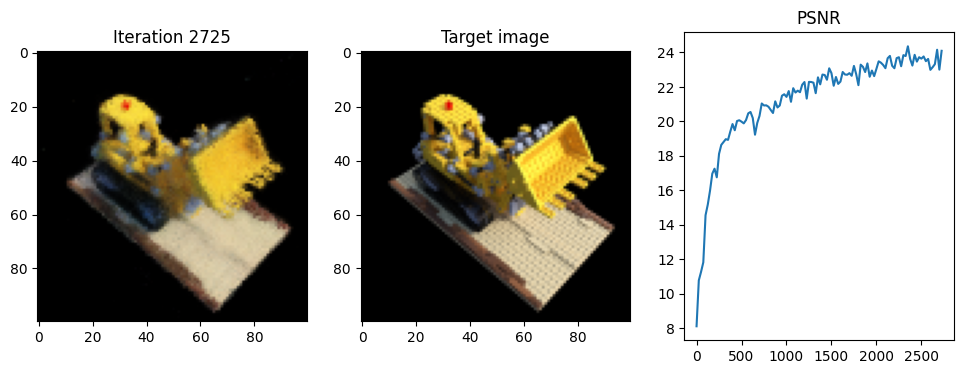

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.4690, -1.0075,  0.1555],
         [ 0.4618, -1.0083,  0.1555],
         [ 0.4546, -1.0090,  0.1555],
         ...,
         [-0.2255, -1.0812,  0.1555],
         [-0.2327, -1.0820,  0.1555],
         [-0.2399, -1.0828,  0.1555]],

        [[ 0.4688, -1.0061,  0.1485],
         [ 0.4617, -1.0069,  0.1485],
         [ 0.4545, -1.0076,  0.1485],
         ...,
         [-0.2257, -1.0798,  0.1485],
         [-0.2328, -1.0806,  0.1485],
         [-0.2400, -1.0813,  0.1485]],

        [[ 0.4687, -1.0047,  0.1414],
         [ 0.4615, -1.0054,  0.1414],
         [ 0.4543, -1.0062,  0.1414],
         ...,
         [-0.2258, -1.0784,  0.1414],
         [-0.2330, -1.0792,  0.1414],
         [-0.2402, -1.0799,  0.1414]],

        ...,

        [[ 0.4544, -0.8704, -0.5291],
         [ 0.4473, -0.8712, -0.5291],
         [ 0.4401, -0.

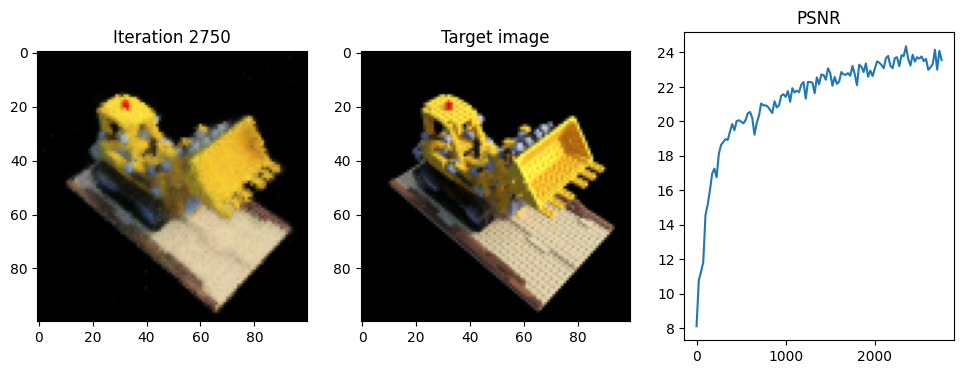

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.6503, -0.0133, -0.9144],
         [ 0.6462, -0.0192, -0.9144],
         [ 0.6421, -0.0251, -0.9144],
         ...,
         [ 0.2519, -0.5869, -0.9144],
         [ 0.2478, -0.5928, -0.9144],
         [ 0.2437, -0.5988, -0.9144]],

        [[ 0.6445, -0.0092, -0.9158],
         [ 0.6404, -0.0151, -0.9158],
         [ 0.6363, -0.0211, -0.9158],
         ...,
         [ 0.2461, -0.5829, -0.9158],
         [ 0.2420, -0.5888, -0.9158],
         [ 0.2379, -0.5947, -0.9158]],

        [[ 0.6387, -0.0052, -0.9171],
         [ 0.6346, -0.0111, -0.9171],
         [ 0.6304, -0.0170, -0.9171],
         ...,
         [ 0.2403, -0.5789, -0.9171],
         [ 0.2362, -0.5848, -0.9171],
         [ 0.2321, -0.5907, -0.9171]],

        ...,

        [[ 0.0869,  0.3780, -1.0458],
         [ 0.0828,  0.3721, -1.0458],
         [ 0.0787,  0.

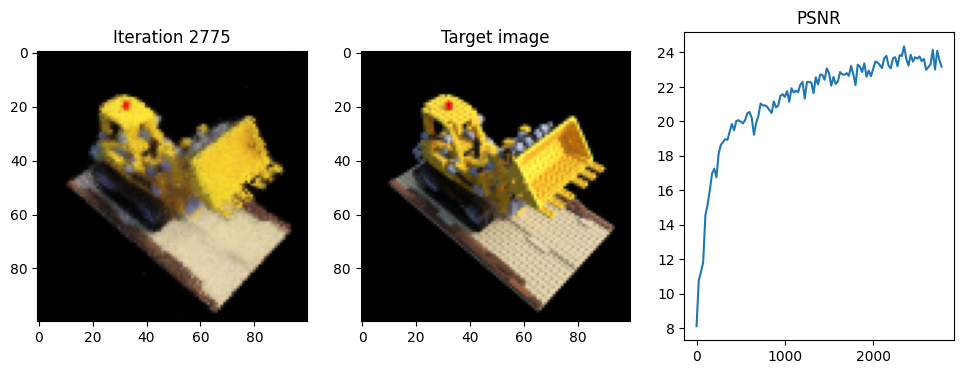

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[-0.3682,  0.6250, -0.8561],
         [-0.3610,  0.6251, -0.8561],
         [-0.3538,  0.6252, -0.8561],
         ...,
         [ 0.3302,  0.6341, -0.8561],
         [ 0.3374,  0.6342, -0.8561],
         [ 0.3446,  0.6343, -0.8561]],

        [[-0.3681,  0.6181, -0.8582],
         [-0.3609,  0.6182, -0.8582],
         [-0.3537,  0.6183, -0.8582],
         ...,
         [ 0.3303,  0.6272, -0.8582],
         [ 0.3375,  0.6273, -0.8582],
         [ 0.3447,  0.6274, -0.8582]],

        [[-0.3680,  0.6112, -0.8602],
         [-0.3608,  0.6113, -0.8602],
         [-0.3536,  0.6114, -0.8602],
         ...,
         [ 0.3304,  0.6203, -0.8602],
         [ 0.3376,  0.6204, -0.8602],
         [ 0.3448,  0.6205, -0.8602]],

        ...,

        [[-0.3595, -0.0444, -1.0550],
         [-0.3523, -0.0443, -1.0550],
         [-0.3451, -0.

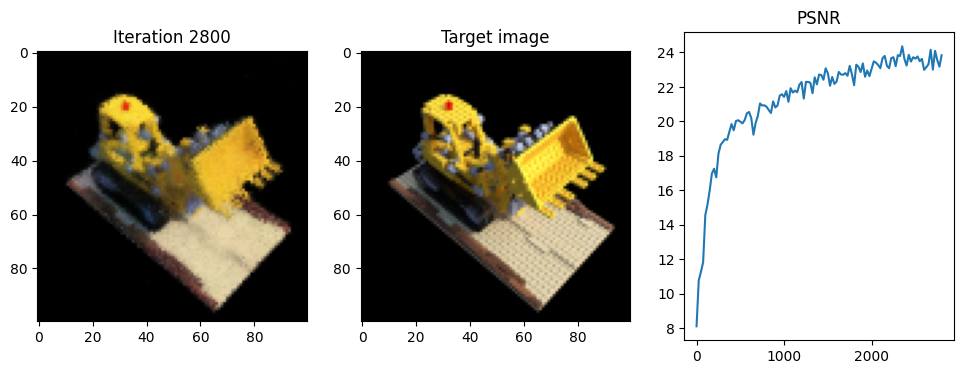

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.9915,  0.5254,  0.0044],
         [ 0.9927,  0.5183,  0.0044],
         [ 0.9938,  0.5112,  0.0044],
         ...,
         [ 1.1033, -0.1640,  0.0044],
         [ 1.1044, -0.1711,  0.0044],
         [ 1.1056, -0.1782,  0.0044]],

        [[ 0.9892,  0.5250, -0.0023],
         [ 0.9903,  0.5179, -0.0023],
         [ 0.9915,  0.5108, -0.0023],
         ...,
         [ 1.1009, -0.1644, -0.0023],
         [ 1.1020, -0.1715, -0.0023],
         [ 1.1032, -0.1786, -0.0023]],

        [[ 0.9868,  0.5246, -0.0091],
         [ 0.9879,  0.5175, -0.0091],
         [ 0.9891,  0.5104, -0.0091],
         ...,
         [ 1.0985, -0.1648, -0.0091],
         [ 1.0997, -0.1719, -0.0091],
         [ 1.1008, -0.1790, -0.0091]],

        ...,

        [[ 0.7607,  0.4880, -0.6537],
         [ 0.7619,  0.4809, -0.6537],
         [ 0.7630,  0.

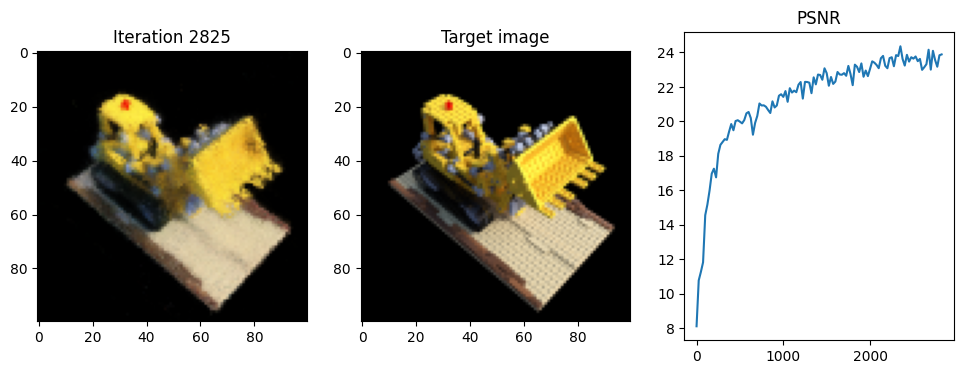

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1524,  1.1032, -0.1377],
         [ 0.1588,  1.0999, -0.1377],
         [ 0.1652,  1.0967, -0.1377],
         ...,
         [ 0.7762,  0.7891, -0.1377],
         [ 0.7826,  0.7859, -0.1377],
         [ 0.7890,  0.7826, -0.1377]],

        [[ 0.1509,  1.1002, -0.1441],
         [ 0.1573,  1.0970, -0.1441],
         [ 0.1638,  1.0938, -0.1441],
         ...,
         [ 0.7747,  0.7862, -0.1441],
         [ 0.7811,  0.7829, -0.1441],
         [ 0.7876,  0.7797, -0.1441]],

        [[ 0.1494,  1.0973, -0.1505],
         [ 0.1558,  1.0941, -0.1505],
         [ 0.1623,  1.0908, -0.1505],
         ...,
         [ 0.7732,  0.7832, -0.1505],
         [ 0.7796,  0.7800, -0.1505],
         [ 0.7861,  0.7768, -0.1505]],

        ...,

        [[ 0.0086,  0.8176, -0.7586],
         [ 0.0150,  0.8144, -0.7586],
         [ 0.0215,  0.

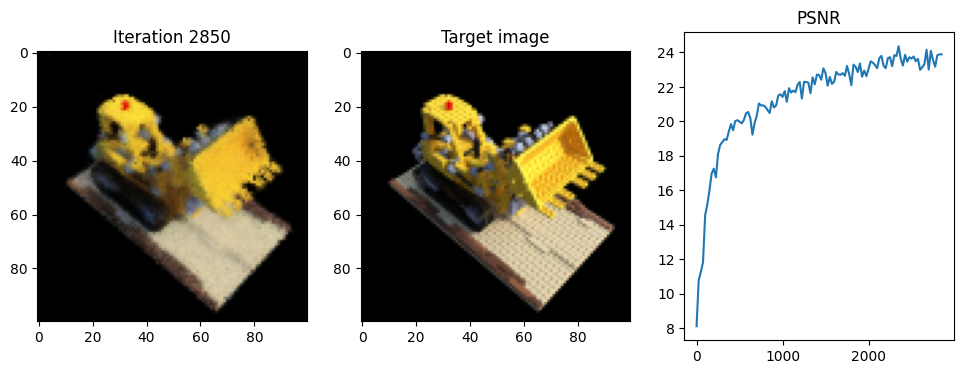

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.3748, -1.0568,  0.0438],
         [ 0.3676, -1.0569,  0.0438],
         [ 0.3604, -1.0570,  0.0438],
         ...,
         [-0.3235, -1.0666,  0.0438],
         [-0.3307, -1.0667,  0.0438],
         [-0.3379, -1.0668,  0.0438]],

        [[ 0.3748, -1.0546,  0.0369],
         [ 0.3676, -1.0547,  0.0369],
         [ 0.3604, -1.0548,  0.0369],
         ...,
         [-0.3235, -1.0644,  0.0369],
         [-0.3307, -1.0645,  0.0369],
         [-0.3379, -1.0646,  0.0369]],

        [[ 0.3748, -1.0525,  0.0300],
         [ 0.3676, -1.0526,  0.0300],
         [ 0.3604, -1.0527,  0.0300],
         ...,
         [-0.3236, -1.0622,  0.0300],
         [-0.3308, -1.0623,  0.0300],
         [-0.3380, -1.0624,  0.0300]],

        ...,

        [[ 0.3719, -0.8475, -0.6225],
         [ 0.3647, -0.8476, -0.6225],
         [ 0.3575, -0.

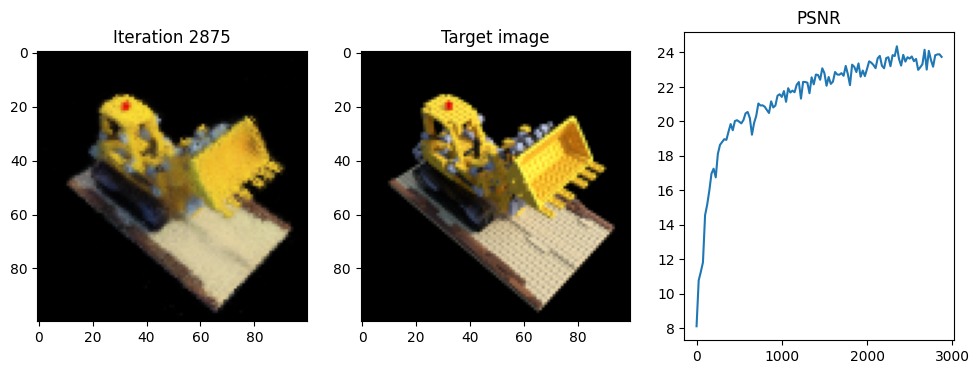

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0535,  0.3601,  0.1403],
         [ 1.0535,  0.3529,  0.1403],
         [ 1.0535,  0.3457,  0.1403],
         ...,
         [ 1.0536, -0.3383,  0.1403],
         [ 1.0536, -0.3455,  0.1403],
         [ 1.0536, -0.3527,  0.1403]],

        [[ 1.0520,  0.3601,  0.1332],
         [ 1.0520,  0.3529,  0.1332],
         [ 1.0520,  0.3457,  0.1332],
         ...,
         [ 1.0520, -0.3383,  0.1332],
         [ 1.0520, -0.3455,  0.1332],
         [ 1.0520, -0.3527,  0.1332]],

        [[ 1.0505,  0.3601,  0.1262],
         [ 1.0505,  0.3529,  0.1262],
         [ 1.0505,  0.3457,  0.1262],
         ...,
         [ 1.0505, -0.3383,  0.1262],
         [ 1.0505, -0.3455,  0.1262],
         [ 1.0505, -0.3527,  0.1262]],

        ...,

        [[ 0.9057,  0.3601, -0.5423],
         [ 0.9057,  0.3529, -0.5423],
         [ 0.9057,  0.

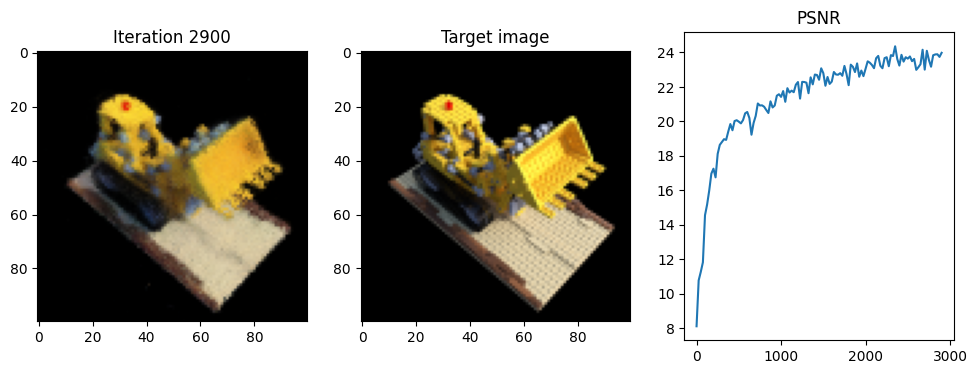

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.1159, -0.0915, -0.0743],
         [ 1.1131, -0.0981, -0.0743],
         [ 1.1102, -0.1047, -0.0743],
         ...,
         [ 0.8381, -0.7322, -0.0743],
         [ 0.8353, -0.7388, -0.0743],
         [ 0.8324, -0.7454, -0.0743]],

        [[ 1.1133, -0.0903, -0.0809],
         [ 1.1104, -0.0969, -0.0809],
         [ 1.1075, -0.1035, -0.0809],
         ...,
         [ 0.8355, -0.7311, -0.0809],
         [ 0.8326, -0.7377, -0.0809],
         [ 0.8297, -0.7443, -0.0809]],

        [[ 1.1106, -0.0891, -0.0875],
         [ 1.1077, -0.0957, -0.0875],
         [ 1.1049, -0.1024, -0.0875],
         ...,
         [ 0.8328, -0.7299, -0.0875],
         [ 0.8299, -0.7365, -0.0875],
         [ 0.8271, -0.7431, -0.0875]],

        ...,

        [[ 0.8573,  0.0207, -0.7133],
         [ 0.8544,  0.0141, -0.7133],
         [ 0.8515,  0.

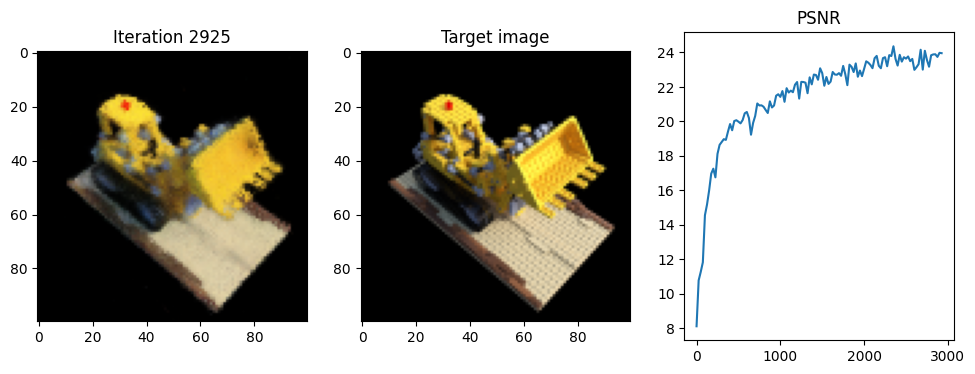

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 1.0867,  0.2079,  0.1874],
         [ 1.0856,  0.2008,  0.1874],
         [ 1.0846,  0.1937,  0.1874],
         ...,
         [ 0.9876, -0.4834,  0.1874],
         [ 0.9866, -0.4905,  0.1874],
         [ 0.9855, -0.4976,  0.1874]],

        [[ 1.0855,  0.2081,  0.1803],
         [ 1.0845,  0.2010,  0.1803],
         [ 1.0834,  0.1939,  0.1803],
         ...,
         [ 0.9864, -0.4832,  0.1803],
         [ 0.9854, -0.4903,  0.1803],
         [ 0.9844, -0.4975,  0.1803]],

        [[ 1.0843,  0.2083,  0.1732],
         [ 1.0833,  0.2012,  0.1732],
         [ 1.0822,  0.1940,  0.1732],
         ...,
         [ 0.9852, -0.4830,  0.1732],
         [ 0.9842, -0.4902,  0.1732],
         [ 0.9832, -0.4973,  0.1732]],

        ...,

        [[ 0.9708,  0.2245, -0.5012],
         [ 0.9698,  0.2174, -0.5012],
         [ 0.9688,  0.

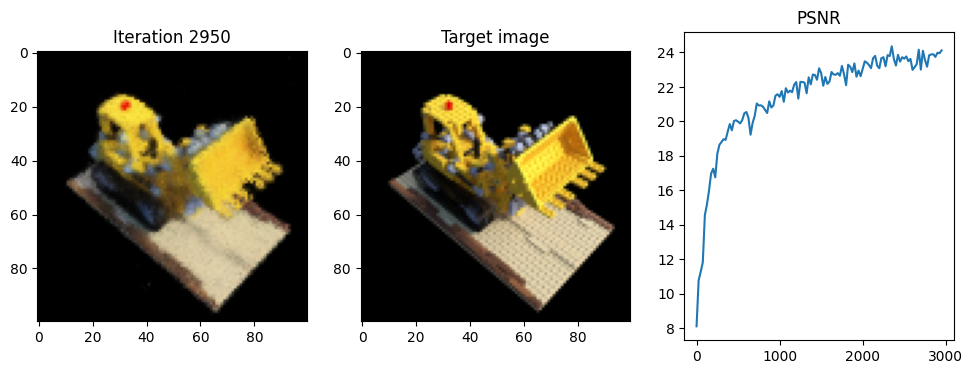

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.1194, -1.1016,  0.1770],
         [ 0.1124, -1.1001,  0.1770],
         [ 0.1054, -1.0985,  0.1770],
         ...,
         [-0.5617, -0.9472,  0.1770],
         [-0.5687, -0.9457,  0.1770],
         [-0.5758, -0.9441,  0.1770]],

        [[ 0.1197, -1.1004,  0.1699],
         [ 0.1127, -1.0988,  0.1699],
         [ 0.1057, -1.0972,  0.1699],
         ...,
         [-0.5614, -0.9460,  0.1699],
         [-0.5684, -0.9444,  0.1699],
         [-0.5755, -0.9428,  0.1699]],

        [[ 0.1200, -1.0992,  0.1628],
         [ 0.1130, -1.0976,  0.1628],
         [ 0.1059, -1.0960,  0.1628],
         ...,
         [-0.5611, -0.9448,  0.1628],
         [-0.5682, -0.9432,  0.1628],
         [-0.5752, -0.9416,  0.1628]],

        ...,

        [[ 0.1468, -0.9809, -0.5104],
         [ 0.1398, -0.9793, -0.5104],
         [ 0.1327, -0.

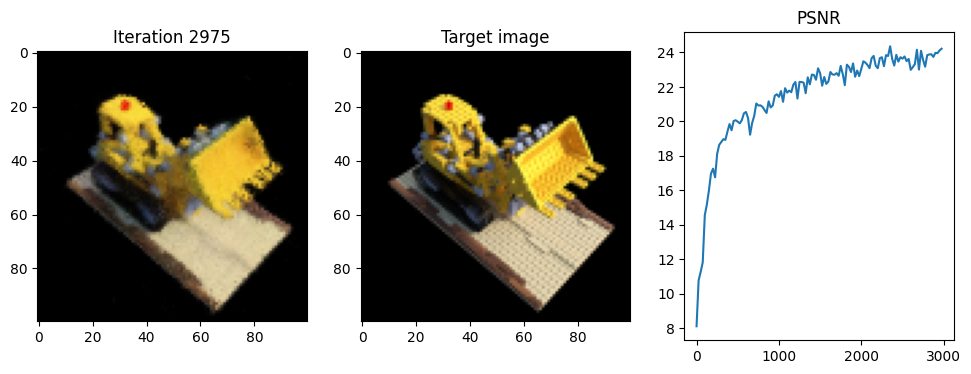

tensor([[ 0.,  1.,  2.,  ..., 97., 98., 99.],
        [ 0.,  0.,  0.,  ..., 99., 99., 99.],
        [ 1.,  1.,  1.,  ...,  1.,  1.,  1.]], device='cuda:0')
tensor([[[ 0.8773, -0.3746, -0.5910],
         [ 0.8722, -0.3797, -0.5910],
         [ 0.8670, -0.3847, -0.5910],
         ...,
         [ 0.3809, -0.8659, -0.5910],
         [ 0.3758, -0.8710, -0.5910],
         [ 0.3706, -0.8760, -0.5910]],

        [[ 0.8732, -0.3705, -0.5953],
         [ 0.8681, -0.3756, -0.5953],
         [ 0.8630, -0.3806, -0.5953],
         ...,
         [ 0.3768, -0.8618, -0.5953],
         [ 0.3717, -0.8669, -0.5953],
         [ 0.3666, -0.8719, -0.5953]],

        [[ 0.8691, -0.3664, -0.5995],
         [ 0.8640, -0.3714, -0.5995],
         [ 0.8589, -0.3765, -0.5995],
         ...,
         [ 0.3727, -0.8577, -0.5995],
         [ 0.3676, -0.8627, -0.5995],
         [ 0.3625, -0.8678, -0.5995]],

        ...,

        [[ 0.4819,  0.0248, -1.0056],
         [ 0.4768,  0.0198, -1.0056],
         [ 0.4717,  0.

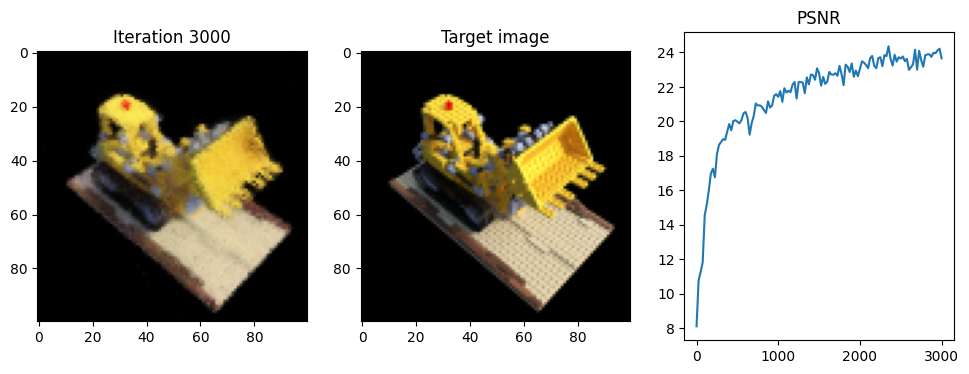

Done!


In [58]:
for i in range(iterations+1):

    #############################  TODO 2.6 BEGIN  ############################
     
    #choose randomly a picture for the forward pass
    idx = np.random.randint(images.shape[0])
    #idx = 1
    random_image = images[idx]


    # Run one iteration of NeRF and get the rendered RGB image.
    rendered_img = one_forward_pass(height, width, intrinsics, poses[idx], near, far, samples, model, num_x_frequencies, num_d_frequencies)


    # Compute mean-squared error between the predicted and target images. Backprop!
    model_loss = torch.nn.MSELoss()(random_image, rendered_img)
    model_loss.backward()
    optimizer.step()
    optimizer.zero_grad()
   


    #############################  TODO 2.6 END  ############################

    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
        #############################  TODO 2.6 BEGIN  ############################
            # Render the held-out view    
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)


            #calculate the loss and the psnr between the original test image and the reconstructed one. 
            loss = torch.nn.MSELoss()(test_image, test_rec_image) 
            #psnr = 10*(torch.log10((torch.max(test_image))**2/loss.item()))
            psnr = 20 * torch.log10(1.0 / torch.sqrt(loss))


        #############################  TODO 2.6 END  ############################

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))
        
        t = time.time()    
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

print('Done!') 